# Chargement des données d'entrainement et librairies

In [2]:
# ======================
# Manipulation des données
# ======================
import pandas as pd
import numpy as np
import ast
import os
import time
from collections import Counter

# ======================
# Visualisation
# ======================
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

# ======================
# Suivi de progression
# ======================
from tqdm import tqdm
from tqdm.notebook import tqdm as tqdm_notebook  # Pour Jupyter Notebook
tqdm.pandas()  # Activation de tqdm pour Pandas

# ======================
# Traitement du texte
# ======================
import re
import string
import html
import unicodedata
from bs4 import BeautifulSoup  # Nettoyage HTML
from unidecode import unidecode

# ======================
# NLP - Traitement du langage naturel
# ======================
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import spacy

# Téléchargement des ressources NLTK 
nltk.download('stopwords')
nltk.download('punkt')

# ======================
# Traduction et détection de langue
# ======================
from langdetect import detect
from google.cloud import translate_v2 as translate

# ======================
# Accélération des traitements (parallélisation)
# ======================
import multiprocessing
from joblib import Parallel, delayed
from concurrent.futures import ThreadPoolExecutor, as_completed

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\rudy_\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\rudy_\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [5]:
# Chargement des fichiers avec l'index
X_train = pd.read_csv("./Split dfs/X_train.csv", index_col=0)
y_train = pd.read_csv("./Split dfs/y_train.csv", index_col=0)

X_test = pd.read_csv("./Split dfs/X_test.csv", index_col=0)
y_test = pd.read_csv("./Split dfs/y_test.csv", index_col=0)

X_val = pd.read_csv("./Split dfs/X_val.csv", index_col=0)
y_val = pd.read_csv("./Split dfs/y_val.csv", index_col=0)

# Forcer le tri des index avant la fusion
X_train = X_train.sort_index()
y_train = y_train.sort_index()

X_test = X_test.sort_index()
y_test = y_test.sort_index()

X_val = X_val.sort_index()
y_val = y_val.sort_index()

# Fusionner sur l'index après tri
Train = X_train.merge(y_train, left_index=True, right_index=True, how="inner").sort_index()
Test = X_test.merge(y_test, left_index=True, right_index=True, how="inner").sort_index()
Val = X_val.merge(y_val, left_index=True, right_index=True, how="inner").sort_index()

# Affichage des premiers résultats
display(Train.head(), Test.head(), Val.head())


# Enregistrement des fichiers fusionnés
save_dir = "./Preprocessing/dfs/"
os.makedirs(save_dir, exist_ok=True)

Train.to_csv(os.path.join(save_dir, "Train.csv"), index=False)
Test.to_csv(os.path.join(save_dir, "Test.csv"), index=False)
Val.to_csv(os.path.join(save_dir, "Val.csv"), index=False)


print(" Fusion terminée, index triés et fichiers enregistrés avec succès !")


,designation,description,productid,imageid,prdtypecode
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496,1280
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786,2705


,designation,description,productid,imageid,prdtypecode
5,Afrique Contemporaine N° 212 Hiver 2004 - Doss...,NaN,5862738,393356830,2280
16,Walter Scott Oeuvres Complètes Tomes 3456 10 E...,NaN,3735707499,1239242410,2403
23,Véhicule Star Wars A-Ast5,véhicule vintage de la saga star wars le A-AST5,279822475,978593209,1140
33,Lindner 2365-2115ce Coin Case Nera Xl With 3 T...,Timeless elegance a clear design versatility f...,3817904723,1248853903,2522
45,Rideau A Oeillets Plastique Polyester Uni Esse...,rêt-à-poser ce rideau s'installe facilement et...,2333136838,1136619798,1920


,designation,description,productid,imageid,prdtypecode
10,Eames Inspired Sxw Chair - Pink - Black,The timeless DSW seat can now be paired with m...,1915836983,1111840281,1560
11,Fauteuil Chesterfield Brenton 100% Cuir De Buf...,Canapé et fauteuil chesterfield en cuir antiqu...,4127967621,1295816984,1560
19,Monde Illustre (Le) N° 3083 Du 20/01/1917 - L'...,NaN,570628142,1027257229,2280
30,Lampe De Lecture Rechargeable Led Lampe De Bea...,Nom de la marque:SYTH<br />Ampoules incluses:O...,4198487181,1313675704,2060
48,Dragon Ball Z - Serie 3 - 13 - Francaise,NaN,73334276,844838682,1160


 Fusion terminée, index triés et fichiers enregistrés avec succès !


# Concatenation de designation et description

In [8]:
# Fonction pour concaténer 'designation' et 'description'
def concatenate_column(file_path, output_file, col1="designation", col2="description", output_col="txt"):
    """
    Charge un fichier CSV, concatène deux colonnes textuelles et enregistre le fichier mis à jour.

    :file_path: Nom du fichier d'entrée
    :output_file: Nom du fichier de sortie
    :col1: Première colonne à concaténer 
    :col2: Deuxième colonne à concaténer 
    :output_col: Nom de la nouvelle colonne résultante 
    """
    print(f"\n Chargement du fichier : {file_path} ...")
    df = pd.read_csv(file_path)
            
    print(f" Concaténation en cours pour '{col1}' + '{col2}' > '{output_col}'")
    df[output_col] = df[col1].fillna("").astype(str) + " " + df[col2].fillna("")

    # Sauvegarde du fichier mis à jour
    df.to_csv(output_file, index=False)
    print(f" Fichier mis à jour enregistré : {output_file}")

    return df

# Application sur X_train, X_test et X_val
X_train = concatenate_column("./Preprocessing/dfs/Train.csv", "./Preprocessing/dfs/X_train_concat.csv")
X_test = concatenate_column("./Preprocessing/dfs/Test.csv", "./Preprocessing/dfs/X_test_concat.csv")
X_val = concatenate_column("./Preprocessing/dfs/Val.csv", "./Preprocessing/dfs/X_val_concat.csv")

print("\n Concaténation terminée pour tous les fichiers ! ")


 Chargement du fichier : ./Preprocessing/dfs/Train.csv ...
 Concaténation en cours pour 'designation' + 'description' > 'txt'
 Fichier mis à jour enregistré : ./Preprocessing/dfs/X_train_concat.csv

 Chargement du fichier : ./Preprocessing/dfs/Test.csv ...
 Concaténation en cours pour 'designation' + 'description' > 'txt'
 Fichier mis à jour enregistré : ./Preprocessing/dfs/X_test_concat.csv

 Chargement du fichier : ./Preprocessing/dfs/Val.csv ...
 Concaténation en cours pour 'designation' + 'description' > 'txt'
 Fichier mis à jour enregistré : ./Preprocessing/dfs/X_val_concat.csv

 Concaténation terminée pour tous les fichiers ! 


In [10]:
# Vérification des valeurs manquantes et des doublons dans la colonne 'text'
missing_values = X_train['txt'].isnull().sum()
duplicate_values = X_train['txt'].duplicated().sum()

# Affichage des résultats
print(f"Nombre de valeurs manquantes dans 'text' : {missing_values}")
print(f"Nombre de doublons dans 'text' : {duplicate_values}")

# Affichage des doublons (optionnel)
duplicates = X_train[X_train['txt'].duplicated(keep=False)].sort_values(by='txt')
print("\nExemples de doublons :")
display(duplicates.head(10))

Nombre de valeurs manquantes dans 'text' : 0
Nombre de doublons dans 'text' : 935

Exemples de doublons :


,designation,description,productid,imageid,prdtypecode,txt
8983,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580649,1248217842,50,1 Paire Joy-Con Gamepad Poignée De Verrouillag...
40007,1 Paire Joy-Con Gamepad Poignée De Verrouillag...,1 paire Joy-Con Gamepad poignée de verrouillag...,3814580751,1248217908,50,1 Paire Joy-Con Gamepad Poignée De Verrouillag...
35022,1 paire de coton Cartoon Fluffy courts Yeux Ch...,1 paire de coton Cartoon Fluffy courts Yeux Ch...,3898723829,1261415030,1301,1 paire de coton Cartoon Fluffy courts Yeux Ch...
17167,1 paire de coton Cartoon Fluffy courts Yeux Ch...,1 paire de coton Cartoon Fluffy courts Yeux Ch...,3898723811,1261415005,1301,1 paire de coton Cartoon Fluffy courts Yeux Ch...
26150,1 paire de coton Cartoon longs yeux Chaussette...,1 paires coton Cartoon longs yeux Chaussettes ...,3898723734,1261414614,1301,1 paire de coton Cartoon longs yeux Chaussette...
17950,1 paire de coton Cartoon longs yeux Chaussette...,1 paires coton Cartoon longs yeux Chaussettes ...,3898723733,1261414607,1301,1 paire de coton Cartoon longs yeux Chaussette...
18202,1 paires coton doux Chaussettes solides pour B...,1 paires coton doux Chaussettes solides pour l...,3898720354,1261400063,1301,1 paires coton doux Chaussettes solides pour B...
24846,1 paires coton doux Chaussettes solides pour B...,1 paires coton doux Chaussettes solides pour l...,3898720146,1261399976,1301,1 paires coton doux Chaussettes solides pour B...
63731,100% Nouveau 2019 Marine Life 50x50cm Linge De...,100% NOUVEAU 2019 Marine Life 50x50cm Linge de...,4076974719,1286953423,1920,100% Nouveau 2019 Marine Life 50x50cm Linge De...
13417,100% Nouveau 2019 Marine Life 50x50cm Linge De...,100% NOUVEAU 2019 Marine Life 50x50cm Linge de...,4076593495,1287365618,1920,100% Nouveau 2019 Marine Life 50x50cm Linge De...


C:\Users\rudy_\AppData\Local\Temp\ipykernel_40836\126942543.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x="Type de données", y="Pourcentage de doublons", data=data, palette="muted")


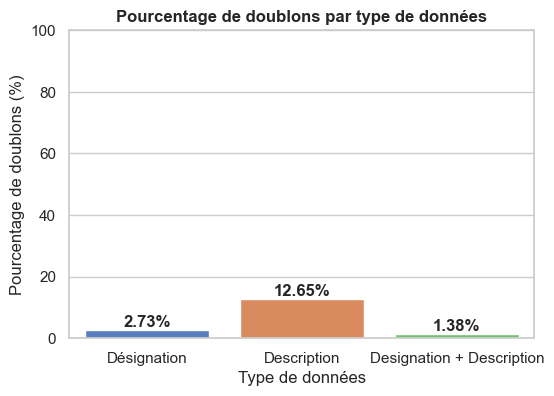

Pourcentage de doublons dans 'designation' : 2.73%
Pourcentage de doublons dans 'description' : 12.65%
Pourcentage de doublons dans 'designation + description' : 1.38%


In [11]:
# Calcul des pourcentages de doublons à partir des données réelles
duplicate_designation_percent = X_train.duplicated(subset=["designation"]).mean() * 100
duplicate_description_percent = X_train[~X_train["description"].isna()].duplicated(subset=["description"]).mean() * 100
duplicate_text_percent = X_train.duplicated(subset=["txt"]).mean() * 100

# Création d'un DataFrame pour faciliter la visualisation
data = pd.DataFrame({
    "Type de données": ["Désignation", "Description", "Designation + Description"],
    "Pourcentage de doublons": [duplicate_designation_percent, duplicate_description_percent, duplicate_text_percent]
})

# Configuration du style
sns.set(style="whitegrid")

# Création du graphique
plt.figure(figsize=(6, 4))
ax = sns.barplot(x="Type de données", y="Pourcentage de doublons", data=data, palette="muted")

# Ajout des annotations sur chaque barre
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2, p.get_height()), 
                ha='center', va='bottom', fontsize=12, weight='bold')

# Titre et étiquettes
plt.title("Pourcentage de doublons par type de données", fontsize=12, weight='bold')
plt.xlabel("Type de données", fontsize=12)
plt.ylabel("Pourcentage de doublons (%)", fontsize=12)
plt.ylim(0, 100)

plt.show()

print(f"Pourcentage de doublons dans 'designation' : {duplicate_designation_percent:.2f}%")
print(f"Pourcentage de doublons dans 'description' : {duplicate_description_percent:.2f}%")
print(f"Pourcentage de doublons dans 'designation + description' : {duplicate_text_percent:.2f}%")

La concaténation a efficacement permis d'éliminer les valeurs manquantes. Elle a également contribué à réduire significativement le nombre de doublons : le taux est passé de 2,73 % pour la colonne "désignation" seule et de 12,65 % pour la colonne "description" seule à seulement 1,38 % dans la colonne concaténée.

Après la concaténation de la désignation et de la description, nous avons le même nombre de doublons problématique, chacun étant lié à un maximum de deux catégories distinctes. Pour résoudre cette ambiguïté, il serait pertinent d'enrichir ces données textuelles en y intégrant les identifiants des produits (productid) ou des images (imageid). Les 2 doublons supplementaires correspondent à "Le Livre De La Jungle" et à "Console Master System 2", qui sont deux colonnes contenant contenant des valeurs manquantes dans la colonne description. 

**Les preprocessing suivants genereront potentiellement des doublons textuelles, nous nous occuperons donc de l'ensemble de ces doublons plus tard**

# Nettoyage balises, accents, miniscules

In [14]:
# Fonction de nettoyage HTML, accents, minuscule et caractères spéciaux
def clean_accent_min_balise_entity(text):
    """Nettoie le texte en supprimant les balises HTML, entités, accents et caractères spéciaux."""
    if not isinstance(text, str) or text.strip() == "":
        return ""

    text = BeautifulSoup(text, "html.parser").get_text()  # Supprimer les balises HTML
    text = html.unescape(text)  # Convertir les entités HTML (&amp;, &eacute;)
    text = unidecode(text.lower())  # Convertir en minuscules et supprimer les accents
    text = re.sub(r'[^a-z0-9\s]', ' ', text)  # Supprimer les caractères spéciaux
    text = re.sub(r'\s+', ' ', text).strip()  # Supprimer les espaces multiples

    return text

def clean_BERT_mBERT(text):
    """Nettoie le texte en supprimant les balises HTML, entités, accents et caractères spéciaux."""
    if not isinstance(text, str) or text.strip() == "":
        return ""

    text = BeautifulSoup(text, "html.parser").get_text()  # Supprimer les balises HTML
    text = html.unescape(text)  # Convertir les entités HTML (&amp;, &eacute;)
    text = re.sub(r"[^a-zA-Z0-9\sàâäéèêëîïôöùûüçÀÂÄÉÈÊËÎÏÔÖÙÛÜÇ]", " ", text)  # Supprimer les caractères spéciaux
    text = re.sub(r'\s+', ' ', text).strip()  # Supprimer les espaces multiples
    return text


# Fonction pour nettoyer un DataFrame en parallèle
def clean_dataframe(file_path, output_file, input_col="txt", output_col="txt_0", cleaning_function=clean_accent_min_balise_entity):
    """
    Charge, nettoie et enregistre un fichier CSV en supprimant HTML, accents et caractères spéciaux.

    :file_path: Fichier d'entrée
    :output_file: Fichier de sortie
    :input_col: Colonne à nettoyer
    :output_col: Colonne nettoyée
    :cleaning_function: Fonction de nettoyage à appliquer
    """
    print(f"\nChargement du fichier : {file_path} ...")
    df = pd.read_csv(file_path)

    if input_col not in df.columns:
        raise ValueError(f" La colonne '{input_col}' est absente dans {file_path}.")

    print(f"Nettoyage en cours pour '{input_col}' → '{output_col}' ...")
    df[output_col] = pd.Series(Parallel(n_jobs=-1)(
        delayed(cleaning_function)(text) for text in tqdm(df[input_col], desc=f"Nettoyage parallèle de {input_col}")
    ))

    df.to_csv(output_file, index=False)
    print(f"Fichier nettoyé enregistré : {output_file}")

    return df


# Nettoyage standard (sans majuscule et sans accents)
X_train = clean_dataframe("./Preprocessing/dfs/X_train_concat.csv", "./Preprocessing/dfs/X_train_preprocessing_HTML.csv", cleaning_function=clean_accent_min_balise_entity)
X_test = clean_dataframe("./Preprocessing/dfs/X_test_concat.csv", "./Preprocessing/dfs/X_test_preprocessing_HTML.csv", cleaning_function=clean_accent_min_balise_entity)
X_val = clean_dataframe("./Preprocessing/dfs/X_val_concat.csv", "./Preprocessing/dfs/X_val_preprocessing_HTML.csv", cleaning_function=clean_accent_min_balise_entity)

# Nettoyage optimisé pour BERT/mBERT (on garde majuscules et accents)
X_train_BERT = clean_dataframe("./Preprocessing/dfs/X_train_concat.csv", "./Preprocessing/dfs/X_train_preprocessing_BERT.csv", cleaning_function=clean_BERT_mBERT)
X_test_BERT = clean_dataframe("./Preprocessing/dfs/X_test_concat.csv", "./Preprocessing/dfs/X_test_preprocessing_BERT.csv", cleaning_function=clean_BERT_mBERT)
X_val_BERT = clean_dataframe("./Preprocessing/dfs/X_val_concat.csv", "./Preprocessing/dfs/X_val_preprocessing_BERT.csv", cleaning_function=clean_BERT_mBERT)


print("\n Tous les fichiers ont été nettoyés et enregistrés avec succès ! ")



Chargement du fichier : ./Preprocessing/dfs/X_train_concat.csv ...
Nettoyage en cours pour 'txt' → 'txt_0' ...


Nettoyage parallèle de txt: 100%|██████████| 67932/67932 [00:02<00:00, 28731.98it/s]


Fichier nettoyé enregistré : ./Preprocessing/dfs/X_train_preprocessing_HTML.csv

Chargement du fichier : ./Preprocessing/dfs/X_test_concat.csv ...
Nettoyage en cours pour 'txt' → 'txt_0' ...


Nettoyage parallèle de txt: 100%|██████████| 8492/8492 [00:00<00:00, 16937.89it/s]


Fichier nettoyé enregistré : ./Preprocessing/dfs/X_test_preprocessing_HTML.csv

Chargement du fichier : ./Preprocessing/dfs/X_val_concat.csv ...
Nettoyage en cours pour 'txt' → 'txt_0' ...


Nettoyage parallèle de txt: 100%|██████████| 8492/8492 [00:00<00:00, 15985.90it/s]


Fichier nettoyé enregistré : ./Preprocessing/dfs/X_val_preprocessing_HTML.csv

Chargement du fichier : ./Preprocessing/dfs/X_train_concat.csv ...
Nettoyage en cours pour 'txt' → 'txt_0' ...


Nettoyage parallèle de txt: 100%|██████████| 67932/67932 [00:01<00:00, 63884.77it/s]


Fichier nettoyé enregistré : ./Preprocessing/dfs/X_train_preprocessing_BERT.csv

Chargement du fichier : ./Preprocessing/dfs/X_test_concat.csv ...
Nettoyage en cours pour 'txt' → 'txt_0' ...


Nettoyage parallèle de txt: 100%|██████████| 8492/8492 [00:00<00:00, 20191.89it/s]


Fichier nettoyé enregistré : ./Preprocessing/dfs/X_test_preprocessing_BERT.csv

Chargement du fichier : ./Preprocessing/dfs/X_val_concat.csv ...
Nettoyage en cours pour 'txt' → 'txt_0' ...


Nettoyage parallèle de txt: 100%|██████████| 8492/8492 [00:00<00:00, 18472.44it/s]


Fichier nettoyé enregistré : ./Preprocessing/dfs/X_val_preprocessing_BERT.csv

 Tous les fichiers ont été nettoyés et enregistrés avec succès ! 


# Traduction
L’hétérogénéité linguistique du jeu de données présente un défi pour la classification des produits. Bien que certains modèles puissent traiter des données multilingues, d'autres exigent une uniformité linguistique pour atteindre des performances optimales. Afin de garantir des prédictions robustes et cohérentes, nous avons opté pour la traduction de l'ensemble des textes en français.

Deux raisons principales motivent la traduction des données textuelles vers le français :
- Cohérence Linguistique :
Plus de 75 % des données originales étant rédigées en français, il est logique d'unifier l'ensemble dans cette langue. Cette harmonisation simplifie le prétraitement, améliore la qualité des représentations vectorielles et favorise la cohérence des modèles.
- Optimisation du Temps de Traitement :
En traduisant les textes restants en français, le volume de travail pour l’API de traduction est réduit, limitant ainsi le temps de traitement global. Bien que la traduction complète prenne environ 15 heures, cette stratégie reste plus efficace que de traduire vers une langue moins représentée.


L'API Google Translate impose une limite de 5000 caractères par requête. Pour éviter les erreurs liées à des dépassements, une segmentation intelligente a été mise en place :

Découpage en Blocs : Les textes longs sont segmentés en morceaux de 4900 caractères max, garantissant le respect de la limite API.
- Traduction par lot (batch processing) : Au lieu de traduire phrase par phrase, le script regroupe jusqu’à 50 textes en une seule requête, réduisant ainsi le nombre total de requêtes et améliorant la vitesse.
- Réassemblage des segments : Les textes segmentés sont traduits séparément puis reconstruits dans leur intégralité.
- Détection automatique de la langue : Les phrases déjà en français sont ignorées, limitant les requêtes inutiles et accélérant le processus.
- 
L’essai gratuit Google Cloud a amélioré le processus de traduction en accélérant le traitement, en garantissant une meilleure qualité

In [6]:
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = "C:\\Users\\rudy_\\Downloads\\inner-bonus-xxxxxx-xx-xxxxxxxxx.json"

# Initialiser le client de traduction Google Cloud
translator = translate.Client()

def split_text(text, max_chars=4900):
    """Segmente un texte long en morceaux de 4900 caractères en respectant les phrases."""
    if len(text) <= max_chars:
        return [text]

    sentences = nltk.tokenize.sent_tokenize(text)
    segments = []
    current_segment = ""

    for sentence in sentences:
        if len(current_segment) + len(sentence) <= max_chars:
            current_segment += " " + sentence
        else:
            segments.append(current_segment.strip())
            current_segment = sentence

    if current_segment:
        segments.append(current_segment.strip())

    return segments

def translate_text(text, target_language="fr"):
    """Traduit un texte avec gestion des longs textes et erreurs API."""
    if not text or text.strip() == "":
        return text

    try:
        segments = split_text(text)
        translated_segments = []
        
        for seg in segments:
            for attempt in range(3):
                try:
                    translated_seg = translator.translate(seg, target_language=target_language)["translatedText"]
                    translated_segments.append(translated_seg)
                    break
                except Exception as e:
                    print(f"Erreur de traduction (tentative {attempt+1}/3) : {e}")
                    time.sleep(2 ** attempt)

        return " ".join(translated_segments)
    except Exception as e:
        print(f"Erreur fatale de traduction : {e}")
        return text

def translate_batch_parallel(text_list, target_language="fr", num_workers=10):
    """Traduit une liste de textes en parallèle avec gestion des erreurs."""
    if not text_list:
        return []
    
    translated_texts = [None] * len(text_list)

    def translate_single(index, text):
        translated_texts[index] = translate_text(text, target_language)

    with ThreadPoolExecutor(max_workers=num_workers) as executor:
        futures = {executor.submit(translate_single, i, text): i for i, text in enumerate(text_list)}

        for future in tqdm(as_completed(futures), total=len(futures), desc="Traduction parallèle"):
            try:
                future.result()
            except Exception as e:
                print(f"Erreur lors de la traduction : {e}")

    return translated_texts

def batch_translate_column(df, input_col="txt_0", output_col="txt_fr", batch_size=50, num_workers=10):
    """Traduit une colonne d'un DataFrame en batch avec exécution parallèle."""
    print(f"\nTraduction en cours pour '{input_col}' → '{output_col}' ...")

    df[output_col] = df[input_col].fillna("").astype(str)
    texts = df[input_col].tolist()

    translated_texts = translate_batch_parallel(texts, num_workers=num_workers)

    df[output_col] = translated_texts
    return df

def translate_dataframe(file_path, output_file, input_col="txt_0", output_col="txt_fr", batch_size=50, num_workers=10):
    """Charge un fichier, traduit une colonne en batch et enregistre le fichier final en parallèle."""
    print(f"\nChargement du fichier : {file_path} ...")
    df = pd.read_csv(file_path)
    
    df = batch_translate_column(df, input_col=input_col, output_col=output_col, batch_size=batch_size, num_workers=num_workers)

    df.to_csv(output_file, index=False)
    print(f"Fichier traduit enregistré : {output_file}")

    return df

datasets = [
    ("./Preprocessing/dfs/X_train_preprocessing_BERT.csv", "./Preprocessing/dfs/X_train_translated_BERT.csv"),
    ("./Preprocessing/dfs/X_test_preprocessing_BERT.csv", "./Preprocessing/dfs/X_test_translated_BERT.csv"),
    ("./Preprocessing/dfs/X_val_preprocessing_BERT.csv", "./Preprocessing/dfs/X_val_translated_BERT.csv"),  
    ("./Preprocessing/dfs/X_train_preprocessing_HTML.csv", "./Preprocessing/dfs/X_train_translated.csv"),
    ("./Preprocessing/dfs/X_test_preprocessing_HTML.csv", "./Preprocessing/dfs/X_test_translated.csv"),
    ("./Preprocessing/dfs/X_val_preprocessing_HTML.csv", "./Preprocessing/dfs/X_val_translated.csv"),
]

# Exécuter la traduction en parallèle pour tous les fichiers
with ThreadPoolExecutor(max_workers=3) as executor:
    futures = {executor.submit(translate_dataframe, file_in, file_out): (file_in, file_out) for file_in, file_out in datasets}

    for future in as_completed(futures):
        file_in, file_out = futures[future]
        try:
            future.result()
            print(f"Traduction terminée pour {file_in} → {file_out}")
        except Exception as e:
            print(f"Erreur lors de la traduction de {file_in} : {e}")

print("\nToutes les traductions sont terminées avec succès avec Google Cloud Translation API !")



Chargement du fichier : X_train_preprocessing_BERT.csv ...

Chargement du fichier : X_test_preprocessing_BERT.csv ...

Chargement du fichier : X_val_preprocessing_BERT.csv ...

Traduction en cours pour 'txt_0' → 'txt_fr' ...


Traduction parallèle:   0%|          | 0/8492 [00:00<?, ?it/s]


Traduction en cours pour 'txt_0' → 'txt_fr' ...



Traduction parallèle:   0%|          | 19/8492 [00:00<05:17, 26.68it/s]


Traduction en cours pour 'txt_0' → 'txt_fr' ...



Traduction parallèle:   0%|          | 33/8492 [00:01<07:40, 18.37it/s]

Traduction parallèle:   0%|          | 0/67932 [00:00<?, ?it/s]

Traduction parallèle:   1%|          | 65/8492 [00:01<02:29, 56.32it/s]

Traduction parallèle:   1%|          | 71/8492 [00:02<02:31, 55.61it/s]

Traduction parallèle:   1%|          | 91/8492 [00:02<01:58, 70.92it/s]

Traduction parallèle:   1%|          | 102/8492 [00:02<01:46, 78.72it/s]

Traduction parallèle:   1%|          | 99/8492 [00:02<02:08, 65.42it/s]]

Traduction parallèle:   2%|▏         | 134/8492 [00:02<01:40, 82.94it/s]

Traduction parallèle:   2%|▏         | 143/8492 [00:02<01:43, 80.37it/s]

Traduction parallèle:   2%|▏         | 138/8492 [00:03<01:39, 83.97it/s]

Traduction parallèle:   2%|▏         | 167/8492 [00:02<01:31, 90.54it/s]

Traduction parallèle:   2%|▏         | 148/8492 [00:03<01:45, 78.84it/s]

Traduction parallèle:   2%|▏         | 157/8492 [00:03<02:09, 64.55it/s]

Traduction parallèle:   2%|▏         | 188/8492 [0

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:   1%|▏         | 1016/67932 [01:00<52:59:42,  2.85s/it]

Traduction parallèle:   2%|▏         | 1019/67932 [01:01<30:14:34,  1.63s/it]

Traduction parallèle:   2%|▏         | 1022/67932 [01:01<19:01:22,  1.02s/it]



Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:   2%|▏         | 1025/67932 [01:01<12:38:57,  1.47it/s]

Traduction parallèle:   2%|▏         | 1027/67932 [01:02<11:11:15,  1.66it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  11%|█         | 955/8492 [01:04<8:22:03,  4.00s/it]t]

Traduction parallèle:  11%|█▏        | 957/8492 [01:04<5:37:13,  2.69s/it]] 

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  11%|█▏        | 961/8492 [01:04<2:40:56,  1.28s/it]]

Traduction parallèle:   2%|▏         | 1033/67932 [01:02<6:01:47,  3.08it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  11%|█▏        | 963/8492 [01:04<1:53:10,  1.11it/s]

Traduction parallèle:  15%|█▌        | 1283/8492 [01:04<1:02:20,  1.93it/s]

Traduction parallèle:   2%|▏         | 1037/67932 [01:03<4:14:24,  4.38it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  15%|█▌        | 1286/8492 [01:05<42:32,  2.82it/s]  

Traduction parallèle:  15%|█▌        | 1289/8492 [01:05<29:53,  4.02it/s]

Traduction parallèle:  11%|█▏        | 967/8492 [01:05<1:05:12,  1.92it/s]s]

Traduction parallèle:  15%|█▌        | 1292/8492 [01:05<23:37,  5.08it/s]

Traduction parallèle:  11%|█▏        | 971/8492 [01:05<35:54,  3.49it/s]]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  15%|█▌        | 1298/8492 [01:05<15:06,  7.94it/s]

Traduction parallèle:  15%|█▌        | 1302/8492 [01:05<11:03, 10.83it/s]

Traduction parallèle:  12%|█▏        | 979/8492 [01:06<14:36,  8.58it/s]t/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  15%|█▌        | 1305/8492 [01:06<09:38, 12.42it/s]

Traduction parallèle:  15%|█▌        | 1308/8492 [01:06<08:32, 14.01it/s]

Traduction parallèle:  12%|█▏        | 989/8492 [01:06<08:23, 14.91it/s]t/s]

Traduction parallèle:  12%|█▏        | 993/8492 [01:06<06:46, 18.43it/s]]

Traduction parallèle:  15%|█▌        | 1315/8492 [01:06<09:25, 12.70it/s]

Traduction parallèle:  12%|█▏        | 1000/8492 [01:07<05:52, 21.23it/s]/s]

Traduction parallèle:  16%|█▌        | 1317/8492 [01:07<10:19, 11.58it/s]

Traduction parallèle:  16%|█▌        | 1320/8492 [01:07<08:37, 13.85it/s]

Traduction parallèle:  12%|█▏        | 1012/8492 [01:07<06:27, 19.29it/s]

Traduction parallèle:  16%|█▌        | 1329/8492 [01:07<06:26, 18.54it/s]



Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  12%|█▏        | 1015/8492 [01:08<07:15, 17.17it/s]

Traduction parallèle:  16%|█▌        | 1335/8492 [01:07<06:07, 19.47it/s]

Traduction parallèle:  16%|█▌        | 1338/8492 [01:08<05:36, 21.28it/s]

Traduction parallèle:  12%|█▏        | 1021/8492 [01:08<09:14, 13.47it/s]

Traduction parallèle:  16%|█▌        | 1351/8492 [01:08<05:22, 22.12it/s]

Traduction parallèle:  16%|█▌        | 1354/8492 [01:08<05:23, 22.10it/s]

Traduction parallèle:  12%|█▏        | 1027/8492 [01:09<09:09, 13.60it/s]]  

Traduction parallèle:  12%|█▏        | 1030/8492 [01:09<09:48, 12.68it/s]

Traduction parallèle:  12%|█▏        | 1033/8492 [01:09<08:14, 15.07it/s]

Traduction parallèle:  12%|█▏        | 1035/8492 [01:09<08:36, 14.43it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  12%|█▏        | 1037/8492 [01:09<08:34, 14.50it/s]

Traduction parallèle:  16%|█▌        | 1371/8492 [01:09<05:57, 19.94it/s]

Traduction parallèle:  12%|█▏        | 1044/8492 [01:10<06:59, 17.76it/s]

Traduction parallèle:  16%|█▌        | 1377/8492 [01:09<05:34, 21.28it/s]

Traduction parallèle:   2%|▏         | 1115/67932 [01:08<1:00:12, 18.49it/s]

Traduction parallèle:  16%|█▋        | 1380/8492 [01:10<06:28, 18.33it/s]

Traduction parallèle:  12%|█▏        | 1046/8492 [01:10<13:12,  9.39it/s]]

Traduction parallèle:  16%|█▋        | 1382/8492 [01:10<09:58, 11.88it/s]

Traduction parallèle:  16%|█▋        | 1384/8492 [01:10<09:58, 11.87it/s]

Traduction parallèle:  12%|█▏        | 1055/8492 [01:11<08:46, 14.12it/s]]

Traduction parallèle:  12%|█▏        | 1059/8492 [01:11<06:33, 18.87it/s]

Traduction parallèle:  16%|█▋        | 1388/8492 [01:11<12:27,  9.50it/s]

Traduction parallèle:  16%|█▋        | 1390/8492 [01:11<11:20, 10.43it/s]

Traduction parallèl

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  13%|█▎        | 1115/8492 [01:13<05:36, 21.95it/s]

Traduction parallèle:  13%|█▎        | 1118/8492 [01:13<05:32, 22.18it/s]

Traduction parallèle:  17%|█▋        | 1414/8492 [01:13<10:18, 11.45it/s]

Traduction parallèle:  13%|█▎        | 1121/8492 [01:13<06:57, 17.67it/s]]

Traduction parallèle:   2%|▏         | 1184/67932 [01:11<45:16, 24.57it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  13%|█▎        | 1124/8492 [01:13<07:01, 17.47it/s]

Traduction parallèle:  13%|█▎        | 1126/8492 [01:14<07:46, 15.80it/s]

Traduction parallèle:  13%|█▎        | 1128/8492 [01:14<08:08, 15.07it/s]]

Traduction parallèle:  13%|█▎        | 1130/8492 [01:14<08:04, 15.19it/s]]

Traduction parallèle:  13%|█▎        | 1134/8492 [01:14<06:50, 17.92it/s]]

Traduction parallèle:  13%|█▎        | 1137/8492 [01:14<06:00, 20.42it/s]]

Traduction parallèle:  13%|█▎        | 1140/8492 [01:14<06:03, 20.24it/s]]

Traduction parallèle:  13%|█▎        | 1145/8492 [01:14<05:01, 24.34it/s]]

Traduction parallèle:  14%|█▎        | 1154/8492 [01:15<04:11, 29.14it/s]]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:   2%|▏         | 1213/67932 [01:13<50:52, 21.86it/s]

Traduction parallèle:  14%|█▎        | 1162/8492 [01:15<03:58, 30.78it/s]]

Traduction parallèle:  14%|█▎        | 1166/8492 [01:15<03:47, 32.16it/s]]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  14%|█▍        | 1170/8492 [01:15<04:01, 30.28it/s]]

Traduction parallèle:  14%|█▍        | 1175/8492 [01:15<03:52, 31.44it/s]]

Traduction parallèle:  14%|█▍        | 1180/8492 [01:15<03:24, 35.70it/s]]

Traduction parallèle:   2%|▏         | 1233/67932 [01:14<45:27, 24.46it/s]

Traduction parallèle:  14%|█▍        | 1192/8492 [01:16<02:59, 40.56it/s]]

Traduction parallèle:  14%|█▍        | 1199/8492 [01:16<02:33, 47.49it/s]]

Traduction parallèle:  14%|█▍        | 1204/8492 [01:16<02:36, 46.71it/s]]

Traduction parallèle:  14%|█▍        | 1212/8492 [01:16<02:18, 52.61it/s]]

Traduction parallèle:  14%|█▍        | 1218/8492 [01:16<02:15, 53.84it/s]]

Traduction parallèle:  14%|█▍        | 1224/8492 [01:16<02:18, 52.42it/s]]

Traduction parallèle:  14%|█▍        | 1230/8492 [01:16<02:30, 48.32it/s]]

Traduction parallèle:  15%|█▍        | 1237/8492 [01:17<02:25, 49.81it/s]]

Traduction parallèle:  15%|█▍        | 1243/8492 [01:17<02:33, 47.08it/s]]

Traduction

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  16%|█▌        | 1335/8492 [01:19<02:43, 43.88it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  16%|█▌        | 1340/8492 [01:19<02:39, 44.95it/s]/s]

Traduction parallèle:  16%|█▌        | 1357/8492 [01:19<02:02, 58.20it/s]/s]

Traduction parallèle:  16%|█▌        | 1371/8492 [01:20<02:11, 54.09it/s]/s]

Traduction parallèle:  16%|█▋        | 1381/8492 [01:20<01:59, 59.68it/s]/s]

Traduction parallèle:  16%|█▋        | 1395/8492 [01:20<02:01, 58.45it/s]/s]

Traduction parallèle:  17%|█▋        | 1403/8492 [01:20<01:55, 61.24it/s]t]

Traduction parallèle:  17%|█▋        | 1410/8492 [01:20<01:59, 59.40it/s]s]

Traduction parallèle:  17%|█▋        | 1419/8492 [01:21<01:49, 64.57it/s]s]

Traduction parallèle:  17%|█▋        | 1424/8492 [01:20<50:00,  2.36it/s]  

Traduction parallèle:  17%|█▋        | 1437/8492 [01:21<01:36, 73.33it/s]/s]

Traduction parallèle:  17%|█▋        | 1426/8492 [01:21<39:12,  3.00it/s]

Traduction parallèle:   2%|▏         | 1299/67932 [01:19<1:21:33, 13.62it/s]

Traduction parallèle:  17%|█▋        | 1452/8492 [01:21<02:23, 48.93i

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  18%|█▊        | 1527/8492 [01:23<03:31, 32.91it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  18%|█▊        | 1553/8492 [01:24<03:10, 36.48it/s]

Traduction parallèle:  17%|█▋        | 1438/8492 [01:24<24:16,  4.84it/s]

Traduction parallèle:  18%|█▊        | 1562/8492 [01:24<04:02, 28.61it/s]

Traduction parallèle:  17%|█▋        | 1445/8492 [01:24<09:59, 11.75it/s]

Traduction parallèle:  17%|█▋        | 1448/8492 [01:24<08:45, 13.40it/s]

Traduction parallèle:  17%|█▋        | 1451/8492 [01:24<07:26, 15.76it/s]

Traduction parallèle:  17%|█▋        | 1455/8492 [01:24<06:25, 18.26it/s]

Traduction parallèle:  19%|█▊        | 1579/8492 [01:25<04:18, 26.76it/s]/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  19%|█▊        | 1582/8492 [01:25<04:31, 25.46it/s]

Traduction parallèle:  19%|█▊        | 1586/8492 [01:25<04:23, 26.16it/s]

Traduction parallèle:  19%|█▊        | 1589/8492 [01:25<04:19, 26.63it/s]/s]

Traduction parallèle:  19%|█▉        | 1600/8492 [01:25<03:21, 34.28it/s]

Traduction parallèle:  19%|█▉        | 1605/8492 [01:25<03:01, 37.99it/s]

Traduction parallèle:  17%|█▋        | 1474/8492 [01:25<05:50, 20.03it/s]

Traduction parallèle:  19%|█▉        | 1627/8492 [01:26<03:08, 36.42it/s]

Traduction parallèle:  19%|█▉        | 1638/8492 [01:26<03:07, 36.60it/s]

Traduction parallèle:  19%|█▉        | 1643/8492 [01:26<03:00, 37.86it/s]

Traduction parallèle:  19%|█▉        | 1651/8492 [01:27<03:46, 30.14it/s]

Traduction parallèle:  19%|█▉        | 1655/8492 [01:27<04:01, 28.31it/s]

Traduction parallèle:  18%|█▊        | 1504/8492 [01:27<05:34, 20.88it/s]

Traduction parallèle:  18%|█▊        | 1507/8492 [01:27<05:21, 21.75it/s]

Traduction parallèle:

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  18%|█▊        | 1541/8492 [01:28<04:22, 26.52it/s]

Traduction parallèle:   2%|▏         | 1375/67932 [01:27<4:05:47,  4.51it/s]

Traduction parallèle:  18%|█▊        | 1551/8492 [01:29<04:48, 24.09it/s]

Traduction parallèle:  18%|█▊        | 1555/8492 [01:29<04:33, 25.36it/s]

Traduction parallèle:  20%|█▉        | 1674/8492 [01:30<22:01,  5.16it/s]

Traduction parallèle:  20%|█▉        | 1676/8492 [01:30<18:35,  6.11it/s]/s]

Traduction parallèle:  18%|█▊        | 1561/8492 [01:29<06:09, 18.76it/s]

Traduction parallèle:  18%|█▊        | 1564/8492 [01:30<06:40, 17.29it/s]

Traduction parallèle:  18%|█▊        | 1566/8492 [01:30<06:43, 17.18it/s]

Traduction parallèle:  18%|█▊        | 1568/8492 [01:30<07:03, 16.35it/s]

Traduction parallèle:  20%|█▉        | 1684/8492 [01:30<11:25,  9.94it/s]]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  20%|█▉        | 1688/8492 [01:31<09:47, 11.59it/s]

Traduction parallèle:  20%|█▉        | 1690/8492 [01:31<09:10, 12.35it/s]

Traduction parallèle:  19%|█▊        | 1580/8492 [01:31<06:44, 17.09it/s]

Traduction parallèle:  20%|█▉        | 1694/8492 [01:31<10:49, 10.46it/s]

Traduction parallèle:  20%|█▉        | 1696/8492 [01:31<10:13, 11.08it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  19%|█▊        | 1590/8492 [01:31<05:25, 21.21it/s]

Traduction parallèle:  20%|█▉        | 1698/8492 [01:31<11:14, 10.08it/s]

Traduction parallèle:   2%|▏         | 1426/67932 [01:30<51:55, 21.35it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  19%|█▉        | 1603/8492 [01:32<05:22, 21.39it/s]

Traduction parallèle:   2%|▏         | 1429/67932 [01:30<1:20:35, 13.75it/s]

Traduction parallèle:  19%|█▉        | 1606/8492 [01:32<06:54, 16.63it/s]

Traduction parallèle:  20%|██        | 1702/8492 [01:32<18:55,  5.98it/s]/s]

Traduction parallèle:  19%|█▉        | 1610/8492 [01:32<06:09, 18.63it/s]

Traduction parallèle:  20%|██        | 1705/8492 [01:32<13:21,  8.47it/s]]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  19%|█▉        | 1613/8492 [01:32<06:31, 17.57it/s]

Traduction parallèle:  20%|██        | 1711/8492 [01:33<11:08, 10.14it/s]

Traduction parallèle:  19%|█▉        | 1623/8492 [01:33<06:32, 17.52it/s]

Traduction parallèle:  19%|█▉        | 1627/8492 [01:33<05:19, 21.52it/s]

Traduction parallèle:  19%|█▉        | 1632/8492 [01:33<04:21, 26.20it/s]

Traduction parallèle:  20%|██        | 1719/8492 [01:34<09:27, 11.93it/s]

Traduction parallèle:  20%|██        | 1721/8492 [01:34<08:42, 12.95it/s]

Traduction parallèle:  19%|█▉        | 1653/8492 [01:34<02:58, 38.39it/s]

Traduction parallèle:  20%|██        | 1723/8492 [01:34<08:36, 13.11it/s]/s]

Traduction parallèle:  20%|█▉        | 1677/8492 [01:34<04:36, 24.65it/s]

Traduction parallèle:  20%|██        | 1735/8492 [01:35<09:11, 12.25it/s]

Traduction parallèle:  20%|█▉        | 1688/8492 [01:35<03:45, 30.24it/s]

Traduction parallèle:  20%|█▉        | 1696/8492 [01:35<03:36, 31.45it/s]

Traduction parallèle:

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:   2%|▏         | 1602/67932 [01:40<1:31:12, 12.12it/s]

Traduction parallèle:   2%|▏         | 1606/67932 [01:40<1:11:52, 15.38it/s]

Traduction parallèle:  21%|██▏       | 1815/8492 [01:43<17:10,  6.48it/s]

Traduction parallèle:  21%|██▏       | 1817/8492 [01:43<14:13,  7.82it/s]

Traduction parallèle:  22%|██▏       | 1859/8492 [01:47<09:00, 12.28it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  22%|██▏       | 1869/8492 [01:48<12:07,  9.11it/s]

Traduction parallèle:  23%|██▎       | 1914/8492 [01:52<12:56,  8.47it/s]

Traduction parallèle:  23%|██▎       | 1915/8492 [01:53<13:29,  8.12it/s]

Traduction parallèle:  23%|██▎       | 1917/8492 [01:53<12:22,  8.86it/s]

Traduction parallèle:  23%|██▎       | 1959/8492 [01:56<08:28, 12.85it/s]

Traduction parallèle:  23%|██▎       | 1961/8492 [01:56<08:28, 12.84it/s]

Traduction parallèle:  23%|██▎       | 1963/8492 [01:56<08:13, 13.24it/s]

Traduction parallèle:  23%|██▎       | 1965/8492 [01:57<08:26, 12.88it/s]

Traduction parallèle:  23%|██▎       | 1967/8492 [01:57<08:31, 12.76it/s]

Traduction parallèle:   2%|▏         | 1629/67932 [01:55<6:21:07,  2.90it/s]

Traduction parallèle:  23%|██▎       | 1969/8492 [01:57<10:16, 10.58it/s]

Traduction parallèle:  23%|██▎       | 1973/8492 [01:57<08:44, 12.43it/s]

Traduction parallèle:  23%|██▎       | 1991/8492 [01:59<08:51, 12.24it/s]

Traduction parallèle:

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  24%|██▍       | 2018/8492 [02:03<12:53,  8.37it/s]

Traduction parallèle:  24%|██▍       | 2020/8492 [02:03<11:42,  9.21it/s]

Traduction parallèle:   2%|▏         | 1667/67932 [02:01<2:20:39,  7.85it/s]

Traduction parallèle:   2%|▏         | 1669/67932 [02:01<2:04:48,  8.85it/s]

Traduction parallèle:   2%|▏         | 1671/67932 [02:02<1:49:53, 10.05it/s]

Traduction parallèle:   2%|▏         | 1673/67932 [02:02<1:42:46, 10.75it/s]

Traduction parallèle:  24%|██▍       | 2022/8492 [02:03<20:20,  5.30it/s]

Traduction parallèle:  24%|██▍       | 2024/8492 [02:04<16:55,  6.37it/s]

Traduction parallèle:   2%|▏         | 1680/67932 [02:02<1:09:57, 15.78it/s]

Traduction parallèle:  24%|██▍       | 2025/8492 [02:04<17:22,  6.21it/s]

Traduction parallèle:  24%|██▍       | 2026/8492 [02:04<19:35,  5.50it/s]

Traduction parallèle:   2%|▏         | 1688/67932 [02:03<1:13:47, 14.96it/s]

Traduction parallèle:  24%|██▍       | 2028/8492 [02:04<19:09,  5.62it/s]

Traduc

Erreur de traduction (tentative 2/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  24%|██▍       | 2034/8492 [02:05<15:21,  7.01it/s]

Traduction parallèle:  24%|██▍       | 2035/8492 [02:05<15:58,  6.74it/s]

Traduction parallèle:   3%|▎         | 1704/67932 [02:04<1:34:34, 11.67it/s]

Traduction parallèle:   3%|▎         | 1707/67932 [02:04<1:27:10, 12.66it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  24%|██▍       | 2037/8492 [02:06<17:38,  6.10it/s]

Traduction parallèle:  24%|██▍       | 2039/8492 [02:06<14:21,  7.49it/s]

Traduction parallèle:  24%|██▍       | 2040/8492 [02:06<19:57,  5.39it/s]

Traduction parallèle:   3%|▎         | 1715/67932 [02:05<1:35:20, 11.58it/s]

Traduction parallèle:  24%|██▍       | 2041/8492 [02:06<18:04,  5.95it/s]

Traduction parallèle:  24%|██▍       | 2043/8492 [02:07<13:27,  7.99it/s]

Traduction parallèle:  24%|██▍       | 2045/8492 [02:07<12:35,  8.53it/s]

Traduction parallèle:   3%|▎         | 1726/67932 [02:05<58:43, 18.79it/s]  

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  24%|██▍       | 2048/8492 [02:07<10:06, 10.62it/s]

Traduction parallèle:   3%|▎         | 1729/67932 [02:05<55:42, 19.81it/s]

Traduction parallèle:  24%|██▍       | 2051/8492 [02:07<09:01, 11.89it/s]

Traduction parallèle:  24%|██▍       | 2056/8492 [02:08<08:29, 12.62it/s]

Traduction parallèle:  24%|██▍       | 2058/8492 [02:08<08:16, 12.96it/s]

Traduction parallèle:   3%|▎         | 1745/67932 [02:06<50:46, 21.72it/s]

Traduction parallèle:  24%|██▍       | 2062/8492 [02:08<07:08, 15.00it/s]

Traduction parallèle:  22%|██▏       | 1839/8492 [02:08<6:13:35,  3.37s/it]A

Traduction parallèle:  24%|██▍       | 2069/8492 [02:08<05:42, 18.76it/s]

Traduction parallèle:  24%|██▍       | 2072/8492 [02:08<05:34, 19.20it/s]

Traduction parallèle:  24%|██▍       | 2075/8492 [02:09<05:26, 19.63it/s]

Traduction parallèle:  25%|██▍       | 2081/8492 [02:09<06:09, 17.35it/s]

Traduction parallèle:  22%|██▏       | 1851/8492 [02:09<39:17,  2.82it/s]

Traduction parallèl

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  25%|██▍       | 2092/8492 [02:09<05:55, 18.01it/s]

Traduction parallèle:  25%|██▍       | 2094/8492 [02:10<06:04, 17.55it/s]

Traduction parallèle:  25%|██▍       | 2097/8492 [02:10<05:40, 18.76it/s]

Traduction parallèle:  22%|██▏       | 1861/8492 [02:10<14:27,  7.65it/s]

Traduction parallèle:  22%|██▏       | 1863/8492 [02:10<12:05,  9.14it/s]

Traduction parallèle:  22%|██▏       | 1867/8492 [02:11<10:05, 10.94it/s]

Traduction parallèle:  25%|██▍       | 2118/8492 [02:11<04:04, 26.05it/s]

Traduction parallèle:  22%|██▏       | 1871/8492 [02:11<09:43, 11.35it/s]

Traduction parallèle:   3%|▎         | 1809/67932 [02:09<1:06:00, 16.70it/s]

Traduction parallèle:  25%|██▌       | 2126/8492 [02:11<04:30, 23.58it/s]

Traduction parallèle:  22%|██▏       | 1877/8492 [02:11<08:03, 13.67it/s]

Traduction parallèle:  25%|██▌       | 2133/8492 [02:11<04:20, 24.39it/s]

Traduction parallèle:  25%|██▌       | 2137/8492 [02:11<03:59, 26.55it/s]

Traduction parallèle:

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  26%|██▌       | 2190/8492 [02:13<03:03, 34.44it/s]

Traduction parallèle:  26%|██▌       | 2196/8492 [02:13<02:52, 36.55it/s]

Traduction parallèle:  26%|██▌       | 2201/8492 [02:14<02:59, 35.06it/s]

Traduction parallèle:  26%|██▌       | 2205/8492 [02:14<03:07, 33.54it/s]

Traduction parallèle:   3%|▎         | 1876/67932 [02:12<45:04, 24.42it/s]

Traduction parallèle:  26%|██▌       | 2209/8492 [02:14<04:05, 25.62it/s]

Traduction parallèle:  26%|██▌       | 2212/8492 [02:14<03:58, 26.29it/s]

Traduction parallèle:  26%|██▌       | 2215/8492 [02:14<04:10, 25.04it/s]

Traduction parallèle:  26%|██▌       | 2218/8492 [02:14<04:21, 23.99it/s]

Traduction parallèle:  22%|██▏       | 1907/8492 [02:15<21:45,  5.05it/s]

Traduction parallèle:  26%|██▋       | 2232/8492 [02:15<04:12, 24.77it/s]

Traduction parallèle:  26%|██▋       | 2235/8492 [02:15<05:06, 20.43it/s]

Traduction parallèle:  23%|██▎       | 1913/8492 [02:16<15:27,  7.09it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  23%|██▎       | 1915/8492 [02:16<14:03,  7.80it/s]

Traduction parallèle:  26%|██▋       | 2246/8492 [02:16<04:11, 24.88it/s]

Traduction parallèle:  26%|██▋       | 2249/8492 [02:16<04:01, 25.90it/s]

Traduction parallèle:  23%|██▎       | 1919/8492 [02:16<11:12,  9.78it/s]]

Traduction parallèle:  23%|██▎       | 1921/8492 [02:16<10:05, 10.85it/s]]

Traduction parallèle:  23%|██▎       | 1923/8492 [02:17<10:49, 10.11it/s]

Traduction parallèle:  27%|██▋       | 2255/8492 [02:16<07:55, 13.12it/s]

Traduction parallèle:   3%|▎         | 1932/67932 [02:15<43:38, 25.20it/s]

Traduction parallèle:  23%|██▎       | 1927/8492 [02:17<12:23,  8.83it/s]

Traduction parallèle:   3%|▎         | 1939/67932 [02:15<43:08, 25.50it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  23%|██▎       | 1929/8492 [02:17<11:54,  9.19it/s]

Traduction parallèle:  27%|██▋       | 2263/8492 [02:17<08:03, 12.87it/s]

Traduction parallèle:  27%|██▋       | 2265/8492 [02:17<10:41,  9.70it/s]

Traduction parallèle:   3%|▎         | 1948/67932 [02:16<1:11:15, 15.43it/s]

Traduction parallèle:  23%|██▎       | 1939/8492 [02:18<09:43, 11.22it/s]

Traduction parallèle:  27%|██▋       | 2269/8492 [02:18<11:28,  9.04it/s]

Traduction parallèle:  23%|██▎       | 1941/8492 [02:18<10:36, 10.29it/s]/s]

Traduction parallèle:  27%|██▋       | 2275/8492 [02:18<07:30, 13.81it/s]

Traduction parallèle:  23%|██▎       | 1945/8492 [02:19<10:29, 10.41it/s]]

Traduction parallèle:  27%|██▋       | 2278/8492 [02:18<07:06, 14.58it/s]

Traduction parallèle:  23%|██▎       | 1947/8492 [02:19<10:30, 10.38it/s]

Traduction parallèle:  23%|██▎       | 1949/8492 [02:19<10:33, 10.33it/s]

Traduction parallèle:  23%|██▎       | 1951/8492 [02:19<10:33, 10.32it/s]

Traduction parall

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  23%|██▎       | 1977/8492 [02:21<06:55, 15.67it/s]

Traduction parallèle:  28%|██▊       | 2343/8492 [02:21<03:02, 33.78it/s]

Traduction parallèle:  23%|██▎       | 1979/8492 [02:21<09:13, 11.76it/s]

Traduction parallèle:  28%|██▊       | 2351/8492 [02:21<03:45, 27.27it/s]

Traduction parallèle:  23%|██▎       | 1983/8492 [02:22<08:19, 13.04it/s]

Traduction parallèle:  23%|██▎       | 1985/8492 [02:22<08:25, 12.87it/s]

Traduction parallèle:  23%|██▎       | 1987/8492 [02:22<07:57, 13.61it/s]

Traduction parallèle:  23%|██▎       | 1989/8492 [02:22<07:21, 14.72it/s]

Traduction parallèle:  23%|██▎       | 1993/8492 [02:22<05:54, 18.36it/s]

Traduction parallèle:  24%|██▎       | 1996/8492 [02:22<05:59, 18.09it/s]]

Traduction parallèle:  28%|██▊       | 2371/8492 [02:22<05:09, 19.79it/s]

Traduction parallèle:  24%|██▎       | 1998/8492 [02:22<06:09, 17.56it/s]]

Traduction parallèle:  28%|██▊       | 2374/8492 [02:22<06:22, 16.00it/s]

Traduction parallèle: 

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  28%|██▊       | 2398/8492 [02:23<04:11, 24.27it/s]

Traduction parallèle:  24%|██▎       | 2016/8492 [02:24<09:38, 11.19it/s]

Traduction parallèle:  28%|██▊       | 2410/8492 [02:24<03:12, 31.63it/s]

Traduction parallèle:  28%|██▊       | 2414/8492 [02:24<03:39, 27.72it/s]

Traduction parallèle:  24%|██▍       | 2020/8492 [02:24<08:41, 12.40it/s]]

Traduction parallèle:  28%|██▊       | 2418/8492 [02:24<03:31, 28.71it/s]

Traduction parallèle:  24%|██▍       | 2022/8492 [02:24<10:04, 10.70it/s]]

Traduction parallèle:  24%|██▍       | 2024/8492 [02:25<08:42, 12.39it/s]]

Traduction parallèle:  24%|██▍       | 2026/8492 [02:25<08:06, 13.30it/s]

Traduction parallèle:  29%|██▊       | 2425/8492 [02:25<05:30, 18.34it/s]

Traduction parallèle:  24%|██▍       | 2034/8492 [02:25<05:03, 21.24it/s]]

Traduction parallèle:   3%|▎         | 2224/67932 [02:23<16:47, 65.20it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  24%|██▍       | 2038/8492 [02:25<04:35, 23.40it/s]

Traduction parallèle:  24%|██▍       | 2042/8492 [02:25<04:24, 24.38it/s]

Traduction parallèle:   3%|▎         | 2241/67932 [02:23<16:02, 68.22it/s]

Traduction parallèle:  24%|██▍       | 2051/8492 [02:26<03:34, 30.01it/s]

Traduction parallèle:  24%|██▍       | 2055/8492 [02:26<03:28, 30.91it/s]

Traduction parallèle:  24%|██▍       | 2060/8492 [02:26<03:03, 34.99it/s]]

Traduction parallèle:  29%|██▊       | 2436/8492 [02:25<07:49, 12.89it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  24%|██▍       | 2064/8492 [02:26<03:08, 34.05it/s]

Traduction parallèle:  24%|██▍       | 2070/8492 [02:26<03:01, 35.47it/s]

Traduction parallèle:  29%|██▊       | 2441/8492 [02:26<07:02, 14.33it/s]

Traduction parallèle:  29%|██▉       | 2444/8492 [02:26<05:58, 16.89it/s]

Traduction parallèle:  29%|██▉       | 2447/8492 [02:26<05:08, 19.58it/s]

Traduction parallèle:  29%|██▉       | 2450/8492 [02:26<04:50, 20.82it/s]

Traduction parallèle:  29%|██▉       | 2453/8492 [02:26<04:43, 21.27it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  25%|██▍       | 2089/8492 [02:27<03:17, 32.42it/s]

Traduction parallèle:  25%|██▍       | 2094/8492 [02:27<03:14, 32.84it/s]

Traduction parallèle:  25%|██▍       | 2098/8492 [02:27<03:34, 29.87it/s]

Traduction parallèle:  25%|██▍       | 2106/8492 [02:27<02:45, 38.67it/s]]

Traduction parallèle:   3%|▎         | 2337/67932 [02:25<21:18, 51.29it/s]

Traduction parallèle:  29%|██▉       | 2462/8492 [02:27<06:59, 14.37it/s]

Traduction parallèle:  25%|██▍       | 2115/8492 [02:27<03:06, 34.14it/s]]

Traduction parallèle:  25%|██▍       | 2120/8492 [02:27<02:55, 36.38it/s]]

Traduction parallèle:  25%|██▌       | 2125/8492 [02:28<02:59, 35.38it/s]

Traduction parallèle:  25%|██▌       | 2130/8492 [02:28<02:44, 38.76it/s]

Traduction parallèle:  25%|██▌       | 2135/8492 [02:28<02:57, 35.90it/s]

Traduction parallèle:  25%|██▌       | 2142/8492 [02:28<02:42, 39.10it/s]



Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  25%|██▌       | 2149/8492 [02:28<02:21, 44.71it/s]

Traduction parallèle:  29%|██▉       | 2484/8492 [02:28<04:26, 22.55it/s]

Traduction parallèle:  25%|██▌       | 2161/8492 [02:28<02:12, 47.78it/s]]

Traduction parallèle:  29%|██▉       | 2487/8492 [02:28<04:33, 21.97it/s]

Traduction parallèle:  26%|██▌       | 2174/8492 [02:29<02:13, 47.35it/s]

Traduction parallèle:  29%|██▉       | 2499/8492 [02:28<03:27, 28.82it/s]

Traduction parallèle:  29%|██▉       | 2502/8492 [02:29<03:27, 28.87it/s]

Traduction parallèle:  30%|██▉       | 2506/8492 [02:29<03:26, 29.06it/s]

Traduction parallèle:  30%|██▉       | 2511/8492 [02:29<03:15, 30.55it/s]

Traduction parallèle:  26%|██▌       | 2188/8492 [02:29<03:33, 29.52it/s]]

Traduction parallèle:  26%|██▌       | 2192/8492 [02:29<03:53, 27.04it/s]

Traduction parallèle:  26%|██▌       | 2197/8492 [02:30<03:22, 31.02it/s]

Traduction parallèle:  30%|██▉       | 2522/8492 [02:29<04:32, 21.92it/s]

Traduction parallèle:  

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  30%|███       | 2549/8492 [02:32<07:20, 13.49it/s]

Traduction parallèle:  27%|██▋       | 2289/8492 [02:32<04:01, 25.69it/s]]

Traduction parallèle:  30%|███       | 2551/8492 [02:32<07:52, 12.56it/s]

Traduction parallèle:  27%|██▋       | 2296/8492 [02:32<04:11, 24.67it/s]]

Traduction parallèle:  30%|███       | 2553/8492 [02:32<08:30, 11.64it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  30%|███       | 2555/8492 [02:32<08:43, 11.34it/s]

Traduction parallèle:  27%|██▋       | 2303/8492 [02:33<04:18, 23.96it/s]]

Traduction parallèle:  30%|███       | 2557/8492 [02:33<09:11, 10.77it/s]

Traduction parallèle:  30%|███       | 2559/8492 [02:33<08:35, 11.51it/s]

Traduction parallèle:  27%|██▋       | 2306/8492 [02:33<05:45, 17.88it/s]]

Traduction parallèle:  30%|███       | 2561/8492 [02:33<08:28, 11.67it/s]

Traduction parallèle:  30%|███       | 2563/8492 [02:33<08:29, 11.65it/s]

Traduction parallèle:  27%|██▋       | 2309/8492 [02:34<08:55, 11.54it/s]

Traduction parallèle:  30%|███       | 2567/8492 [02:33<08:05, 12.20it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  30%|███       | 2569/8492 [02:33<07:40, 12.85it/s]

Traduction parallèle:  30%|███       | 2571/8492 [02:34<07:13, 13.65it/s]

Traduction parallèle:  30%|███       | 2573/8492 [02:34<07:15, 13.59it/s]

Traduction parallèle:  27%|██▋       | 2318/8492 [02:34<08:02, 12.79it/s]

Traduction parallèle:  27%|██▋       | 2321/8492 [02:34<06:54, 14.90it/s]

Traduction parallèle:   4%|▍         | 2614/67932 [02:33<56:37, 19.23it/s]  

Traduction parallèle:  30%|███       | 2581/8492 [02:34<07:45, 12.69it/s]

Traduction parallèle:  27%|██▋       | 2331/8492 [02:35<05:32, 18.51it/s]

Traduction parallèle:  27%|██▋       | 2334/8492 [02:35<04:56, 20.76it/s]/s]

Traduction parallèle:  28%|██▊       | 2337/8492 [02:35<04:52, 21.03it/s]/s]

Traduction parallèle:  28%|██▊       | 2340/8492 [02:35<04:59, 20.55it/s]/s]

Traduction parallèle:  28%|██▊       | 2343/8492 [02:36<05:32, 18.51it/s]/s]

Traduction parallèle:  28%|██▊       | 2345/8492 [02:36<05:55, 17.28it/s]/s]

Traduc

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  28%|██▊       | 2362/8492 [02:37<06:52, 14.84it/s]/s]

Traduction parallèle:   4%|▍         | 2663/67932 [02:36<1:04:33, 16.85it/s]

Traduction parallèle:  28%|██▊       | 2364/8492 [02:38<08:27, 12.07it/s]]  

Traduction parallèle:   4%|▍         | 2671/67932 [02:36<48:50, 22.27it/s]

Traduction parallèle:  28%|██▊       | 2366/8492 [02:38<11:16,  9.05it/s]]

Traduction parallèle:   4%|▍         | 2679/67932 [02:36<41:41, 26.09it/s]

Traduction parallèle:  31%|███       | 2593/8492 [02:38<33:44,  2.91it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  31%|███       | 2595/8492 [02:38<26:10,  3.76it/s]

Traduction parallèle:   4%|▍         | 2686/67932 [02:36<48:17, 22.52it/s]

Traduction parallèle:  28%|██▊       | 2374/8492 [02:39<09:48, 10.40it/s]]

Traduction parallèle:  31%|███       | 2597/8492 [02:38<25:34,  3.84it/s]

Traduction parallèle:  28%|██▊       | 2378/8492 [02:39<08:50, 11.53it/s]

Traduction parallèle:  28%|██▊       | 2383/8492 [02:39<07:11, 14.17it/s]

Traduction parallèle:  28%|██▊       | 2387/8492 [02:39<05:38, 18.03it/s]

Traduction parallèle:  31%|███       | 2607/8492 [02:39<10:10,  9.64it/s]

Traduction parallèle:  31%|███       | 2610/8492 [02:39<08:14, 11.90it/s]

Traduction parallèle:  28%|██▊       | 2398/8492 [02:40<04:15, 23.85it/s]]

Traduction parallèle:  28%|██▊       | 2401/8492 [02:40<04:01, 25.20it/s]]

Traduction parallèle:  28%|██▊       | 2404/8492 [02:40<05:23, 18.80it/s]

Traduction parallèle:  28%|██▊       | 2408/8492 [02:40<04:44, 21.40it/s]

Traduction parallèle:

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  28%|██▊       | 2419/8492 [02:41<05:46, 17.54it/s]

Traduction parallèle:  29%|██▊       | 2436/8492 [02:42<06:42, 15.04it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  31%|███       | 2637/8492 [02:42<08:37, 11.32it/s]

Traduction parallèle:  29%|██▉       | 2446/8492 [02:43<04:33, 22.07it/s]

Traduction parallèle:  31%|███       | 2643/8492 [02:42<07:55, 12.31it/s]

Traduction parallèle:  29%|██▉       | 2456/8492 [02:43<04:02, 24.91it/s]

Traduction parallèle:  31%|███       | 2649/8492 [02:43<07:10, 13.56it/s]

Traduction parallèle:  31%|███       | 2651/8492 [02:43<07:24, 13.14it/s]

Traduction parallèle:  31%|███       | 2653/8492 [02:43<07:26, 13.07it/s]

Traduction parallèle:  29%|██▉       | 2471/8492 [02:44<04:15, 23.55it/s]/s]

Traduction parallèle:  31%|███▏      | 2656/8492 [02:43<07:01, 13.86it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  29%|██▉       | 2474/8492 [02:44<04:51, 20.61it/s]

Traduction parallèle:  31%|███▏      | 2661/8492 [02:44<06:11, 15.69it/s]

Traduction parallèle:  29%|██▉       | 2480/8492 [02:44<04:44, 21.14it/s]

Traduction parallèle:  31%|███▏      | 2668/8492 [02:44<04:11, 23.13it/s]

Traduction parallèle:  29%|██▉       | 2483/8492 [02:44<04:55, 20.31it/s]]

Traduction parallèle:  29%|██▉       | 2486/8492 [02:44<05:40, 17.65it/s]

Traduction parallèle:   4%|▍         | 2773/67932 [02:43<44:00, 24.68it/s]

Traduction parallèle:  29%|██▉       | 2494/8492 [02:45<03:59, 25.09it/s]

Traduction parallèle:  32%|███▏      | 2676/8492 [02:45<06:37, 14.65it/s]

Traduction parallèle:  29%|██▉       | 2500/8492 [02:45<04:27, 22.37it/s]

Traduction parallèle:   4%|▍         | 2787/67932 [02:43<43:46, 24.81it/s]

Traduction parallèle:  29%|██▉       | 2503/8492 [02:45<04:59, 20.00it/s]

Traduction parallèle:  30%|██▉       | 2509/8492 [02:45<04:28, 22.25it/s]

Traduction parallèle: 

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  32%|███▏      | 2719/8492 [02:47<04:03, 23.71it/s]

Traduction parallèle:  32%|███▏      | 2722/8492 [02:47<04:18, 22.31it/s]

Traduction parallèle:   4%|▍         | 2824/67932 [02:45<53:46, 20.18it/s]

Traduction parallèle:   4%|▍         | 2829/67932 [02:45<42:42, 25.41it/s]

Traduction parallèle:  32%|███▏      | 2727/8492 [02:47<05:22, 17.87it/s]

Traduction parallèle:   4%|▍         | 2840/67932 [02:46<32:41, 33.18it/s]

Traduction parallèle:  32%|███▏      | 2731/8492 [02:47<05:59, 16.04it/s]

Traduction parallèle:  32%|███▏      | 2733/8492 [02:48<06:08, 15.64it/s]

Traduction parallèle:  30%|██▉       | 2519/8492 [02:48<28:47,  3.46it/s]]

Traduction parallèle:  30%|██▉       | 2521/8492 [02:48<23:15,  4.28it/s]

Traduction parallèle:  30%|██▉       | 2523/8492 [02:48<18:37,  5.34it/s]]

Traduction parallèle:  30%|██▉       | 2526/8492 [02:48<13:09,  7.56it/s]]

Traduction parallèle:  30%|██▉       | 2535/8492 [02:49<07:28, 13.29it/s]]

Traduction parall

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  35%|███▌      | 2985/8492 [03:08<05:54, 15.54it/s]

Traduction parallèle:  35%|███▌      | 3005/8492 [03:08<03:44, 24.45it/s]

Traduction parallèle:  35%|███▌      | 3008/8492 [03:09<05:14, 17.45it/s]

Traduction parallèle:  35%|███▌      | 3011/8492 [03:09<04:36, 19.85it/s]

Traduction parallèle:  35%|███▌      | 3014/8492 [03:09<04:07, 22.09it/s]

Traduction parallèle:  36%|███▌      | 3021/8492 [03:09<03:41, 24.73it/s]

Traduction parallèle:  36%|███▌      | 3024/8492 [03:09<04:30, 20.18it/s]

Traduction parallèle:  36%|███▌      | 3027/8492 [03:10<05:03, 17.99it/s]

Traduction parallèle:  36%|███▌      | 3029/8492 [03:10<06:12, 14.68it/s]

Traduction parallèle:  36%|███▌      | 3034/8492 [03:10<05:30, 16.50it/s]

Traduction parallèle:  36%|███▌      | 3036/8492 [03:10<05:39, 16.07it/s]

Traduction parallèle:  36%|███▌      | 3040/8492 [03:11<07:26, 12.21it/s]

Traduction parallèle:  36%|███▌      | 3042/8492 [03:11<07:09, 12.68it/s]

Traduction parallèle:   5

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  33%|███▎      | 2832/8492 [03:18<08:13, 11.48it/s]

Traduction parallèle:  37%|███▋      | 3103/8492 [03:17<15:47,  5.69it/s]

Traduction parallèle:  37%|███▋      | 3105/8492 [03:18<12:52,  6.97it/s]

Traduction parallèle:  33%|███▎      | 2838/8492 [03:18<09:32,  9.88it/s]

Traduction parallèle:  33%|███▎      | 2840/8492 [03:18<08:44, 10.77it/s]

Traduction parallèle:  33%|███▎      | 2842/8492 [03:18<07:57, 11.83it/s]

Traduction parallèle:  37%|███▋      | 3118/8492 [03:18<05:34, 16.07it/s]

Traduction parallèle:  37%|███▋      | 3121/8492 [03:18<05:33, 16.09it/s]

Traduction parallèle:  34%|███▎      | 2848/8492 [03:20<13:24,  7.02it/s]

Traduction parallèle:  34%|███▎      | 2849/8492 [03:21<29:34,  3.18it/s]

Traduction parallèle:  34%|███▎      | 2851/8492 [03:21<21:58,  4.28it/s]/s]

Traduction parallèle:  34%|███▎      | 2853/8492 [03:21<18:06,  5.19it/s]/s]

Traduction parallèle:   5%|▍         | 3321/67932 [03:19<3:55:30,  4.57it/s]

Traduction para

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  37%|███▋      | 3176/8492 [03:24<07:35, 11.66it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  34%|███▍      | 2873/8492 [03:26<08:30, 11.01it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  38%|███▊      | 3198/8492 [03:26<08:10, 10.79it/s]

Traduction parallèle:   5%|▍         | 3323/67932 [03:25<24:43:03,  1.38s/it]

Traduction parallèle:   5%|▍         | 3325/67932 [03:25<15:46:54,  1.14it/s]

Traduction parallèle:  34%|███▍      | 2881/8492 [03:27<16:50,  5.55it/s]t/s]

Traduction parallèle:   5%|▍         | 3327/67932 [03:26<10:28:36,  1.71it/s]

Traduction parallèle:  34%|███▍      | 2883/8492 [03:28<15:31,  6.02it/s]/s] 

Traduction parallèle:  34%|███▍      | 2885/8492 [03:28<13:11,  7.08it/s]/s]



Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  34%|███▍      | 2889/8492 [03:28<11:20,  8.24it/s]/s]

Traduction parallèle:  34%|███▍      | 2891/8492 [03:28<09:52,  9.46it/s]/s]

Traduction parallèle:   5%|▍         | 3337/67932 [03:26<2:39:43,  6.74it/s]

Traduction parallèle:   5%|▍         | 3339/67932 [03:27<2:15:49,  7.93it/s]

Traduction parallèle:   5%|▍         | 3341/67932 [03:27<1:56:50,  9.21it/s]



Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:   5%|▍         | 3343/67932 [03:27<1:43:46, 10.37it/s]

Traduction parallèle:   5%|▍         | 3345/67932 [03:27<1:33:24, 11.52it/s]

Traduction parallèle:   5%|▍         | 3348/67932 [03:27<1:11:08, 15.13it/s]

Traduction parallèle:   5%|▍         | 3350/67932 [03:27<1:07:26, 15.96it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  38%|███▊      | 3200/8492 [03:29<38:44,  2.28it/s]

Traduction parallèle:   5%|▍         | 3356/67932 [03:28<1:00:30, 17.79it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  38%|███▊      | 3201/8492 [03:29<33:33,  2.63it/s]

Traduction parallèle:  38%|███▊      | 3204/8492 [03:29<20:53,  4.22it/s]

Traduction parallèle:  38%|███▊      | 3206/8492 [03:29<16:43,  5.27it/s]

Traduction parallèle:  38%|███▊      | 3209/8492 [03:30<11:55,  7.38it/s]

Traduction parallèle:  38%|███▊      | 3211/8492 [03:30<10:22,  8.49it/s]

Traduction parallèle:  38%|███▊      | 3213/8492 [03:30<09:13,  9.54it/s]

Traduction parallèle:  38%|███▊      | 3216/8492 [03:30<07:42, 11.40it/s]

Traduction parallèle:  38%|███▊      | 3220/8492 [03:30<05:37, 15.61it/s]

Traduction parallèle:   5%|▍         | 3388/67932 [03:29<39:32, 27.21it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  38%|███▊      | 3227/8492 [03:30<04:07, 21.26it/s]

Traduction parallèle:  34%|███▍      | 2893/8492 [03:31<45:26,  2.05it/s]

Traduction parallèle:  38%|███▊      | 3243/8492 [03:31<03:02, 28.79it/s]

Traduction parallèle:  34%|███▍      | 2896/8492 [03:31<29:55,  3.12it/s]/s]

Traduction parallèle:  38%|███▊      | 3253/8492 [03:31<02:36, 33.40it/s]

Traduction parallèle:  34%|███▍      | 2899/8492 [03:32<19:09,  4.87it/s]/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  38%|███▊      | 3259/8492 [03:31<02:24, 36.32it/s]

Traduction parallèle:  38%|███▊      | 3263/8492 [03:31<02:29, 35.04it/s]

Traduction parallèle:   5%|▌         | 3408/67932 [03:30<50:25, 21.33it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  38%|███▊      | 3268/8492 [03:31<02:15, 38.59it/s]

Traduction parallèle:  39%|███▊      | 3272/8492 [03:32<02:26, 35.69it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  39%|███▊      | 3276/8492 [03:32<02:34, 33.78it/s]

Traduction parallèle:  39%|███▊      | 3280/8492 [03:32<02:49, 30.67it/s]

Traduction parallèle:  39%|███▊      | 3290/8492 [03:32<02:37, 33.09it/s]

Traduction parallèle:  35%|███▍      | 2939/8492 [03:33<02:18, 40.09it/s]]

Traduction parallèle:  35%|███▍      | 2944/8492 [03:33<02:11, 42.15it/s]

Traduction parallèle:  35%|███▍      | 2956/8492 [03:33<01:59, 46.31it/s]

Traduction parallèle:  39%|███▉      | 3301/8492 [03:33<03:27, 25.04it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  35%|███▍      | 2963/8492 [03:33<01:57, 47.14it/s]

Traduction parallèle:  39%|███▉      | 3314/8492 [03:33<02:32, 33.97it/s]

Traduction parallèle:  39%|███▉      | 3318/8492 [03:33<02:43, 31.66it/s]

Traduction parallèle:  39%|███▉      | 3322/8492 [03:33<02:44, 31.46it/s]

Traduction parallèle:  35%|███▌      | 2985/8492 [03:34<02:43, 33.59it/s]/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  39%|███▉      | 3327/8492 [03:34<02:44, 31.43it/s]

Traduction parallèle:  35%|███▌      | 2989/8492 [03:34<02:56, 31.14it/s]]  

Traduction parallèle:  35%|███▌      | 3000/8492 [03:34<02:33, 35.88it/s]

Traduction parallèle:  39%|███▉      | 3337/8492 [03:34<03:40, 23.42it/s]

Traduction parallèle:  35%|███▌      | 3009/8492 [03:34<02:18, 39.73it/s]]  

Traduction parallèle:  39%|███▉      | 3344/8492 [03:34<03:36, 23.72it/s]

Traduction parallèle:  39%|███▉      | 3350/8492 [03:34<03:00, 28.51it/s]

Traduction parallèle:   5%|▌         | 3470/67932 [03:33<47:37, 22.56it/s]

Traduction parallèle:  36%|███▌      | 3023/8492 [03:35<03:00, 30.28it/s]

Traduction parallèle:   5%|▌         | 3482/67932 [03:33<30:49, 34.84it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  40%|███▉      | 3359/8492 [03:35<02:51, 29.96it/s]

Traduction parallèle:  40%|███▉      | 3364/8492 [03:35<02:48, 30.40it/s]

Traduction parallèle:  40%|███▉      | 3368/8492 [03:35<02:52, 29.79it/s]

Traduction parallèle:  40%|███▉      | 3371/8492 [03:35<03:11, 26.69it/s]

Traduction parallèle:  36%|███▌      | 3036/8492 [03:36<04:21, 20.90it/s]]

Traduction parallèle:  40%|███▉      | 3374/8492 [03:35<03:44, 22.77it/s]

Traduction parallèle:  40%|███▉      | 3377/8492 [03:36<04:21, 19.55it/s]

Traduction parallèle:   5%|▌         | 3521/67932 [03:34<28:26, 37.74it/s]

Traduction parallèle:  40%|███▉      | 3380/8492 [03:36<04:19, 19.70it/s]

Traduction parallèle:  40%|███▉      | 3389/8492 [03:36<03:07, 27.28it/s]

Traduction parallèle:  40%|███▉      | 3393/8492 [03:36<02:52, 29.48it/s]

Traduction parallèle:  40%|████      | 3398/8492 [03:36<02:35, 32.69it/s]

Traduction parallèle:  40%|████      | 3402/8492 [03:36<02:42, 31.40it/s]

Traduction parallèle:  

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  36%|███▌      | 3060/8492 [03:38<08:31, 10.62it/s]

Traduction parallèle:  41%|████      | 3454/8492 [03:38<03:00, 27.90it/s]

Traduction parallèle:  41%|████      | 3458/8492 [03:39<02:54, 28.83it/s]

Traduction parallèle:  41%|████      | 3469/8492 [03:39<02:40, 31.21it/s]

Traduction parallèle:  41%|████      | 3473/8492 [03:39<02:32, 32.90it/s]

Traduction parallèle:  41%|████      | 3477/8492 [03:39<02:28, 33.73it/s]

Traduction parallèle:  41%|████      | 3481/8492 [03:39<02:33, 32.63it/s]

Traduction parallèle:  41%|████      | 3490/8492 [03:39<02:19, 35.81it/s]

Traduction parallèle:  41%|████      | 3494/8492 [03:40<02:28, 33.73it/s]

Traduction parallèle:  41%|████▏     | 3503/8492 [03:40<02:14, 37.14it/s]

Traduction parallèle:  41%|████▏     | 3507/8492 [03:40<02:24, 34.49it/s]

Traduction parallèle:  41%|████▏     | 3511/8492 [03:40<02:22, 34.84it/s]

Traduction parallèle:  41%|████▏     | 3515/8492 [03:40<02:29, 33.21it/s]

Traduction parallèle:  36

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  37%|███▋      | 3127/8492 [03:46<04:19, 20.64it/s]

Traduction parallèle:  37%|███▋      | 3130/8492 [03:46<04:10, 21.43it/s]

Traduction parallèle:  37%|███▋      | 3133/8492 [03:46<04:07, 21.65it/s]

Traduction parallèle:  43%|████▎     | 3619/8492 [03:46<05:25, 14.96it/s]

Traduction parallèle:  43%|████▎     | 3621/8492 [03:46<05:47, 14.00it/s]

Traduction parallèle:  43%|████▎     | 3623/8492 [03:46<05:53, 13.77it/s]

Traduction parallèle:   5%|▌         | 3707/67932 [03:45<55:23, 19.32it/s]

Traduction parallèle:  43%|████▎     | 3625/8492 [03:46<07:57, 10.20it/s]

Traduction parallèle:  43%|████▎     | 3627/8492 [03:47<07:21, 11.02it/s]

Traduction parallèle:  37%|███▋      | 3136/8492 [03:47<12:11,  7.32it/s]

Traduction parallèle:  43%|████▎     | 3631/8492 [03:47<08:10,  9.91it/s]

Traduction parallèle:  43%|████▎     | 3633/8492 [03:47<07:28, 10.83it/s]

Traduction parallèle:  43%|████▎     | 3639/8492 [03:47<04:48, 16.85it/s]

Traduction parallèle:  

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  37%|███▋      | 3168/8492 [03:49<03:08, 28.30it/s]

Traduction parallèle:  43%|████▎     | 3682/8492 [03:49<02:30, 31.89it/s]

Traduction parallèle:   5%|▌         | 3727/67932 [03:47<2:49:30,  6.31it/s]

Traduction parallèle:  43%|████▎     | 3692/8492 [03:49<02:17, 35.03it/s]

Traduction parallèle:  44%|████▎     | 3697/8492 [03:49<02:12, 36.13it/s]

Traduction parallèle:  44%|████▎     | 3707/8492 [03:49<02:22, 33.54it/s]

Traduction parallèle:  44%|████▎     | 3711/8492 [03:49<02:24, 33.02it/s]

Traduction parallèle:  38%|███▊      | 3189/8492 [03:50<05:42, 15.47it/s]

Traduction parallèle:  44%|████▍     | 3728/8492 [03:50<02:15, 35.10it/s]

Traduction parallèle:  44%|████▍     | 3732/8492 [03:50<02:34, 30.80it/s]



Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  38%|███▊      | 3198/8492 [03:51<05:47, 15.23it/s]

Traduction parallèle:  44%|████▍     | 3741/8492 [03:50<02:32, 31.20it/s]

Traduction parallèle:  44%|████▍     | 3745/8492 [03:51<02:49, 28.01it/s]

Traduction parallèle:  44%|████▍     | 3748/8492 [03:51<02:58, 26.54it/s]

Traduction parallèle:  38%|███▊      | 3202/8492 [03:51<07:29, 11.77it/s]]

Traduction parallèle:  44%|████▍     | 3751/8492 [03:51<03:28, 22.77it/s]

Traduction parallèle:  44%|████▍     | 3754/8492 [03:51<03:28, 22.74it/s]

Traduction parallèle:  44%|████▍     | 3757/8492 [03:51<03:29, 22.57it/s]

Traduction parallèle:  38%|███▊      | 3208/8492 [03:52<08:06, 10.86it/s]

Traduction parallèle:   6%|▌         | 3783/67932 [03:50<32:11, 33.21it/s]

Traduction parallèle:  44%|████▍     | 3766/8492 [03:52<03:36, 21.81it/s]

Traduction parallèle:  38%|███▊      | 3214/8492 [03:52<06:24, 13.72it/s]]

Traduction parallèle:  44%|████▍     | 3770/8492 [03:52<03:29, 22.59it/s]

Traduction parallèle: 

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  45%|████▌     | 3851/8492 [03:56<04:32, 17.03it/s]

Traduction parallèle:  39%|███▉      | 3318/8492 [03:56<02:55, 29.43it/s]

Traduction parallèle:  45%|████▌     | 3859/8492 [03:56<03:07, 24.68it/s]

Traduction parallèle:  45%|████▌     | 3863/8492 [03:56<02:50, 27.14it/s]

Traduction parallèle:  39%|███▉      | 3334/8492 [03:57<02:18, 37.36it/s]

Traduction parallèle:  46%|████▌     | 3872/8492 [03:57<02:38, 29.20it/s]

Traduction parallèle:  46%|████▌     | 3876/8492 [03:57<02:47, 27.52it/s]

Traduction parallèle:  39%|███▉      | 3352/8492 [03:57<02:29, 34.47it/s]

Traduction parallèle:  46%|████▌     | 3885/8492 [03:57<02:38, 29.04it/s]

Traduction parallèle:  46%|████▌     | 3888/8492 [03:57<02:43, 28.11it/s]

Traduction parallèle:  46%|████▌     | 3891/8492 [03:57<02:43, 28.12it/s]

Traduction parallèle:  46%|████▌     | 3900/8492 [03:58<02:33, 29.82it/s]

Traduction parallèle:  40%|███▉      | 3361/8492 [03:58<05:05, 16.80it/s]]

Traduction parallèle:  4

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  16%|█▌        | 10615/67932 [06:49<52:08, 18.32it/s]

Traduction parallèle:  16%|█▌        | 10617/67932 [06:49<53:54, 17.72it/s]

Traduction parallèle:  16%|█▌        | 10620/67932 [06:50<50:43, 18.83it/s]

Traduction parallèle:  16%|█▌        | 10622/67932 [06:50<1:09:49, 13.68it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle: 100%|█████████▉| 8491/8492 [06:52<00:02,  2.81s/it]t/s]

Traduction parallèle:  16%|█▌        | 10626/67932 [06:51<2:38:28,  6.03it/s]

Traduction parallèle:  16%|█▌        | 10627/67932 [06:51<2:57:45,  5.37it/s]

Traduction parallèle:  16%|█▌        | 10628/67932 [06:51<3:00:09,  5.30it/s]

Traduction parallèle:  16%|█▌        | 10629/67932 [06:52<3:01:09,  5.27it/s]

Traduction parallèle:  16%|█▌        | 10630/67932 [06:52<2:59:50,  5.31it/s]

Traduction parallèle:  16%|█▌        | 10631/67932 [06:52<2:57:59,  5.37it/s]

Traduction parallèle:  16%|█▌        | 10632/67932 [06:52<3:03:16,  5.21it/s]

Traduction parallèle:  16%|█▌        | 10633/67932 [06:52<3:04:01,  5.19it/s]

Traduction parallèle:  16%|█▌        | 10634/67932 [06:53<3:08:47,  5.06it/s]

Traduction parallèle:  16%|█▌        | 10635/67932 [06:53<3:05:11,  5.16it/s]

Traduction parallèle:  16%|█▌        | 10636/67932 [06:53<2:59:21,  5.32it/s]

Traduction parallèle:  16%|█▌        | 10637/67932

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  16%|█▌        | 10643/67932 [06:54<3:24:22,  4.67it/s]

Traduction parallèle:  16%|█▌        | 10644/67932 [06:55<3:45:15,  4.24it/s]

Traduction parallèle:  16%|█▌        | 10645/67932 [06:55<3:28:13,  4.59it/s]

Traduction parallèle:  16%|█▌        | 10646/67932 [06:55<3:23:32,  4.69it/s]

Traduction parallèle: 100%|██████████| 8492/8492 [06:57<00:00, 20.35it/s]t/s]


Traduction parallèle:  16%|█▌        | 10648/67932 [06:55<3:13:17,  4.94it/s]



Fichier traduit enregistré : X_val_translated_BERT.csv

Chargement du fichier : X_train_preprocessing_HTML.csv ...
Traduction terminée pour X_val_preprocessing_BERT.csv → X_val_translated_BERT.csv


Traduction parallèle:  16%|█▌        | 10649/67932 [06:56<3:07:36,  5.09it/s]

Traduction parallèle:  16%|█▌        | 10650/67932 [06:56<3:38:42,  4.37it/s]

Traduction parallèle:  16%|█▌        | 10651/67932 [06:56<3:25:22,  4.65it/s]




Traduction en cours pour 'txt_0' → 'txt_fr' ...


Traduction parallèle:  16%|█▌        | 10652/67932 [06:56<3:34:40,  4.45it/s]

Traduction parallèle:  16%|█▌        | 10653/67932 [06:57<4:03:13,  3.93it/s]

Traduction parallèle:   0%|          | 0/67932 [00:00<?, ?it/s]

Traduction parallèle:   0%|          | 21/67932 [00:00<05:52, 192.74it/s]

Traduction parallèle:   0%|          | 53/67932 [00:00<14:04, 80.36it/s]

Traduction parallèle:   0%|          | 63/67932 [00:00<15:39, 72.21it/s]

Traduction parallèle:   0%|          | 72/67932 [00:00<17:16, 65.46it/s]

Traduction parallèle:   0%|          | 106/67932 [00:01<16:12, 69.75it/s]

Traduction parallèle:   0%|          | 114/67932 [00:01<16:11, 69.81it/s]

Traduction parallèle:   0%|          | 129/67932 [00:01<18:08, 62.28it/s]

Traduction parallèle:   0%|          | 146/67932 [00:02<17:00, 66.39it/s]

Traduction parallèle:   0%|          | 154/67932 [00:02<16:20, 69.11it/s]

Traduction parallèle:   0%|          | 170/67932 [00:02<15:44, 71.71it/s]

Traduction parallèle:   0%|   

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:   0%|          | 230/67932 [00:03<19:11, 58.82it/s]

Traduction parallèle:   0%|          | 242/67932 [00:03<20:00, 56.37it/s]

Traduction parallèle:   0%|          | 255/67932 [00:03<19:17, 58.49it/s]

Traduction parallèle:   0%|          | 262/67932 [00:04<18:48, 59.98it/s]

Traduction parallèle:   0%|          | 276/67932 [00:04<18:48, 59.95it/s]

Traduction parallèle:   0%|          | 283/67932 [00:04<19:36, 57.48it/s]

Traduction parallèle:   0%|          | 290/67932 [00:04<19:38, 57.39it/s]

Traduction parallèle:   0%|          | 306/67932 [00:04<18:48, 59.92it/s]

Traduction parallèle:   0%|          | 320/67932 [00:04<19:27, 57.91it/s]

Traduction parallèle:   0%|          | 328/67932 [00:05<18:51, 59.77it/s]

Traduction parallèle:   0%|          | 338/67932 [00:05<16:32, 68.13it/s]

Traduction parallèle:   1%|          | 345/67932 [00:05<18:17, 61.56it/s]

Traduction parallèle:   1%|          | 352/67932 [00:05<20:47, 54.16it/s]

Traduction parallèle:   1

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:   1%|          | 380/67932 [00:06<20:17, 55.47it/s]

Traduction parallèle:   1%|          | 387/67932 [00:06<20:42, 54.36it/s]

Traduction parallèle:   1%|          | 401/67932 [00:06<20:39, 54.47it/s]

Traduction parallèle:   1%|          | 409/67932 [00:06<19:04, 58.98it/s]

Traduction parallèle:   1%|          | 428/67932 [00:06<21:00, 53.57it/s]

Traduction parallèle:   1%|          | 434/67932 [00:07<22:52, 49.18it/s]

Traduction parallèle:  16%|█▌        | 10702/67932 [07:04<1:41:12,  9.42it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:   1%|          | 440/67932 [00:07<25:38, 43.88it/s]

Traduction parallèle:   1%|          | 447/67932 [00:07<25:02, 44.93it/s]

Traduction parallèle:   1%|          | 457/67932 [00:07<25:04, 44.84it/s]

Traduction parallèle:   1%|          | 462/67932 [00:07<28:12, 39.86it/s]

Traduction parallèle:   1%|          | 468/67932 [00:07<28:22, 39.62it/s]

Traduction parallèle:   1%|          | 477/67932 [00:08<24:28, 45.93it/s]

Traduction parallèle: 100%|██████████| 8492/8492 [07:07<00:00, 19.86it/s]


Traduction parallèle:   1%|          | 498/67932 [00:08<22:25, 50.13it/s]

Traduction parallèle:  16%|█▌        | 10720/67932 [07:05<1:21:28, 11.70it/s]

Fichier traduit enregistré : X_test_translated_BERT.csv

Chargement du fichier : X_test_preprocessing_HTML.csv ...
Traduction terminée pour X_test_preprocessing_BERT.csv → X_test_translated_BERT.csv

Traduction en cours pour 'txt_0' → 'txt_fr' ...



Traduction parallèle:   0%|          | 0/8492 [00:00<?, ?it/s] 51.32it/s]

Traduction parallèle:   0%|          | 5/8492 [00:00<07:16, 19.46it/s]/s]

Traduction parallèle:   1%|          | 524/67932 [00:09<22:28, 49.99it/s]

Traduction parallèle:   0%|          | 21/8492 [00:00<03:06, 45.50it/s]s]

Traduction parallèle:   1%|          | 536/67932 [00:09<26:15, 42.78it/s]

Traduction parallèle:   1%|          | 550/67932 [00:09<23:43, 47.33it/s]

Traduction parallèle:   1%|          | 55/8492 [00:01<02:41, 52.31it/s]s]

Traduction parallèle:   1%|          | 560/67932 [00:09<29:30, 38.05it/s]

Traduction parallèle:   1%|          | 61/8492 [00:01<03:06, 45.30it/s]0it/s]

Traduction parallèle:   1%|          | 66/8492 [00:01<03:07, 44.92it/s]s]

Traduction parallèle:   1%|          | 577/67932 [00:10<27:15, 41.18it/s]

Traduction parallèle:   1%|          | 89/8492 [00:01<02:51, 49.13it/s]s]

Traduction parallèle:   1%|          | 592/67932 [00:10<28:22, 39.56it/s]

Traduction parallèle

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:   3%|▎         | 295/8492 [00:06<02:46, 49.16it/s]]

Traduction parallèle:   1%|          | 767/67932 [00:15<24:55, 44.92it/s]

Traduction parallèle:   4%|▎         | 312/8492 [00:06<02:26, 55.91it/s]]

Traduction parallèle:   4%|▍         | 326/8492 [00:06<02:23, 56.73it/s]]

Traduction parallèle:   4%|▍         | 332/8492 [00:06<02:37, 51.78it/s]]

Traduction parallèle:   4%|▍         | 339/8492 [00:07<02:34, 52.80it/s]]

Traduction parallèle:   1%|          | 804/67932 [00:15<24:02, 46.55it/s]

Traduction parallèle:   1%|          | 809/67932 [00:15<25:25, 44.01it/s]

Traduction parallèle:   4%|▍         | 365/8492 [00:07<02:33, 52.94it/s]]

Traduction parallèle:   4%|▍         | 371/8492 [00:07<02:40, 50.69it/s]]

Traduction parallèle:   4%|▍         | 377/8492 [00:07<02:44, 49.44it/s]]

Traduction parallèle:   1%|          | 831/67932 [00:16<27:53, 40.09it/s]

Traduction parallèle:   5%|▍         | 392/8492 [00:08<02:34, 52.58it/s]]

Traduction parallèle:   

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:   1%|▏         | 903/67932 [00:18<28:34, 39.09it/s]

Traduction parallèle:   1%|▏         | 908/67932 [00:18<29:14, 38.20it/s]

Traduction parallèle:   1%|▏         | 913/67932 [00:18<27:28, 40.67it/s]

Traduction parallèle:   6%|▌         | 486/8492 [00:10<02:53, 46.20it/s]]

Traduction parallèle:   1%|▏         | 924/67932 [00:18<28:14, 39.55it/s]

Traduction parallèle:   1%|▏         | 934/67932 [00:19<28:15, 39.52it/s]

Traduction parallèle:   6%|▌         | 511/8492 [00:10<02:56, 45.34it/s]]

Traduction parallèle:   6%|▌         | 521/8492 [00:10<02:53, 45.84it/s]]

Traduction parallèle:   1%|▏         | 955/67932 [00:19<27:30, 40.59it/s]

Traduction parallèle:   1%|▏         | 960/67932 [00:19<30:01, 37.18it/s]

Traduction parallèle:   1%|▏         | 966/67932 [00:20<26:44, 41.73it/s]

Traduction parallèle:   1%|▏         | 971/67932 [00:20<26:48, 41.62it/s]

Traduction parallèle:   1%|▏         | 976/67932 [00:20<31:07, 35.85it/s]

Traduction parallèle:   1

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  11%|█         | 901/8492 [00:19<02:49, 44.76it/s]

Traduction parallèle:   2%|▏         | 1310/67932 [00:28<31:52, 34.83it/s]

Traduction parallèle:   2%|▏         | 1314/67932 [00:28<37:36, 29.53it/s]

Traduction parallèle:  11%|█         | 920/8492 [00:20<03:50, 32.86it/s]s]

Traduction parallèle:   2%|▏         | 1331/67932 [00:29<30:08, 36.83it/s]

Traduction parallèle:  16%|█▋        | 11124/67932 [07:26<52:14, 18.12it/s]

Traduction parallèle:   2%|▏         | 1342/67932 [00:29<31:58, 34.70it/s]

Traduction parallèle:  11%|█         | 944/8492 [00:21<03:30, 35.79it/s]/s]

Traduction parallèle:   2%|▏         | 1359/67932 [00:30<28:02, 39.56it/s]

Traduction parallèle:  11%|█▏        | 958/8492 [00:21<03:15, 38.52it/s]/s]

Traduction parallèle:   2%|▏         | 1364/67932 [00:30<32:38, 33.99it/s]

Traduction parallèle:   2%|▏         | 1369/67932 [00:30<32:25, 34.21it/s]

Traduction parallèle:  11%|█▏        | 971/8492 [00:21<03:29, 35.97it/s]s]

Traduction 

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:   2%|▏         | 1392/67932 [00:30<25:40, 43.20it/s]

Traduction parallèle:  12%|█▏        | 992/8492 [00:22<02:56, 42.45it/s]s]

Traduction parallèle:  12%|█▏        | 997/8492 [00:22<03:12, 38.85it/s]/s]

Traduction parallèle:   2%|▏         | 1402/67932 [00:31<30:13, 36.68it/s]

Traduction parallèle:  12%|█▏        | 1007/8492 [00:22<03:12, 38.81it/s]]

Traduction parallèle:   2%|▏         | 1412/67932 [00:31<30:03, 36.89it/s]

Traduction parallèle:  12%|█▏        | 1017/8492 [00:23<03:02, 41.00it/s]]

Traduction parallèle:  12%|█▏        | 1022/8492 [00:23<03:03, 40.68it/s]]

Traduction parallèle:  12%|█▏        | 1027/8492 [00:23<03:03, 40.63it/s]]

Traduction parallèle:   2%|▏         | 1434/67932 [00:32<25:56, 42.73it/s]

Traduction parallèle:  12%|█▏        | 1036/8492 [00:23<03:17, 37.68it/s]]

Traduction parallèle:   2%|▏         | 1444/67932 [00:32<28:09, 39.36it/s]

Traduction parallèle:   2%|▏         | 1450/67932 [00:32<25:22, 43.67it/s]

Traduction 

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  14%|█▎        | 1165/8492 [00:26<03:39, 33.35it/s]]

Traduction parallèle:  14%|█▍        | 1173/8492 [00:27<03:32, 34.50it/s]]

Traduction parallèle:  14%|█▍        | 1180/8492 [00:27<03:03, 39.85it/s]s]

Traduction parallèle:  14%|█▍        | 1185/8492 [00:27<02:58, 40.83it/s]]

Traduction parallèle:   2%|▏         | 1595/67932 [00:36<26:23, 41.88it/s]

Traduction parallèle:  14%|█▍        | 1196/8492 [00:27<03:04, 39.51it/s]s]

Traduction parallèle:   2%|▏         | 1600/67932 [00:36<28:09, 39.26it/s]

Traduction parallèle:   2%|▏         | 1610/67932 [00:36<27:16, 40.52it/s]

Traduction parallèle:  14%|█▍        | 1211/8492 [00:28<02:56, 41.25it/s]s]

Traduction parallèle:   2%|▏         | 1620/67932 [00:36<29:22, 37.62it/s]

Traduction parallèle:   2%|▏         | 1626/67932 [00:37<26:48, 41.24it/s]

Traduction parallèle:  14%|█▍        | 1226/8492 [00:28<03:04, 39.45it/s]s]

Traduction parallèle:   2%|▏         | 1637/67932 [00:37<28:37, 38.61it/s]

Traduct

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:   3%|▎         | 1908/67932 [00:44<29:39, 37.10it/s]

Traduction parallèle:   3%|▎         | 1914/67932 [00:44<27:53, 39.44it/s]

Traduction parallèle:   3%|▎         | 1920/67932 [00:44<26:29, 41.54it/s]

Traduction parallèle:  18%|█▊        | 1532/8492 [00:36<03:01, 38.39it/s]s]

Traduction parallèle:   3%|▎         | 1929/67932 [00:45<30:02, 36.63it/s]

Traduction parallèle:   3%|▎         | 1935/67932 [00:45<26:13, 41.95it/s]

Traduction parallèle:  18%|█▊        | 1551/8492 [00:36<03:02, 38.07it/s]]

Traduction parallèle:  18%|█▊        | 1557/8492 [00:36<02:43, 42.33it/s]]

Traduction parallèle:  18%|█▊        | 1562/8492 [00:37<02:46, 41.72it/s]]

Traduction parallèle:   3%|▎         | 1956/67932 [00:45<27:52, 39.45it/s]

Traduction parallèle:  19%|█▊        | 1572/8492 [00:37<02:54, 39.66it/s]]

Traduction parallèle:  19%|█▊        | 1577/8492 [00:37<02:50, 40.59it/s]]

Traduction parallèle:   3%|▎         | 1971/67932 [00:46<27:57, 39.32it/s]

Traductio

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  22%|██▏       | 1843/8492 [00:44<02:56, 37.57it/s]]

Traduction parallèle:   3%|▎         | 2243/67932 [00:53<26:42, 40.98it/s]

Traduction parallèle:   3%|▎         | 2248/67932 [00:53<26:21, 41.53it/s]

Traduction parallèle:   3%|▎         | 2253/67932 [00:53<26:21, 41.53it/s]

Traduction parallèle:   3%|▎         | 2258/67932 [00:53<27:24, 39.93it/s]

Traduction parallèle:   3%|▎         | 2264/67932 [00:53<25:39, 42.65it/s]

Traduction parallèle:  22%|██▏       | 1873/8492 [00:45<02:48, 39.18it/s]s]

Traduction parallèle:  22%|██▏       | 1877/8492 [00:45<03:15, 33.84it/s]]

Traduction parallèle:   3%|▎         | 2273/67932 [00:53<30:30, 35.86it/s]

Traduction parallèle:   3%|▎         | 2278/67932 [00:54<31:02, 35.25it/s]

Traduction parallèle:   3%|▎         | 2284/67932 [00:54<27:22, 39.98it/s]

Traduction parallèle:  22%|██▏       | 1895/8492 [00:45<04:45, 23.13it/s]]

Traduction parallèle:  18%|█▊        | 12088/67932 [07:51<34:48, 26.73it/s]

Traduction

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  26%|██▌       | 2202/8492 [00:54<02:39, 39.40it/s]

Traduction parallèle:   4%|▍         | 2592/67932 [01:03<26:31, 41.06it/s]

Traduction parallèle:   4%|▍         | 2597/67932 [01:03<30:37, 35.55it/s]

Traduction parallèle:   4%|▍         | 2602/67932 [01:03<33:57, 32.06it/s]

Traduction parallèle:  26%|██▌       | 2220/8492 [00:55<03:10, 32.92it/s]]

Traduction parallèle:   4%|▍         | 2614/67932 [01:03<31:35, 34.47it/s]

Traduction parallèle:  26%|██▋       | 2230/8492 [00:55<02:57, 35.37it/s]]

Traduction parallèle:   4%|▍         | 2625/67932 [01:04<26:30, 41.05it/s]

Traduction parallèle:   4%|▍         | 2630/67932 [01:04<28:42, 37.91it/s]

Traduction parallèle:  26%|██▋       | 2242/8492 [00:55<02:28, 41.99it/s]s]

Traduction parallèle:  26%|██▋       | 2247/8492 [00:55<02:49, 36.76it/s]]

Traduction parallèle:  27%|██▋       | 2251/8492 [00:56<02:55, 35.52it/s]]

Traduction parallèle:   4%|▍         | 2649/67932 [01:04<28:46, 37.81it/s]

Traduction p

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:   4%|▍         | 2744/67932 [01:07<25:37, 42.41it/s]

Traduction parallèle:   4%|▍         | 2749/67932 [01:07<26:33, 40.89it/s]

Traduction parallèle:   4%|▍         | 2755/67932 [01:07<25:01, 43.41it/s]

Traduction parallèle:  28%|██▊       | 2361/8492 [00:58<02:28, 41.18it/s]]

Traduction parallèle:   4%|▍         | 2765/67932 [01:07<26:55, 40.34it/s]

Traduction parallèle:   4%|▍         | 2772/67932 [01:07<25:22, 42.79it/s]

Traduction parallèle:  28%|██▊       | 2378/8492 [00:59<02:35, 39.32it/s]]

Traduction parallèle:   4%|▍         | 2790/67932 [01:08<24:49, 43.73it/s]

Traduction parallèle:   4%|▍         | 2795/67932 [01:08<24:16, 44.72it/s]

Traduction parallèle:   4%|▍         | 2801/67932 [01:08<23:29, 46.20it/s]

Traduction parallèle:   4%|▍         | 2806/67932 [01:08<24:50, 43.68it/s]

Traduction parallèle:   4%|▍         | 2812/67932 [01:08<23:32, 46.09it/s]

Traduction parallèle:   4%|▍         | 2817/67932 [01:08<24:03, 45.12it/s]

Traduction

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  32%|███▏      | 2718/8492 [01:08<02:20, 41.13it/s]]

Traduction parallèle:  32%|███▏      | 2723/8492 [01:08<02:27, 39.07it/s]]

Traduction parallèle:  32%|███▏      | 2728/8492 [01:08<02:32, 37.81it/s]]

Traduction parallèle:   5%|▍         | 3218/67932 [01:17<23:41, 45.51it/s]

Traduction parallèle:   5%|▍         | 3227/67932 [01:17<21:16, 50.69it/s]

Traduction parallèle:   5%|▍         | 3233/67932 [01:17<22:22, 48.21it/s]

Traduction parallèle:  19%|█▉        | 13128/67932 [08:15<21:25, 42.63it/s]

Traduction parallèle:   5%|▍         | 3247/67932 [01:17<19:47, 54.46it/s]

Traduction parallèle:   5%|▍         | 3253/67932 [01:18<22:22, 48.16it/s]

Traduction parallèle:   5%|▍         | 3259/67932 [01:18<21:18, 50.60it/s]

Traduction parallèle:  33%|███▎      | 2770/8492 [01:09<02:21, 40.54it/s]s]

Traduction parallèle:   5%|▍         | 3270/67932 [01:18<23:35, 45.68it/s]

Traduction parallèle:  33%|███▎      | 2781/8492 [01:09<02:04, 45.99it/s]s]

Traducti

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:   6%|▌         | 3737/67932 [01:28<20:45, 51.54it/s]

Traduction parallèle:  38%|███▊      | 3201/8492 [01:19<02:24, 36.51it/s]s]

Traduction parallèle:  38%|███▊      | 3210/8492 [01:19<02:12, 39.99it/s]]

Traduction parallèle:   6%|▌         | 3752/67932 [01:28<34:28, 31.03it/s]

Traduction parallèle:  38%|███▊      | 3220/8492 [01:20<03:19, 26.43it/s]]

Traduction parallèle:   6%|▌         | 3760/67932 [01:28<31:53, 33.53it/s]

Traduction parallèle:  38%|███▊      | 3228/8492 [01:20<02:51, 30.73it/s]]

Traduction parallèle:  38%|███▊      | 3238/8492 [01:20<02:56, 29.72it/s]]

Traduction parallèle:  38%|███▊      | 3247/8492 [01:20<02:17, 38.06it/s]]

Traduction parallèle:   6%|▌         | 3794/67932 [01:29<25:13, 42.39it/s]

Traduction parallèle:   6%|▌         | 3800/67932 [01:29<24:05, 44.37it/s]

Traduction parallèle:   6%|▌         | 3805/67932 [01:30<24:51, 42.98it/s]

Traduction parallèle:   6%|▌         | 3812/67932 [01:30<21:38, 49.39it/s]

Traduction 

Fichier traduit enregistré : X_test_translated.csv

Chargement du fichier : X_val_preprocessing_HTML.csv ...
Traduction terminée pour X_test_preprocessing_HTML.csv → X_test_translated.csv



Traduction parallèle:  13%|█▎        | 9076/67932 [03:29<19:00, 51.62it/s]

Traduction parallèle:  28%|██▊       | 18948/67932 [10:27<19:59, 40.83it/s]

Traduction parallèle:  13%|█▎        | 9084/67932 [03:30<19:43, 49.72it/s]


Traduction en cours pour 'txt_0' → 'txt_fr' ...




Traduction parallèle:  13%|█▎        | 9097/67932 [03:30<18:42, 52.43it/s]

Traduction parallèle:   0%|          | 10/8492 [00:00<02:58, 47.62it/s]t/s]

Traduction parallèle:  13%|█▎        | 9111/67932 [03:30<16:51, 58.13it/s]

Traduction parallèle:  13%|█▎        | 9117/67932 [03:30<17:28, 56.10it/s]

Traduction parallèle:   0%|          | 27/8492 [00:00<03:26, 40.90it/s]/s]

Traduction parallèle:   0%|          | 33/8492 [00:00<03:05, 45.63it/s]/s]

Traduction parallèle:   1%|          | 48/8492 [00:01<02:44, 51.26it/s]/s]

Traduction parallèle:  13%|█▎        | 9151/67932 [03:31<18:09, 53.96it/s]

Traduction parallèle:  28%|██▊       | 19010/67932 [10:28<17:08, 47.58it/s]

Traduction parallèle:  13%|█▎        | 9159/67932 [03:31<17:52, 54.80it/s]

Traduction parallèle:   1%|          | 71/8492 [00:01<02:40, 52.54it/s]/s]

Traduction parallèle:   1%|          | 87/8492 [00:01<02:31, 55.50it/s]/s]

Traduction parallèle:  14%|█▎        | 9196/67932 [03:32<14:46, 66.22it/s]

Traducti

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  31%|███       | 2594/8492 [00:54<01:52, 52.47it/s]s]

Traduction parallèle:  31%|███       | 2600/8492 [00:54<01:55, 50.90it/s]s]

Traduction parallèle:  17%|█▋        | 11326/67932 [04:24<23:04, 40.87it/s]

Traduction parallèle:  31%|███       | 2619/8492 [00:54<01:58, 49.65it/s]s]

Traduction parallèle:  17%|█▋        | 11341/67932 [04:25<23:34, 40.00it/s]

Traduction parallèle:  31%|███       | 2639/8492 [00:55<01:54, 51.21it/s]s]

Traduction parallèle:  31%|███       | 2645/8492 [00:55<01:59, 49.08it/s]s]

Traduction parallèle:  17%|█▋        | 11362/67932 [04:25<24:51, 37.93it/s]

Traduction parallèle:  17%|█▋        | 11369/67932 [04:25<24:58, 37.74it/s]

Traduction parallèle:  31%|███▏      | 2664/8492 [00:55<02:10, 44.57it/s]s]

Traduction parallèle:  32%|███▏      | 2678/8492 [00:55<01:51, 52.13it/s]s]

Traduction parallèle:  32%|███▏      | 2684/8492 [00:56<02:00, 48.26it/s]s]

Traduction parallèle:  17%|█▋        | 11392/67932 [04:26<23:36, 39.91it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  17%|█▋        | 11658/67932 [04:33<23:50, 39.33it/s]

Traduction parallèle:  36%|███▌      | 3032/8492 [01:03<01:45, 51.96it/s]s]

Traduction parallèle:  36%|███▌      | 3038/8492 [01:03<01:50, 49.20it/s]s]

Traduction parallèle:  17%|█▋        | 11674/67932 [04:33<22:18, 42.04it/s]

Traduction parallèle:  17%|█▋        | 11680/67932 [04:33<20:36, 45.49it/s]

Traduction parallèle:  17%|█▋        | 11685/67932 [04:33<22:34, 41.53it/s]

Traduction parallèle:  36%|███▌      | 3063/8492 [01:03<01:50, 48.98it/s]s]

Traduction parallèle:  36%|███▌      | 3069/8492 [01:03<01:49, 49.34it/s]s]

Traduction parallèle:  36%|███▌      | 3075/8492 [01:03<01:48, 50.04it/s]s]

Traduction parallèle:  36%|███▋      | 3088/8492 [01:04<01:51, 48.49it/s]s]

Traduction parallèle:  17%|█▋        | 11712/67932 [04:34<22:47, 41.12it/s]

Traduction parallèle:  37%|███▋      | 3101/8492 [01:04<01:42, 52.67it/s]s]

Traduction parallèle:  17%|█▋        | 11717/67932 [04:34<26:03, 35.97it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  38%|███▊      | 3249/8492 [01:07<01:45, 49.54it/s]s]

Traduction parallèle:  38%|███▊      | 3255/8492 [01:07<01:43, 50.78it/s]s]

Traduction parallèle:  38%|███▊      | 3261/8492 [01:07<01:43, 50.46it/s]s]

Traduction parallèle:  17%|█▋        | 11857/67932 [04:38<23:50, 39.20it/s]

Traduction parallèle:  39%|███▊      | 3273/8492 [01:08<01:43, 50.29it/s]s]

Traduction parallèle:  17%|█▋        | 11867/67932 [04:38<23:43, 39.38it/s]

Traduction parallèle:  17%|█▋        | 11872/67932 [04:38<24:24, 38.28it/s]

Traduction parallèle:  39%|███▉      | 3291/8492 [01:08<02:00, 43.31it/s]s]

Traduction parallèle:  17%|█▋        | 11882/67932 [04:38<23:42, 39.40it/s]

Traduction parallèle:  17%|█▋        | 11886/67932 [04:38<25:11, 37.07it/s]

Traduction parallèle:  18%|█▊        | 11890/67932 [04:39<25:33, 36.54it/s]

Traduction parallèle:  18%|█▊        | 11896/67932 [04:39<22:10, 42.11it/s]

Traduction parallèle:  39%|███▉      | 3318/8492 [01:09<01:53, 45.72it/s]s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  18%|█▊        | 12065/67932 [04:43<22:33, 41.29it/s]

Traduction parallèle:  18%|█▊        | 12070/67932 [04:43<24:34, 37.89it/s]

Traduction parallèle:  18%|█▊        | 12074/67932 [04:43<26:59, 34.49it/s]

Traduction parallèle:  18%|█▊        | 12081/67932 [04:44<23:31, 39.58it/s]

Traduction parallèle:  18%|█▊        | 12086/67932 [04:44<23:10, 40.15it/s]

Traduction parallèle:  18%|█▊        | 12091/67932 [04:44<22:26, 41.48it/s]

Traduction parallèle:  42%|████▏     | 3566/8492 [01:14<01:35, 51.85it/s]s]

Traduction parallèle:  42%|████▏     | 3572/8492 [01:14<01:37, 50.26it/s]s]

Traduction parallèle:  42%|████▏     | 3579/8492 [01:14<01:42, 47.78it/s]s]

Traduction parallèle:  42%|████▏     | 3586/8492 [01:14<01:38, 50.05it/s]s]

Traduction parallèle:  18%|█▊        | 12121/67932 [04:45<22:38, 41.09it/s]

Traduction parallèle:  18%|█▊        | 12127/67932 [04:45<21:05, 44.08it/s]

Traduction parallèle:  42%|████▏     | 3606/8492 [01:15<01:51, 43.89it/s]s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  18%|█▊        | 12226/67932 [04:47<21:46, 42.64it/s]

Traduction parallèle:  18%|█▊        | 12232/67932 [04:47<21:23, 43.39it/s]

Traduction parallèle:  18%|█▊        | 12238/67932 [04:47<19:41, 47.13it/s]

Traduction parallèle:  44%|████▍     | 3731/8492 [01:17<01:56, 40.83it/s]s]

Traduction parallèle:  18%|█▊        | 12249/67932 [04:48<30:41, 30.24it/s]

Traduction parallèle:  44%|████▍     | 3741/8492 [01:17<02:03, 38.50it/s]s]

Traduction parallèle:  44%|████▍     | 3752/8492 [01:18<01:52, 42.12it/s]s]

Traduction parallèle:  44%|████▍     | 3757/8492 [01:18<01:48, 43.77it/s]s]

Traduction parallèle:  44%|████▍     | 3763/8492 [01:18<01:45, 44.75it/s]s]

Traduction parallèle:  18%|█▊        | 12278/67932 [04:48<21:58, 42.22it/s]

Traduction parallèle:  18%|█▊        | 12285/67932 [04:48<20:26, 45.38it/s]

Traduction parallèle:  45%|████▍     | 3781/8492 [01:18<01:37, 48.18it/s]s]

Traduction parallèle:  45%|████▍     | 3786/8492 [01:18<01:41, 46.31it/s]s]

Fichier traduit enregistré : X_val_translated.csv
Traduction terminée pour X_val_preprocessing_HTML.csv → X_val_translated.csv




Traduction parallèle:  25%|██▌       | 17048/67932 [06:33<16:39, 50.91it/s]

Traduction parallèle:  25%|██▌       | 17055/67932 [06:33<16:59, 49.91it/s]

Traduction parallèle:  25%|██▌       | 17062/67932 [06:34<15:41, 54.01it/s]

Traduction parallèle:  25%|██▌       | 17068/67932 [06:34<16:48, 50.44it/s]

Traduction parallèle:  25%|██▌       | 17074/67932 [06:34<16:16, 52.08it/s]

Traduction parallèle:  25%|██▌       | 17080/67932 [06:34<16:58, 49.93it/s]

Traduction parallèle:  25%|██▌       | 17086/67932 [06:34<17:36, 48.13it/s]

Traduction parallèle:  25%|██▌       | 17091/67932 [06:34<20:07, 42.09it/s]

Traduction parallèle:  25%|██▌       | 17096/67932 [06:34<20:54, 40.53it/s]

Traduction parallèle:  25%|██▌       | 17101/67932 [06:34<20:22, 41.58it/s]

Traduction parallèle:  25%|██▌       | 17106/67932 [06:35<20:54, 40.51it/s]

Traduction parallèle:  25%|██▌       | 17111/67932 [06:35<22:06, 38.31it/s]

Traduction parallèle:  25%|██▌       | 17127/67932 [06:35<16:42, 50.69it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  67%|██████▋   | 45184/67932 [17:46<10:32, 35.94it/s]

Traduction parallèle:  67%|██████▋   | 45188/67932 [17:47<11:04, 34.25it/s]

Traduction parallèle:  67%|██████▋   | 45192/67932 [17:47<12:09, 31.18it/s]

Traduction parallèle:  67%|██████▋   | 45196/67932 [17:47<11:26, 33.11it/s]

Traduction parallèle:  67%|██████▋   | 45205/67932 [17:47<10:13, 37.02it/s]

Traduction parallèle:  81%|████████  | 54820/67932 [24:44<05:59, 36.47it/s]

Traduction parallèle:  67%|██████▋   | 45209/67932 [17:47<11:10, 33.91it/s]

Traduction parallèle:  67%|██████▋   | 45213/67932 [17:47<11:22, 33.28it/s]

Traduction parallèle:  67%|██████▋   | 45220/67932 [17:47<09:31, 39.72it/s]

Traduction parallèle:  67%|██████▋   | 45225/67932 [17:48<09:17, 40.70it/s]

Traduction parallèle:  67%|██████▋   | 45231/67932 [17:48<09:02, 41.84it/s]

Traduction parallèle:  67%|██████▋   | 45245/67932 [17:48<07:16, 51.98it/s]

Traduction parallèle:  81%|████████  | 54855/67932 [24:45<05:36, 38.87it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  68%|██████▊   | 45855/67932 [18:02<11:45, 31.27it/s]

Traduction parallèle:  68%|██████▊   | 45860/67932 [18:02<14:18, 25.70it/s]

Traduction parallèle:  68%|██████▊   | 45866/67932 [18:03<11:49, 31.09it/s]

Traduction parallèle:  68%|██████▊   | 45873/67932 [18:03<09:38, 38.16it/s]

Traduction parallèle:  68%|██████▊   | 45878/67932 [18:03<09:37, 38.17it/s]

Traduction parallèle:  68%|██████▊   | 45883/67932 [18:03<09:32, 38.49it/s]

Traduction parallèle:  68%|██████▊   | 45890/67932 [18:03<08:57, 41.04it/s]

Traduction parallèle:  68%|██████▊   | 45895/67932 [18:03<08:55, 41.17it/s]

Traduction parallèle:  68%|██████▊   | 45901/67932 [18:03<08:39, 42.37it/s]

Traduction parallèle:  68%|██████▊   | 45908/67932 [18:03<07:35, 48.33it/s]

Traduction parallèle:  68%|██████▊   | 45913/67932 [18:04<08:01, 45.70it/s]

Traduction parallèle:  68%|██████▊   | 45919/67932 [18:04<08:31, 43.06it/s]

Traduction parallèle:  68%|██████▊   | 45924/67932 [18:04<08:23, 43.68it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  68%|██████▊   | 46329/67932 [18:14<10:37, 33.88it/s]

Traduction parallèle:  68%|██████▊   | 46333/67932 [18:14<11:08, 32.32it/s]



Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  68%|██████▊   | 46337/67932 [18:14<11:45, 30.63it/s]

Traduction parallèle:  68%|██████▊   | 46347/67932 [18:14<10:09, 35.44it/s]

Traduction parallèle:  68%|██████▊   | 46352/67932 [18:15<09:18, 38.65it/s]

Traduction parallèle:  68%|██████▊   | 46356/67932 [18:15<09:30, 37.81it/s]

Traduction parallèle:  68%|██████▊   | 46360/67932 [18:15<11:42, 30.71it/s]

Traduction parallèle:  82%|████████▏ | 55963/67932 [25:12<05:07, 38.91it/s]

Traduction parallèle:  68%|██████▊   | 46366/67932 [18:15<11:20, 31.68it/s]

Traduction parallèle:  82%|████████▏ | 55976/67932 [25:12<04:11, 47.52it/s]

Traduction parallèle:  68%|██████▊   | 46372/67932 [18:15<11:17, 31.83it/s]

Traduction parallèle:  68%|██████▊   | 46378/67932 [18:15<11:03, 32.47it/s]

Traduction parallèle:  68%|██████▊   | 46385/67932 [18:16<10:14, 35.07it/s]

Traduction parallèle:  68%|██████▊   | 46393/67932 [18:16<08:44, 41.09it/s]

Traduction parallèle:  68%|██████▊   | 46398/67932 [18:16<08:40, 41.40it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  73%|███████▎  | 49872/67932 [19:56<11:09, 26.96it/s]

Traduction parallèle:  89%|████████▉ | 60633/67932 [26:53<04:46, 25.52it/s]

Traduction parallèle:  73%|███████▎  | 49880/67932 [19:56<12:20, 24.37it/s]

Traduction parallèle:  73%|███████▎  | 49887/67932 [19:56<09:53, 30.42it/s]

Traduction parallèle:  73%|███████▎  | 49895/67932 [19:57<11:31, 26.09it/s]

Traduction parallèle:  89%|████████▉ | 60649/67932 [26:54<05:43, 21.21it/s]

Traduction parallèle:  73%|███████▎  | 49906/67932 [19:57<10:34, 28.42it/s]

Traduction parallèle:  73%|███████▎  | 49910/67932 [19:57<09:52, 30.40it/s]

Traduction parallèle:  73%|███████▎  | 49915/67932 [19:57<10:20, 29.06it/s]

Traduction parallèle:  73%|███████▎  | 49929/67932 [19:58<08:06, 37.00it/s]

Traduction parallèle:  89%|████████▉ | 60674/67932 [26:55<04:27, 27.11it/s]

Traduction parallèle:  74%|███████▎  | 49940/67932 [19:58<07:03, 42.50it/s]

Traduction parallèle:  74%|███████▎  | 49945/67932 [19:58<07:38, 39.26it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  74%|███████▍  | 50543/67932 [20:11<06:27, 44.89it/s]

Traduction parallèle:  74%|███████▍  | 50548/67932 [20:11<06:43, 43.05it/s]

Traduction parallèle:  74%|███████▍  | 50554/67932 [20:11<06:42, 43.20it/s]

Traduction parallèle:  74%|███████▍  | 50561/67932 [20:12<05:49, 49.75it/s]

Traduction parallèle:  74%|███████▍  | 50567/67932 [20:12<06:03, 47.83it/s]

Traduction parallèle:  74%|███████▍  | 50572/67932 [20:12<06:21, 45.49it/s]

Traduction parallèle:  74%|███████▍  | 50579/67932 [20:12<05:59, 48.25it/s]

Traduction parallèle:  74%|███████▍  | 50584/67932 [20:12<06:29, 44.57it/s]

Traduction parallèle:  74%|███████▍  | 50589/67932 [20:12<07:07, 40.52it/s]

Traduction parallèle:  74%|███████▍  | 50603/67932 [20:12<05:44, 50.34it/s]

Traduction parallèle:  90%|████████▉ | 61120/67932 [27:10<03:53, 29.21it/s]

Traduction parallèle:  74%|███████▍  | 50609/67932 [20:13<06:18, 45.74it/s]

Traduction parallèle:  75%|███████▍  | 50614/67932 [20:13<06:17, 45.89it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  75%|███████▍  | 50705/67932 [20:15<06:01, 47.62it/s]

Traduction parallèle:  75%|███████▍  | 50710/67932 [20:15<06:25, 44.63it/s]

Traduction parallèle:  75%|███████▍  | 50716/67932 [20:15<06:26, 44.59it/s]

Traduction parallèle:  75%|███████▍  | 50721/67932 [20:15<06:19, 45.30it/s]

Traduction parallèle:  90%|█████████ | 61201/67932 [27:13<04:02, 27.80it/s]

Traduction parallèle:  75%|███████▍  | 50726/67932 [20:15<07:11, 39.83it/s]

Traduction parallèle:  75%|███████▍  | 50734/67932 [20:16<06:33, 43.74it/s]

Traduction parallèle:  75%|███████▍  | 50741/67932 [20:16<05:56, 48.29it/s]

Traduction parallèle:  75%|███████▍  | 50752/67932 [20:16<06:47, 42.18it/s]

Traduction parallèle:  75%|███████▍  | 50761/67932 [20:16<05:55, 48.36it/s]

Traduction parallèle:  90%|█████████ | 61230/67932 [27:13<03:40, 30.45it/s]

Traduction parallèle:  75%|███████▍  | 50768/67932 [20:16<05:46, 49.49it/s]

Traduction parallèle:  75%|███████▍  | 50774/67932 [20:16<05:35, 51.16it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  76%|███████▌  | 51302/67932 [20:27<08:33, 32.37it/s]

Traduction parallèle:  76%|███████▌  | 51311/67932 [20:28<09:33, 29.00it/s]

Traduction parallèle:  76%|███████▌  | 51320/67932 [20:28<06:55, 39.95it/s]

Traduction parallèle:  76%|███████▌  | 51330/67932 [20:28<07:07, 38.81it/s]

Traduction parallèle:  76%|███████▌  | 51337/67932 [20:28<07:08, 38.77it/s]

Traduction parallèle:  91%|█████████ | 61656/67932 [27:26<03:17, 31.75it/s]

Traduction parallèle:  76%|███████▌  | 51350/67932 [20:28<06:01, 45.84it/s]

Traduction parallèle:  91%|█████████ | 61665/67932 [27:26<03:00, 34.67it/s]

Traduction parallèle:  76%|███████▌  | 51355/67932 [20:29<06:26, 42.94it/s]

Traduction parallèle:  76%|███████▌  | 51361/67932 [20:29<06:04, 45.41it/s]

Traduction parallèle:  76%|███████▌  | 51371/67932 [20:29<06:36, 41.79it/s]

Traduction parallèle:  91%|█████████ | 61688/67932 [27:26<02:32, 41.01it/s]

Traduction parallèle:  76%|███████▌  | 51376/67932 [20:29<07:07, 38.76it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  77%|███████▋  | 52103/67932 [20:48<06:33, 40.22it/s]

Traduction parallèle:  77%|███████▋  | 52108/67932 [20:48<07:07, 36.99it/s]

Traduction parallèle:  92%|█████████▏| 62334/67932 [27:46<02:55, 31.97it/s]

Traduction parallèle:  77%|███████▋  | 52118/67932 [20:49<06:39, 39.60it/s]

Traduction parallèle:  77%|███████▋  | 52123/67932 [20:49<06:37, 39.82it/s]

Traduction parallèle:  77%|███████▋  | 52128/67932 [20:49<06:44, 39.06it/s]

Traduction parallèle:  77%|███████▋  | 52132/67932 [20:49<07:15, 36.29it/s]

Traduction parallèle:  92%|█████████▏| 62357/67932 [27:47<02:39, 35.04it/s]

Traduction parallèle:  77%|███████▋  | 52138/67932 [20:49<07:39, 34.34it/s]

Traduction parallèle:  77%|███████▋  | 52145/67932 [20:49<06:15, 41.99it/s]

Traduction parallèle:  77%|███████▋  | 52150/67932 [20:50<06:37, 39.67it/s]

Traduction parallèle:  77%|███████▋  | 52155/67932 [20:50<06:37, 39.66it/s]

Traduction parallèle:  77%|███████▋  | 52168/67932 [20:50<05:41, 46.10it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  77%|███████▋  | 52476/67932 [20:58<06:20, 40.60it/s]

Traduction parallèle:  77%|███████▋  | 52481/67932 [20:58<06:45, 38.14it/s]

Traduction parallèle:  77%|███████▋  | 52486/67932 [20:58<06:34, 39.15it/s]

Traduction parallèle:  77%|███████▋  | 52494/67932 [20:58<06:51, 37.51it/s]

Traduction parallèle:  92%|█████████▏| 62687/67932 [27:55<02:44, 31.95it/s]

Traduction parallèle:  77%|███████▋  | 52500/67932 [20:58<07:13, 35.59it/s]

Traduction parallèle:  77%|███████▋  | 52504/67932 [20:58<07:26, 34.55it/s]

Traduction parallèle:  77%|███████▋  | 52509/67932 [20:59<07:09, 35.90it/s]

Traduction parallèle:  77%|███████▋  | 52515/67932 [20:59<06:32, 39.24it/s]

Traduction parallèle:  77%|███████▋  | 52519/67932 [20:59<06:41, 38.37it/s]

Traduction parallèle:  77%|███████▋  | 52525/67932 [20:59<06:13, 41.23it/s]

Traduction parallèle:  77%|███████▋  | 52530/67932 [20:59<06:56, 37.00it/s]

Traduction parallèle:  92%|█████████▏| 62729/67932 [27:56<01:52, 46.27it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  78%|███████▊  | 53268/67932 [21:21<07:26, 32.84it/s]

Traduction parallèle:  78%|███████▊  | 53275/67932 [21:21<07:07, 34.31it/s]

Traduction parallèle:  78%|███████▊  | 53282/67932 [21:22<06:54, 35.32it/s]

Traduction parallèle:  94%|█████████▎| 63587/67932 [28:19<01:48, 39.95it/s]

Traduction parallèle:  78%|███████▊  | 53292/67932 [21:22<06:15, 39.02it/s]

Traduction parallèle:  94%|█████████▎| 63597/67932 [28:19<01:46, 40.55it/s]

Traduction parallèle:  78%|███████▊  | 53297/67932 [21:22<06:40, 36.53it/s]

Traduction parallèle:  78%|███████▊  | 53306/67932 [21:22<06:40, 36.56it/s]

Traduction parallèle:  94%|█████████▎| 63612/67932 [28:20<01:52, 38.50it/s]

Traduction parallèle:  78%|███████▊  | 53312/67932 [21:22<06:29, 37.50it/s]

Traduction parallèle:  78%|███████▊  | 53318/67932 [21:22<06:17, 38.73it/s]

Traduction parallèle:  78%|███████▊  | 53322/67932 [21:23<06:38, 36.62it/s]

Traduction parallèle:  78%|███████▊  | 53326/67932 [21:23<06:36, 36.83it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  79%|███████▉  | 53616/67932 [21:30<05:53, 40.45it/s]

Traduction parallèle:  79%|███████▉  | 53621/67932 [21:30<05:46, 41.24it/s]

Traduction parallèle:  79%|███████▉  | 53626/67932 [21:30<06:36, 36.08it/s]

Traduction parallèle:  79%|███████▉  | 53632/67932 [21:30<05:47, 41.16it/s]

Traduction parallèle:  79%|███████▉  | 53637/67932 [21:30<06:10, 38.54it/s]

Traduction parallèle:  79%|███████▉  | 53642/67932 [21:31<06:50, 34.84it/s]

Traduction parallèle:  94%|█████████▍| 63958/67932 [28:28<01:25, 46.53it/s]

Traduction parallèle:  94%|█████████▍| 63963/67932 [28:28<01:25, 46.49it/s]

Erreur de traduction (tentative 1/3) : 503 POST https://translation.googleapis.com/language/translate/v2?prettyPrint=false: Method TranslateText of service translate.googleapis.com is visibility restricted, but visibility check was unavailable. Please retry the request.
Erreur de traduction (tentative 1/3) : 503 POST https://translation.googleapis.com/language/translate/v2?prettyPrint=false: Method TranslateText of service translate.googleapis.com is visibility restricted, but visibility check was unavailable. Please retry the request.



Traduction parallèle:  79%|███████▉  | 53648/67932 [21:31<06:45, 35.26it/s]

Traduction parallèle:  79%|███████▉  | 53654/67932 [21:31<06:51, 34.67it/s]

Traduction parallèle:  79%|███████▉  | 53659/67932 [21:31<06:36, 36.04it/s]

Traduction parallèle:  79%|███████▉  | 53664/67932 [21:31<06:09, 38.62it/s]

Traduction parallèle:  94%|█████████▍| 63985/67932 [28:29<01:24, 46.96it/s]

Traduction parallèle:  79%|███████▉  | 53669/67932 [21:31<06:44, 35.28it/s]

Traduction parallèle:  79%|███████▉  | 53673/67932 [21:31<06:38, 35.76it/s]

Erreur de traduction (tentative 1/3) : 503 POST https://translation.googleapis.com/language/translate/v2?prettyPrint=false: Method TranslateText of service translate.googleapis.com is visibility restricted, but visibility check was unavailable. Please retry the request.



Traduction parallèle:  79%|███████▉  | 53677/67932 [21:32<07:13, 32.91it/s]

Traduction parallèle:  79%|███████▉  | 53682/67932 [21:32<06:45, 35.15it/s]

Traduction parallèle:  94%|█████████▍| 64005/67932 [28:29<01:47, 36.52it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)
Erreur de traduction (tentative 1/3) : 503 POST https://translation.googleapis.com/language/translate/v2?prettyPrint=false: Method TranslateText of service translate.googleapis.com is visibility restricted, but visibility check was unavailable. Please retry the request.




Traduction parallèle:  79%|███████▉  | 53686/67932 [21:32<08:57, 26.51it/s]

Traduction parallèle:  94%|█████████▍| 64013/67932 [28:29<01:46, 36.80it/s]

Traduction parallèle:  79%|███████▉  | 53692/67932 [21:32<09:49, 24.17it/s]

Traduction parallèle:  79%|███████▉  | 53697/67932 [21:32<11:00, 21.56it/s]

Traduction parallèle:  94%|█████████▍| 64025/67932 [28:30<02:45, 23.61it/s]

Traduction parallèle:  79%|███████▉  | 53705/67932 [21:33<10:15, 23.12it/s]

Traduction parallèle:  79%|███████▉  | 53714/67932 [21:33<09:07, 25.97it/s]

Traduction parallèle:  79%|███████▉  | 53725/67932 [21:33<08:22, 28.25it/s]

Traduction parallèle:  94%|█████████▍| 64048/67932 [28:31<02:29, 26.06it/s]

Traduction parallèle:  79%|███████▉  | 53728/67932 [21:34<08:20, 28.39it/s]

Traduction parallèle:  79%|███████▉  | 53731/67932 [21:34<08:18, 28.51it/s]

Traduction parallèle:  79%|███████▉  | 53744/67932 [21:34<06:36, 35.74it/s]

Traduction parallèle:  79%|███████▉  | 53749/67932 [21:34<06:07, 38.60it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  80%|████████  | 54618/67932 [21:54<04:57, 44.71it/s]

Traduction parallèle:  80%|████████  | 54626/67932 [21:54<04:23, 50.56it/s]

Traduction parallèle:  80%|████████  | 54632/67932 [21:54<05:26, 40.79it/s]

Traduction parallèle:  80%|████████  | 54637/67932 [21:54<05:55, 37.44it/s]

Traduction parallèle:  80%|████████  | 54646/67932 [21:54<05:30, 40.17it/s]

Traduction parallèle:  80%|████████  | 54653/67932 [21:54<05:03, 43.76it/s]

Traduction parallèle:  96%|█████████▌| 64944/67932 [28:52<01:07, 44.56it/s]

Traduction parallèle:  80%|████████  | 54658/67932 [21:55<05:45, 38.47it/s]

Traduction parallèle:  80%|████████  | 54663/67932 [21:55<06:05, 36.27it/s]

Traduction parallèle:  96%|█████████▌| 64960/67932 [28:52<01:05, 45.11it/s]

Traduction parallèle:  80%|████████  | 54668/67932 [21:55<06:23, 34.60it/s]

Traduction parallèle:  80%|████████  | 54675/67932 [21:55<05:16, 41.86it/s]

Traduction parallèle:  80%|████████  | 54685/67932 [21:55<05:37, 39.22it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  81%|████████  | 54911/67932 [22:00<04:22, 49.60it/s]

Traduction parallèle:  81%|████████  | 54918/67932 [22:00<04:04, 53.30it/s]

Traduction parallèle:  81%|████████  | 54930/67932 [22:01<04:29, 48.19it/s]

Traduction parallèle:  81%|████████  | 54936/67932 [22:01<04:33, 47.46it/s]

Traduction parallèle:  81%|████████  | 54941/67932 [22:01<04:37, 46.86it/s]

Traduction parallèle:  81%|████████  | 54946/67932 [22:01<05:02, 42.98it/s]

Traduction parallèle:  81%|████████  | 54957/67932 [22:01<04:37, 46.83it/s]

Traduction parallèle:  81%|████████  | 54966/67932 [22:01<03:50, 56.16it/s]

Traduction parallèle:  81%|████████  | 54972/67932 [22:02<03:48, 56.76it/s]

Traduction parallèle:  81%|████████  | 54978/67932 [22:02<04:16, 50.60it/s]

Traduction parallèle:  81%|████████  | 54985/67932 [22:02<04:03, 53.12it/s]

Traduction parallèle:  81%|████████  | 54991/67932 [22:02<04:00, 53.70it/s]

Traduction parallèle:  81%|████████  | 54997/67932 [22:02<04:39, 46.35it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  83%|████████▎ | 56417/67932 [22:37<05:09, 37.16it/s]

Traduction parallèle:  83%|████████▎ | 56421/67932 [22:37<05:20, 35.90it/s]

Traduction parallèle:  83%|████████▎ | 56426/67932 [22:37<05:37, 34.04it/s]

Traduction parallèle:  83%|████████▎ | 56431/67932 [22:37<05:11, 36.98it/s]

Traduction parallèle:  83%|████████▎ | 56435/67932 [22:37<05:17, 36.21it/s]

Traduction parallèle:  83%|████████▎ | 56439/67932 [22:38<05:23, 35.47it/s]

Traduction parallèle:  83%|████████▎ | 56444/67932 [22:38<05:04, 37.77it/s]

Traduction parallèle:  83%|████████▎ | 56449/67932 [22:38<05:01, 38.03it/s]

Traduction parallèle:  83%|████████▎ | 56454/67932 [22:38<04:58, 38.48it/s]

Traduction parallèle:  83%|████████▎ | 56461/67932 [22:38<04:57, 38.51it/s]

Traduction parallèle:  83%|████████▎ | 56466/67932 [22:38<04:40, 40.85it/s]

Traduction parallèle:  83%|████████▎ | 56471/67932 [22:38<04:59, 38.25it/s]

Traduction parallèle:  83%|████████▎ | 56476/67932 [22:39<04:40, 40.82it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  83%|████████▎ | 56681/67932 [22:44<05:41, 32.99it/s]

Traduction parallèle:  83%|████████▎ | 56687/67932 [22:44<06:48, 27.54it/s]

Traduction parallèle:  83%|████████▎ | 56695/67932 [22:45<05:55, 31.62it/s]

Traduction parallèle:  83%|████████▎ | 56699/67932 [22:45<05:40, 33.02it/s]

Traduction parallèle:  83%|████████▎ | 56704/67932 [22:45<06:41, 27.95it/s]

Traduction parallèle:  83%|████████▎ | 56718/67932 [22:45<05:06, 36.55it/s]

Traduction parallèle:  84%|████████▎ | 56729/67932 [22:45<04:32, 41.08it/s]

Traduction parallèle:  84%|████████▎ | 56734/67932 [22:46<04:56, 37.81it/s]

Traduction parallèle:  84%|████████▎ | 56739/67932 [22:46<04:48, 38.82it/s]

Traduction parallèle:  84%|████████▎ | 56744/67932 [22:46<04:36, 40.48it/s]

Traduction parallèle:  84%|████████▎ | 56749/67932 [22:46<04:31, 41.20it/s]

Traduction parallèle:  98%|█████████▊| 66824/67932 [29:43<00:32, 34.13it/s]

Traduction parallèle:  84%|████████▎ | 56754/67932 [22:46<05:39, 32.91it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  84%|████████▍ | 57182/67932 [22:55<03:50, 46.61it/s]

Traduction parallèle:  84%|████████▍ | 57189/67932 [22:55<03:28, 51.53it/s]

Traduction parallèle:  84%|████████▍ | 57196/67932 [22:56<03:29, 51.16it/s]

Traduction parallèle:  84%|████████▍ | 57208/67932 [22:56<03:28, 51.37it/s]

Traduction parallèle:  84%|████████▍ | 57216/67932 [22:56<03:13, 55.43it/s]

Traduction parallèle:  84%|████████▍ | 57222/67932 [22:56<03:32, 50.51it/s]

Traduction parallèle:  84%|████████▍ | 57234/67932 [22:56<03:33, 50.00it/s]

Traduction parallèle:  84%|████████▍ | 57240/67932 [22:56<03:34, 49.73it/s]

Traduction parallèle:  99%|█████████▉| 67194/67932 [29:54<00:19, 38.29it/s]

Traduction parallèle:  84%|████████▍ | 57246/67932 [22:57<04:01, 44.23it/s]

Traduction parallèle:  84%|████████▍ | 57251/67932 [22:57<04:26, 40.05it/s]

Traduction parallèle:  84%|████████▍ | 57265/67932 [22:57<03:57, 44.96it/s]

Traduction parallèle:  84%|████████▍ | 57270/67932 [22:57<03:56, 45.11it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)




Traduction parallèle:  99%|█████████▉| 67592/67932 [30:05<00:10, 31.52it/s]

Traduction parallèle:  85%|████████▌ | 57749/67932 [23:08<05:28, 30.98it/s]

Traduction parallèle:  85%|████████▌ | 57757/67932 [23:08<05:00, 33.86it/s]

Traduction parallèle:  85%|████████▌ | 57769/67932 [23:09<05:28, 30.96it/s]

Traduction parallèle: 100%|█████████▉| 67613/67932 [30:06<00:11, 27.33it/s]

Traduction parallèle:  85%|████████▌ | 57776/67932 [23:09<05:56, 28.47it/s]

Traduction parallèle:  85%|████████▌ | 57784/67932 [23:09<04:50, 34.89it/s]

Traduction parallèle:  85%|████████▌ | 57789/67932 [23:09<04:34, 36.90it/s]

Traduction parallèle:  85%|████████▌ | 57795/67932 [23:09<04:12, 40.15it/s]

Traduction parallèle:  85%|████████▌ | 57804/67932 [23:10<03:38, 46.40it/s]

Traduction parallèle:  85%|████████▌ | 57809/67932 [23:10<03:37, 46.62it/s]

Traduction parallèle:  85%|████████▌ | 57824/67932 [23:10<02:57, 56.97it/s]

Traduction parallèle:  85%|████████▌ | 57830/67932 [23:10<03:15, 51.80it/s

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  85%|████████▌ | 57836/67932 [23:10<03:45, 44.87it/s]

Traduction parallèle:  85%|████████▌ | 57841/67932 [23:10<03:49, 43.99it/s]

Traduction parallèle:  85%|████████▌ | 57846/67932 [23:10<04:07, 40.72it/s]

Traduction parallèle:  85%|████████▌ | 57857/67932 [23:11<03:50, 43.79it/s]

Traduction parallèle:  85%|████████▌ | 57863/67932 [23:11<03:46, 44.52it/s]

Traduction parallèle: 100%|█████████▉| 67676/67932 [30:08<00:08, 29.91it/s]

Traduction parallèle:  85%|████████▌ | 57869/67932 [23:11<03:40, 45.66it/s]

Traduction parallèle:  85%|████████▌ | 57881/67932 [23:11<03:32, 47.26it/s]

Traduction parallèle:  85%|████████▌ | 57886/67932 [23:11<03:48, 44.03it/s]

Traduction parallèle:  85%|████████▌ | 57893/67932 [23:11<03:20, 50.06it/s]

Traduction parallèle:  85%|████████▌ | 57899/67932 [23:12<03:24, 49.11it/s]

Traduction parallèle:  85%|████████▌ | 57905/67932 [23:12<03:37, 46.13it/s]

Traduction parallèle:  85%|████████▌ | 57913/67932 [23:12<03:13, 51.65it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  87%|████████▋ | 59189/67932 [23:39<03:22, 43.19it/s]

Traduction parallèle:  88%|████████▊ | 59822/67932 [23:57<04:00, 33.73it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  88%|████████▊ | 59853/67932 [23:57<04:01, 33.47it/s]

Traduction parallèle:  89%|████████▊ | 60182/67932 [24:06<03:11, 40.54it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  89%|████████▉ | 60553/67932 [24:14<02:53, 42.53it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  89%|████████▉ | 60591/67932 [24:15<03:13, 37.99it/s]

Traduction parallèle: 100%|██████████| 67932/67932 [31:12<00:00, 36.27it/s]

Traduction parallèle:  89%|████████▉ | 60643/67932 [24:16<02:33, 47.54it/s]

Fichier traduit enregistré : X_train_translated_BERT.csv
Traduction terminée pour X_train_preprocessing_BERT.csv → X_train_translated_BERT.csv



Traduction parallèle:  90%|█████████ | 61235/67932 [24:33<03:20, 33.39it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  91%|█████████ | 61700/67932 [24:44<04:20, 23.89it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  92%|█████████▏| 62482/67932 [25:12<04:35, 19.76it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  92%|█████████▏| 62651/67932 [25:20<03:39, 24.08it/s]


Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)


Traduction parallèle:  93%|█████████▎| 63244/67932 [25:43<03:07, 25.07it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  93%|█████████▎| 63254/67932 [25:44<03:09, 24.68it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle:  94%|█████████▍| 63731/67932 [25:55<01:20, 51.92it/s]

Erreur de traduction (tentative 1/3) : HTTPSConnectionPool(host='translation.googleapis.com', port=443): Read timed out. (read timeout=60)



Traduction parallèle: 100%|██████████| 67932/67932 [27:00<00:00, 41.91it/s]


Fichier traduit enregistré : X_train_translated.csv
Traduction terminée pour X_train_preprocessing_HTML.csv → X_train_translated.csv

Toutes les traductions sont terminées avec succès avec Google Cloud Translation API !


# Nettoyage Post traduction

In [3]:
X_train = pd.read_csv("./Preprocessing/dfs/X_train_translated.csv")
X_test = pd.read_csv("./Preprocessing/dfs/X_test_translated.csv")
X_val = pd.read_csv("./Preprocessing/dfs/X_val_translated.csv")
X_train_BERT = pd.read_csv("./Preprocessing/dfs/X_train_translated_BERT.csv")
X_test_BERT = pd.read_csv("./Preprocessing/dfs/X_test_translated_BERT.csv")
X_val_BERT = pd.read_csv("./Preprocessing/dfs/X_val_translated_BERT.csv")


In [4]:
# Fonction de nettoyage post-traduction
def clean_translation(text):
    """Nettoie le texte en supprimant les accents, les majuscules, les nombres isolés et les caractères spéciaux."""
    if not isinstance(text, str) or text.strip() == "":
        return ""

    text = text.lower()  # Convertir en minuscules
    text = unidecode(text)  # Supprimer les accents
    text = re.sub(r'\b\d+\b', '', text)  # Supprimer les nombres isolés (mais garder les alphanumériques)
    text = re.sub(r'[^a-z0-9\s]', ' ', text)  # Supprimer les caractères spéciaux
    text = re.sub(r'\s+', ' ', text).strip()  # Supprimer les espaces multiples

    return text

# Fonction pour nettoyer un DataFrame après traduction
def clean_translated_dataframe(file_path, output_file, text_columns=["txt_fr", "txt_0"]):
    """
    Charge un fichier, applique un nettoyage post-traduction et enregistre le fichier nettoyé.

    :param file_path: Nom du fichier d'entrée
    :param output_file: Nom du fichier de sortie
    :param text_columns: Liste des colonnes textuelles à nettoyer
    :return: DataFrame nettoyé
    """
    print(f"\nChargement du fichier : {file_path} ...")
    df = pd.read_csv(file_path)

    print(f" Nettoyage post-traduction en cours ...")
    for col in text_columns:
        if col in df.columns:
            df[col] = Parallel(n_jobs=-1)(
                delayed(clean_translation)(text) for text in tqdm(df[col], desc=f"Nettoyage de {col}")
            )

    df.to_csv(output_file, index=False)
    print(f" Fichier nettoyé enregistré : {output_file}")

    return df

# Application sur X_train, X_test et X_val 
X_train = clean_translated_dataframe("./Preprocessing/dfs/X_train_translated.csv", "./Preprocessing/dfs/X_train_translated_cleaned.csv")
X_test = clean_translated_dataframe("./Preprocessing/dfs/X_test_translated.csv", "./Preprocessing/dfs/X_test_translated_cleaned.csv")
X_val = clean_translated_dataframe("./Preprocessing/dfs/X_val_translated.csv", "./Preprocessing/dfs/X_val_translated_cleaned.csv")

print("\n Tous les fichiers ont été nettoyés et enregistrés avec succès !")



Chargement du fichier : ./Preprocessing/dfs/X_train_translated.csv ...
 Nettoyage post-traduction en cours ...


Nettoyage de txt_0: 100%|██████████| 67932/67932 [00:00<00:00, 96922.90it/s] 


 Fichier nettoyé enregistré : ./Preprocessing/dfs/X_train_translated_cleaned.csv

Chargement du fichier : ./Preprocessing/dfs/X_test_translated.csv ...
 Nettoyage post-traduction en cours ...


Nettoyage de txt_0: 100%|██████████| 8492/8492 [00:00<00:00, 30286.93it/s]


 Fichier nettoyé enregistré : ./Preprocessing/dfs/X_test_translated_cleaned.csv

Chargement du fichier : ./Preprocessing/dfs/X_val_translated.csv ...
 Nettoyage post-traduction en cours ...


Nettoyage de txt_0: 100%|██████████| 8492/8492 [00:00<00:00, 30683.85it/s]


 Fichier nettoyé enregistré : ./Preprocessing/dfs/X_val_translated_cleaned.csv

 Tous les fichiers ont été nettoyés et enregistrés avec succès !


# Tokenisation
Choix du Spacy plutot que nltk, car il offre une meilleure précision, une vitesse accrue, et un support multilingue robuste, essentiel si ton dataset contient plusieurs langues.

In [5]:
# Charger les modèles SpaCy
nlp_fr = spacy.load("fr_core_news_sm")  # Modèle français pour txt_fr
nlp_multi = spacy.load("xx_sent_ud_sm")  # Modèle multilingue pour txt_0

# Fonction de tokenisation
def tokenize(text, nlp):
    """Tokenise un texte en mots avec SpaCy."""                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               
    if not isinstance(text, str) or text.strip() == "":
        return []
    doc = nlp(text)
    tokens = [token.text for token in doc if not token.is_space]
    return tokens

# Fonction pour tokeniser un DataFrame
def tokenize_dataframe(file_path, output_file):
    """
    Charge un fichier, applique la tokenisation et enregistre le fichier final.

    :param file_path: Nom du fichier d'entrée
    :param output_file: Nom du fichier de sortie
    """
    print(f"\nChargement du fichier : {file_path} ...")
    df = pd.read_csv(file_path)

    print(f"Tokenisation en cours pour 'txt_0' ...")
    df["txt_0_tok"] = df["txt_0"].progress_apply(lambda x: tokenize(x, nlp_multi))

    print(f"Tokenisation en cours pour 'txt_fr' ...")
    df["txt_fr_tok"] = df["txt_fr"].progress_apply(lambda x: tokenize(x, nlp_fr))

    df.to_csv(output_file, index=False)
    print(f"Fichier tokenisé enregistré : {output_file}")

    return df

# Application sur X_train, X_test et X_val
X_train = tokenize_dataframe("./Preprocessing/dfs/X_train_translated_cleaned.csv", "./Preprocessing/dfs/X_train_tokenized.csv")
X_test = tokenize_dataframe("./Preprocessing/dfs/X_test_translated_cleaned.csv", "./Preprocessing/dfs/X_test_tokenized.csv")
X_val = tokenize_dataframe("./Preprocessing/dfs/X_val_translated_cleaned.csv", "./Preprocessing/dfs/X_val_tokenized.csv")

print("\nToutes les tokenisations sont terminées avec succès !")



Chargement du fichier : ./Preprocessing/dfs/X_train_translated_cleaned.csv ...
Tokenisation en cours pour 'txt_0' ...


100%|██████████| 67932/67932 [01:00<00:00, 1128.98it/s]


Tokenisation en cours pour 'txt_fr' ...


100%|██████████| 67932/67932 [10:50<00:00, 104.37it/s]


Fichier tokenisé enregistré : ./Preprocessing/dfs/X_train_tokenized.csv

Chargement du fichier : ./Preprocessing/dfs/X_test_translated_cleaned.csv ...
Tokenisation en cours pour 'txt_0' ...


100%|██████████| 8492/8492 [00:07<00:00, 1069.61it/s]


Tokenisation en cours pour 'txt_fr' ...


100%|██████████| 8492/8492 [01:17<00:00, 110.04it/s]


Fichier tokenisé enregistré : ./Preprocessing/dfs/X_test_tokenized.csv

Chargement du fichier : ./Preprocessing/dfs/X_val_translated_cleaned.csv ...
Tokenisation en cours pour 'txt_0' ...


100%|██████████| 8492/8492 [00:06<00:00, 1213.96it/s]


Tokenisation en cours pour 'txt_fr' ...


100%|██████████| 8492/8492 [01:16<00:00, 110.61it/s]


Fichier tokenisé enregistré : ./Preprocessing/dfs/X_val_tokenized.csv

Toutes les tokenisations sont terminées avec succès !


# Suppression des stopwords mots non pertinents

In [6]:
# Définition des stopwords
stop_words_fr = set(stopwords.words('french'))
stop_words_en = set(stopwords.words('english'))
multilingual_stopwords = stop_words_fr.union(stop_words_en)

# Stopwords personnalisés
custom_stopwords = {"peut", "etre", "sil", "plait", "pler", "haute", "qualite", "tout"}

# Ensemble des lettres seules (a, b, c etc)
single_letters = set(string.ascii_lowercase)

#Stopwords finaux
all_stopwords_fr = stop_words_fr | custom_stopwords | single_letters
all_stopwords_multi = multilingual_stopwords | custom_stopwords | single_letters

# Fonctions de transformation
def convert_to_list(token_str):
    """Convertit une chaîne représentant une liste en une vraie liste."""
    if isinstance(token_str, str):
        try:
            return ast.literal_eval(token_str)
        except Exception as e:
            print("Erreur lors de la conversion :", e)
            return []
    return token_str

def clean_token(tokens, stop_list):
    """Supprime les stopwords des tokens, mais garde les nombres."""
    stop_list = set(stop_list)  # Convertir en set pour accélérer la recherche
    return [t for t in tokens if t.lower() not in stop_list]



def clean_text(text, stop_list):
    """Supprime les stopwords d'un texte brut"""
    if not isinstance(text, str) or not text.strip():
        return ""
    stop_list = set(stop_list)  # Convertir en set pour accélérer la recherche
    words = text.split()  # Diviser le texte en mots
    filtered_words = [word for word in words if word.lower() not in stop_list]  # Supprimer les stopwords
    return " ".join(filtered_words)  # Reconstruire le texte nettoyé

# Fonction principale
def process_dataframe(file_path, output_file):
    df = pd.read_csv(file_path)
    
    # Conversion des tokens en listes
    tqdm.pandas(desc="Conversion tokens français")
    df["txt_fr_tok"] = df["txt_fr_tok"].progress_apply(convert_to_list)

    tqdm.pandas(desc="Conversion tokens multilingues")
    df["txt_0_tok"] = df["txt_0_tok"].progress_apply(convert_to_list)

    #  Nettoyage des tokens
    tqdm.pandas(desc="Filtrage stopwords tokens français")
    df["txt_fr_tok_stp"] = df["txt_fr_tok"].progress_apply(lambda t: clean_token(t, all_stopwords_fr))

    tqdm.pandas(desc="Filtrage stopwords tokens multilingues")
    df["txt_0_tok_stp"] = df["txt_0_tok"].progress_apply(lambda t: clean_token(t, all_stopwords_multi))

    #  Nettoyage du texte brut
    tqdm.pandas(desc="Nettoyage texte brut français")
    df["txt_fr_0_stp"] = df["txt_fr"].progress_apply(lambda t: clean_text(t, all_stopwords_fr))

    tqdm.pandas(desc="Nettoyage texte brut multilingue")
    df["txt_0_0_stp"] = df["txt_0"].progress_apply(lambda t: clean_text(t, all_stopwords_multi))

    # Enregistrement du fichier
    df.to_csv(output_file, index=False)
    print(f" Fichier enregistré : {output_file}")

    return df  


#  Exécution
X_train = process_dataframe("./Preprocessing/dfs/X_train_tokenized.csv", "./Preprocessing/dfs/X_train_stopwords.csv")
X_test = process_dataframe("./Preprocessing/dfs/X_test_tokenized.csv", "./Preprocessing/dfs/X_test_stopwords.csv")
X_val = process_dataframe("./Preprocessing/dfs/X_val_tokenized.csv", "./Preprocessing/dfs/X_val_stopwords.csv")

print("\n Traitement terminé avec succès !")

Nettoyage texte brut multilingue: 100%|██████████| 67932/67932 [00:01<00:00, 67801.97it/s]


 Fichier enregistré : ./Preprocessing/dfs/X_train_stopwords.csv


Nettoyage texte brut multilingue: 100%|██████████| 8492/8492 [00:00<00:00, 85664.33it/s]


 Fichier enregistré : ./Preprocessing/dfs/X_test_stopwords.csv


Nettoyage texte brut multilingue: 100%|██████████| 8492/8492 [00:00<00:00, 75820.31it/s]


 Fichier enregistré : ./Preprocessing/dfs/X_val_stopwords.csv

 Traitement terminé avec succès !


# Lemmatisation

Pour notre projet de classification de produits, nous avons opté pour la lemmatisation plutôt que le stemming. Ce choix repose sur plusieurs considérations clés :

Multilinguisme :
Notre dataset contient du français, de l'anglais ainsi que d'autres langues minoritaires. SpaCy propose une gestion des lemmes adaptée à chaque langue, garantissant une analyse linguistique précise. Le stemming, quant à lui, est principalement conçu pour l'anglais et risque de mal traiter les spécificités des autres langues.

Qualité des Mots-clés :
Pour une classification efficace, il est essentiel de conserver la signification complète des mots. Par exemple, la lemmatisation permet de conserver le mot "chaise" plutôt que de le tronquer en "chais" comme cela pourrait être le cas avec le stemming, améliorant ainsi la qualité des mots-clés utilisés.

Données Commerciales :
Les descriptions de produits contiennent des termes techniques ou spécifiques (livre, jouet, console). La lemmatisation permet de maintenir l'intégrité de ces termes, contrairement au stemming qui pourrait générer des formes tronquées inexactes.

In [7]:
#  Chargement des modèles uniquement pour le français et l’anglais
nlp_models = {
    'fr': spacy.load("fr_core_news_sm"),
    'en': spacy.load("en_core_web_sm")
}

# Conversion des colonnes de tokens qui sont stockées sous forme de chaînes
def convert_to_list(token_str):
    if isinstance(token_str, str):
        try:
            return ast.literal_eval(token_str)
        except:
            return []
    return token_str

#  Fonction de lemmatisation pour les tokens
def lemmatize_tokens(tokens, lang='fr'):
    if not isinstance(tokens, list) or not tokens:
        return []
    doc = nlp_models[lang](" ".join(tokens))
    return [token.lemma_ for token in doc if not token.is_space]


#  Fonction de lemmatisation pour les textes bruts
def lemmatize_text(text, lang='fr'):
    if not isinstance(text, str) or not text.strip():
        return ""
    doc = nlp_models[lang](text.lower())
    return " ".join(token.lemma_ for token in doc if not token.is_space)



# Fonction principale pour traiter un fichier
def process_lemmatization(file_path, output_file):
    print(f"\n Chargement du fichier : {file_path} ...")
    df = pd.read_csv(file_path)

    # Conversion des tokens en listes si nécessaire
    token_columns = ["txt_0_tok_stp", "txt_fr_tok_stp", "txt_0_tok", "txt_fr_tok"]
    for col in token_columns:
        if col in df.columns:
            df[col] = df[col].apply(convert_to_list)

    # Définition des colonnes à traiter (tokens & textes)
    columns_to_process = {
        "tokens": {col: f"{col}_lem" for col in token_columns if col in df.columns},
        "text": {
            col: f"{col}_lem" for col in ["txt_0_0_stp", "txt_fr_0_stp", "txt_0", "txt_fr"] if col in df.columns
        }
    }

    #  Lemmatisation des tokens avec `tqdm()`
    for col, new_col in columns_to_process["tokens"].items():
        lang = "fr" if "fr" in col else "en"
        print(f"\n Lemmatisation des tokens pour {col} (Langue : {lang})...")
        df[new_col] = [lemmatize_tokens(tokens, lang) for tokens in tqdm(df[col], desc=f"Traitement {col}", leave=True)]

    #  Lemmatisation des textes avec `tqdm()`
    for col, new_col in columns_to_process["text"].items():
        lang = "fr" if "fr" in col else "en"
        print(f"\n Lemmatisation des textes pour {col} (Langue : {lang})...")
        df[new_col] = [lemmatize_text(text, lang) for text in tqdm(df[col], desc=f"Traitement {col}", leave=True)]

    #  Enregistrement du fichier CSV final
    df.to_csv(output_file, index=False)
    print(f"\n Fichier enregistré : {output_file}")

    return df


X_train = process_lemmatization("./Preprocessing/dfs/X_train_stopwords.csv", "./Preprocessing/dfs/X_train_lemmatized.csv")
X_test = process_lemmatization("./Preprocessing/dfs/X_test_stopwords.csv", "./Preprocessing/dfs/X_test_lemmatized.csv")
X_val = process_lemmatization("./Preprocessing/dfs/X_val_stopwords.csv", "./Preprocessing/dfs/X_val_lemmatized.csv")

print("\n Traitement terminé avec succès ! ")



 Chargement du fichier : ./Preprocessing/dfs/X_train_stopwords.csv ...

 Lemmatisation des tokens pour txt_0_tok_stp (Langue : en)...


Traitement txt_0_tok_stp: 100%|██████████| 67932/67932 [08:37<00:00, 131.23it/s]



 Lemmatisation des tokens pour txt_fr_tok_stp (Langue : fr)...


Traitement txt_fr_tok_stp: 100%|██████████| 67932/67932 [08:39<00:00, 130.84it/s]



 Lemmatisation des tokens pour txt_0_tok (Langue : en)...


Traitement txt_0_tok: 100%|██████████| 67932/67932 [11:28<00:00, 98.62it/s] 



 Lemmatisation des tokens pour txt_fr_tok (Langue : fr)...


Traitement txt_fr_tok: 100%|██████████| 67932/67932 [09:46<00:00, 115.86it/s]



 Lemmatisation des textes pour txt_0_0_stp (Langue : en)...


Traitement txt_0_0_stp: 100%|██████████| 67932/67932 [08:03<00:00, 140.36it/s]



 Lemmatisation des textes pour txt_fr_0_stp (Langue : fr)...


Traitement txt_fr_0_stp: 100%|██████████| 67932/67932 [07:00<00:00, 161.47it/s]



 Lemmatisation des textes pour txt_0 (Langue : en)...


Traitement txt_0: 100%|██████████| 67932/67932 [11:21<00:00, 99.72it/s] 



 Lemmatisation des textes pour txt_fr (Langue : fr)...


Traitement txt_fr: 100%|██████████| 67932/67932 [09:34<00:00, 118.18it/s]



 Fichier enregistré : ./Preprocessing/dfs/X_train_lemmatized.csv

 Chargement du fichier : ./Preprocessing/dfs/X_test_stopwords.csv ...

 Lemmatisation des tokens pour txt_0_tok_stp (Langue : en)...


Traitement txt_0_tok_stp: 100%|██████████| 8492/8492 [01:03<00:00, 134.53it/s]



 Lemmatisation des tokens pour txt_fr_tok_stp (Langue : fr)...


Traitement txt_fr_tok_stp: 100%|██████████| 8492/8492 [00:58<00:00, 144.47it/s]



 Lemmatisation des tokens pour txt_0_tok (Langue : en)...


Traitement txt_0_tok: 100%|██████████| 8492/8492 [01:24<00:00, 100.35it/s]



 Lemmatisation des tokens pour txt_fr_tok (Langue : fr)...


Traitement txt_fr_tok: 100%|██████████| 8492/8492 [01:12<00:00, 116.66it/s]



 Lemmatisation des textes pour txt_0_0_stp (Langue : en)...


Traitement txt_0_0_stp: 100%|██████████| 8492/8492 [01:01<00:00, 138.70it/s]



 Lemmatisation des textes pour txt_fr_0_stp (Langue : fr)...


Traitement txt_fr_0_stp: 100%|██████████| 8492/8492 [00:52<00:00, 160.68it/s]



 Lemmatisation des textes pour txt_0 (Langue : en)...


Traitement txt_0: 100%|██████████| 8492/8492 [01:25<00:00, 99.44it/s] 



 Lemmatisation des textes pour txt_fr (Langue : fr)...


Traitement txt_fr: 100%|██████████| 8492/8492 [01:10<00:00, 120.35it/s]



 Fichier enregistré : ./Preprocessing/dfs/X_test_lemmatized.csv

 Chargement du fichier : ./Preprocessing/dfs/X_val_stopwords.csv ...

 Lemmatisation des tokens pour txt_0_tok_stp (Langue : en)...


Traitement txt_0_tok_stp: 100%|██████████| 8492/8492 [01:02<00:00, 135.89it/s]



 Lemmatisation des tokens pour txt_fr_tok_stp (Langue : fr)...


Traitement txt_fr_tok_stp: 100%|██████████| 8492/8492 [00:57<00:00, 147.83it/s]



 Lemmatisation des tokens pour txt_0_tok (Langue : en)...


Traitement txt_0_tok: 100%|██████████| 8492/8492 [01:24<00:00, 100.49it/s]



 Lemmatisation des tokens pour txt_fr_tok (Langue : fr)...


Traitement txt_fr_tok: 100%|██████████| 8492/8492 [01:13<00:00, 116.31it/s]



 Lemmatisation des textes pour txt_0_0_stp (Langue : en)...


Traitement txt_0_0_stp: 100%|██████████| 8492/8492 [00:59<00:00, 142.11it/s]



 Lemmatisation des textes pour txt_fr_0_stp (Langue : fr)...


Traitement txt_fr_0_stp: 100%|██████████| 8492/8492 [00:53<00:00, 159.91it/s]



 Lemmatisation des textes pour txt_0 (Langue : en)...


Traitement txt_0: 100%|██████████| 8492/8492 [01:24<00:00, 100.52it/s]



 Lemmatisation des textes pour txt_fr (Langue : fr)...


Traitement txt_fr: 100%|██████████| 8492/8492 [01:12<00:00, 117.92it/s]



 Fichier enregistré : ./Preprocessing/dfs/X_val_lemmatized.csv

 Traitement terminé avec succès ! 


# Suppression stopwords apres lemmatisation
La lemmatisation ramene chaque mot a sa forme de base. Cela peut transformer un mot non reconnu a la base comme un stopword en stopword 

In [8]:
tqdm.pandas(desc=" Suppression des stopwords après la lemmatisation")

# Fonction principale
def process_dataframe_lemma(file_path, output_file):
    df = pd.read_csv(file_path)
    
    # Conversion des tokens en listes
    tqdm.pandas(desc="Conversion tokens français")
    df["txt_fr_tok_stp_lem"] = df["txt_fr_tok_stp_lem"].progress_apply(convert_to_list)
    
    tqdm.pandas(desc="Conversion tokens multilingues")
    df["txt_0_tok_stp_lem"] = df["txt_0_tok_stp_lem"].progress_apply(convert_to_list)

    #  Nettoyage des tokens
    tqdm.pandas(desc="Filtrage stopwords tokens français")
    df["txt_fr_tok_stp_lem"] = df["txt_fr_tok_stp_lem"].progress_apply(lambda t: clean_token(t, all_stopwords_fr))

    tqdm.pandas(desc="Filtrage stopwords tokens multilingues")
    df["txt_0_tok_stp_lem"] = df["txt_0_tok_stp_lem"].progress_apply(lambda t: clean_token(t, all_stopwords_multi))

    #  Nettoyage du texte brut
    tqdm.pandas(desc="Nettoyage texte brut français")
    df["txt_fr_0_stp_lem"] = df["txt_fr_0_stp_lem"].progress_apply(lambda t: clean_text(t, all_stopwords_fr))

    tqdm.pandas(desc="Nettoyage texte brut multilingue")
    df["txt_0_0_stp_lem"] = df["txt_0_0_stp_lem"].progress_apply(lambda t: clean_text(t, all_stopwords_multi))

    # Enregistrement du fichier
    df.to_csv(output_file, index=False)
    print(f" Fichier enregistré : {output_file}")

    return df

X_train = process_dataframe_lemma("./Preprocessing/dfs/X_train_lemmatized.csv", "./Preprocessing/dfs/X_train_lemmatized_stopwords.csv")
X_test = process_dataframe_lemma("./Preprocessing/dfs/X_test_lemmatized.csv", "./Preprocessing/dfs/X_test_lemmatized_stopwords.csv")
X_val = process_dataframe_lemma("./Preprocessing/dfs/X_val_lemmatized.csv", "./Preprocessing/dfs/X_val_lemmatized_stopwords.csv")


Nettoyage texte brut multilingue: 100%|██████████| 67932/67932 [00:00<00:00, 87872.42it/s]


 Fichier enregistré : ./Preprocessing/dfs/X_train_lemmatized_stopwords.csv


Nettoyage texte brut multilingue: 100%|██████████| 8492/8492 [00:00<00:00, 94690.52it/s]


 Fichier enregistré : ./Preprocessing/dfs/X_test_lemmatized_stopwords.csv


Nettoyage texte brut multilingue: 100%|██████████| 8492/8492 [00:00<00:00, 84303.83it/s]


 Fichier enregistré : ./Preprocessing/dfs/X_val_lemmatized_stopwords.csv


# Génération des workclouds

## Globales

Génération des WordClouds par colonne:   0%|          | 0/15 [00:00<?, ?it/s]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt.png


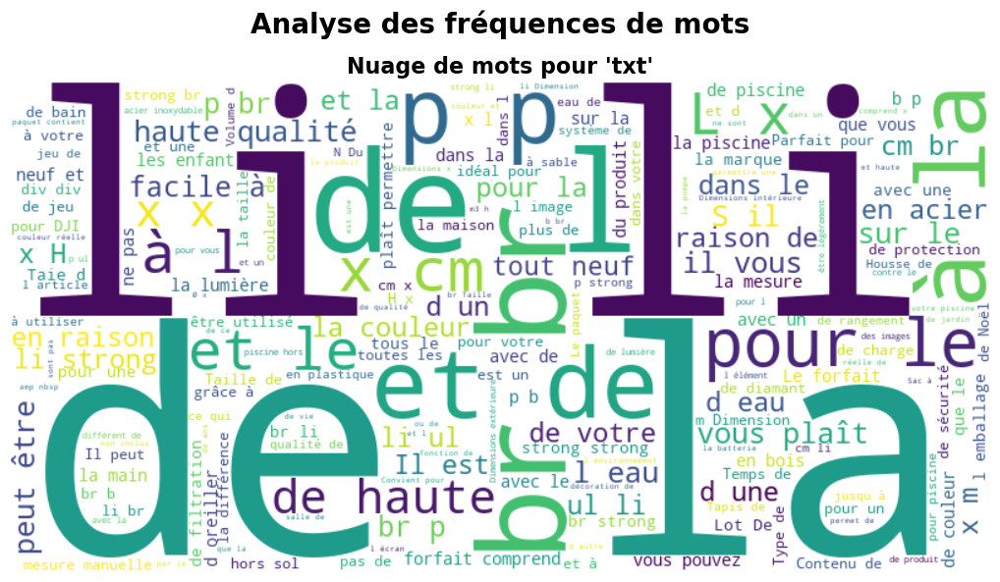

Génération des WordClouds par colonne:   7%|▋         | 1/15 [00:17<03:59, 17.13s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_0.png


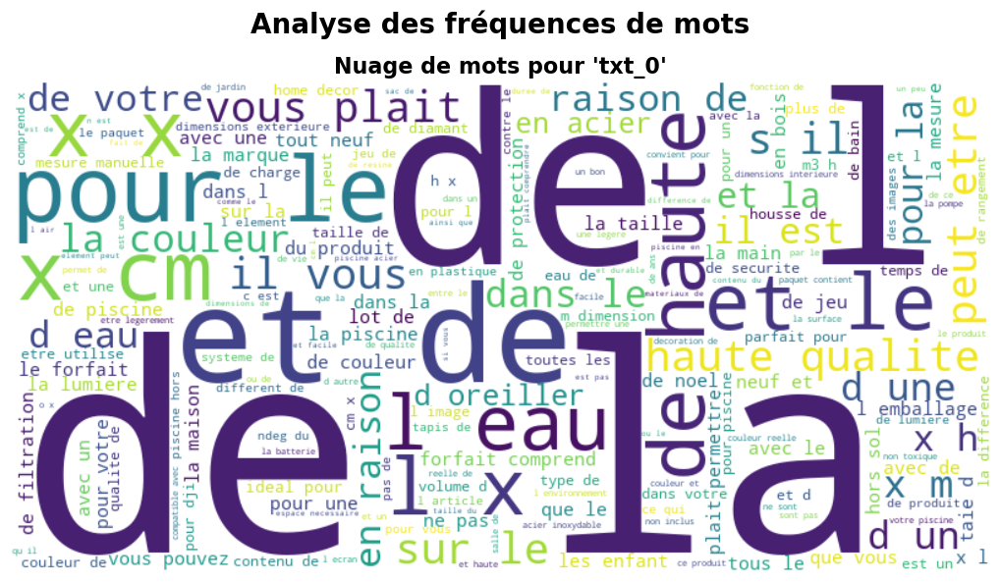

Génération des WordClouds par colonne:  13%|█▎        | 2/15 [00:32<03:32, 16.31s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_fr.png


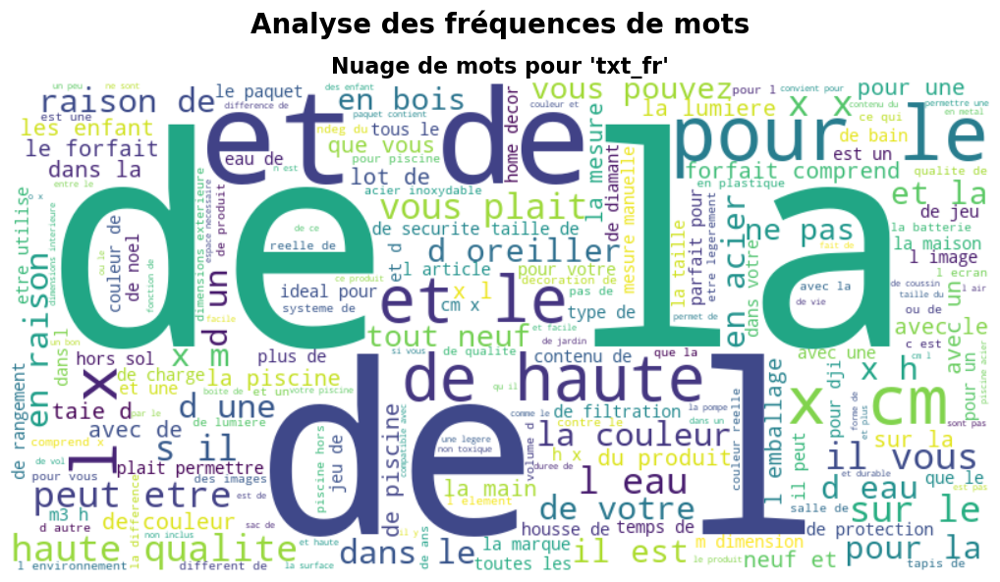

Génération des WordClouds par colonne:  20%|██        | 3/15 [00:48<03:10, 15.87s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_0_tok.png


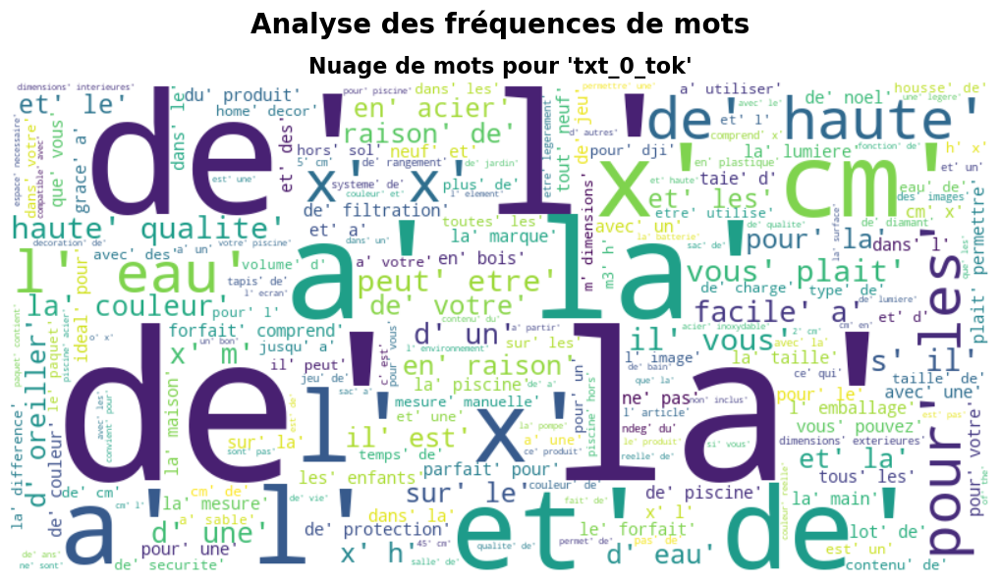

Génération des WordClouds par colonne:  27%|██▋       | 4/15 [01:04<02:56, 16.06s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_fr_tok.png


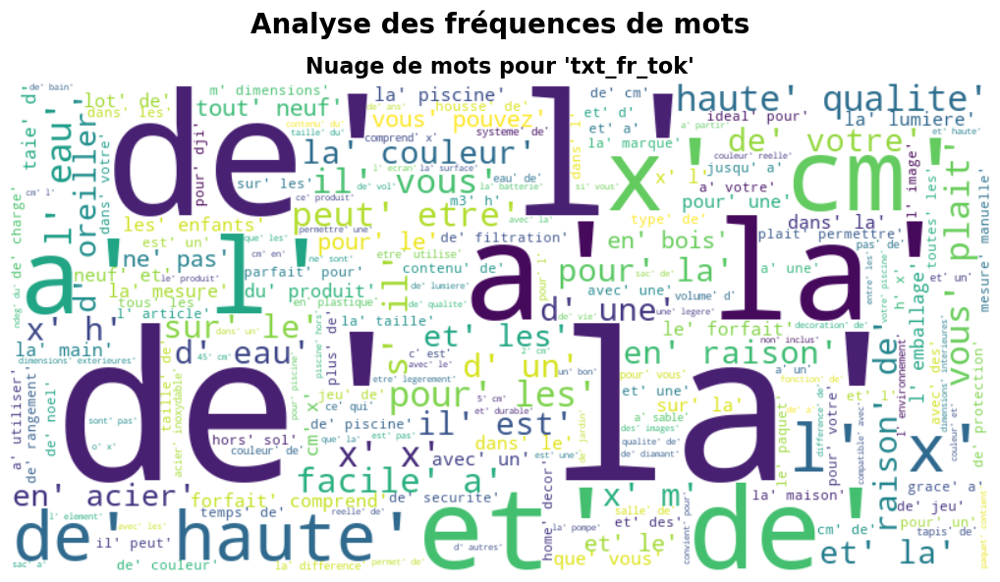

Génération des WordClouds par colonne:  33%|███▎      | 5/15 [01:20<02:40, 16.07s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_fr_0_stp.png


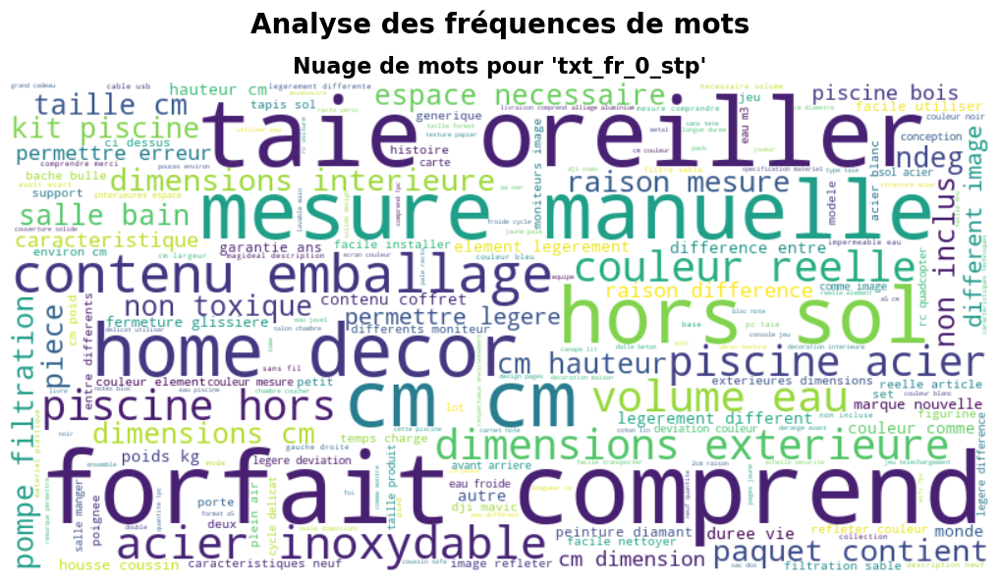

Génération des WordClouds par colonne:  40%|████      | 6/15 [01:33<02:14, 14.99s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_0_0_stp.png


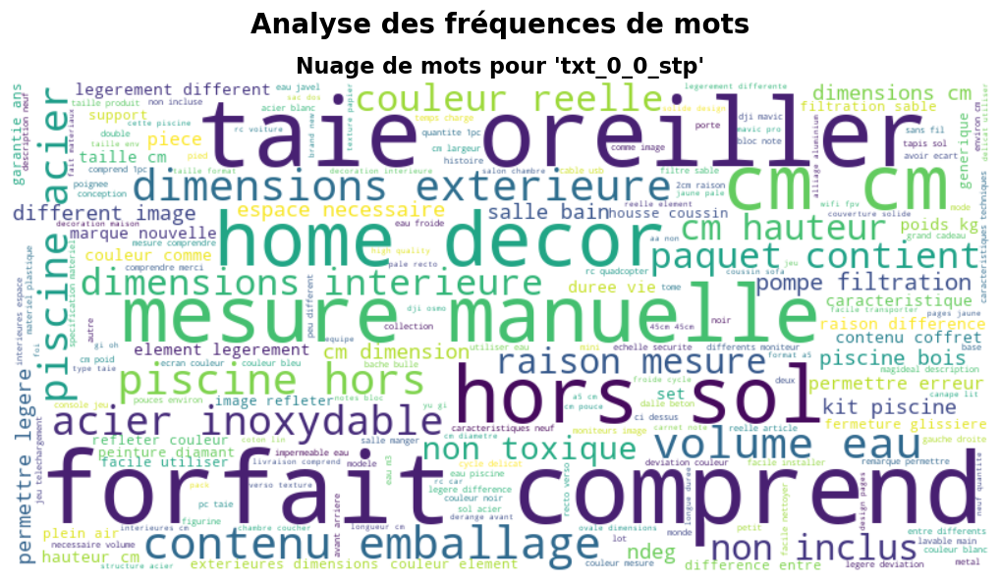

Génération des WordClouds par colonne:  47%|████▋     | 7/15 [01:46<01:54, 14.37s/it]

 Colonne introuvable dans X_train : txt_0_tok_stp_lem 
 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_fr_tok_stp_lem.png


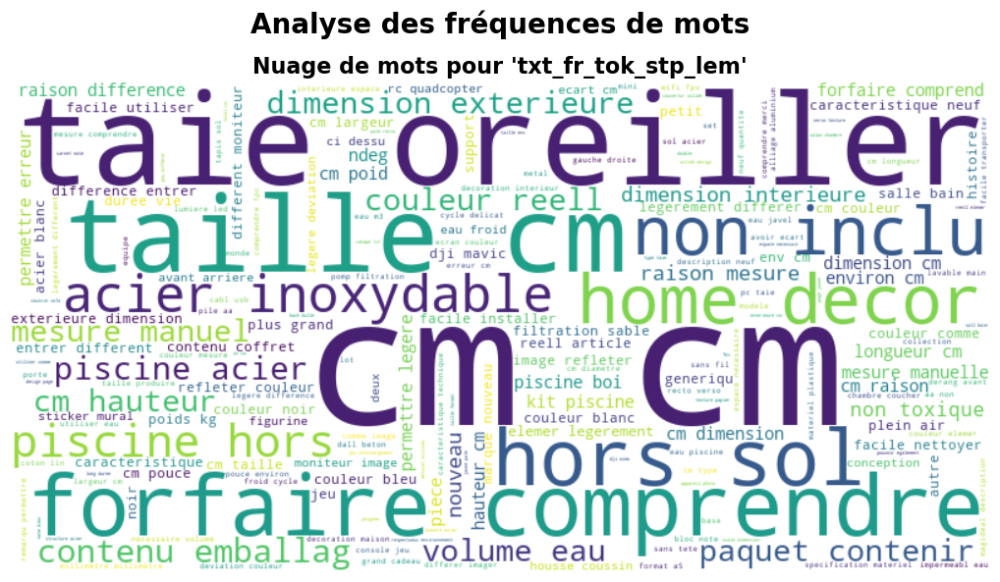

Génération des WordClouds par colonne:  60%|██████    | 9/15 [01:59<01:02, 10.44s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_0_tok_lem.png


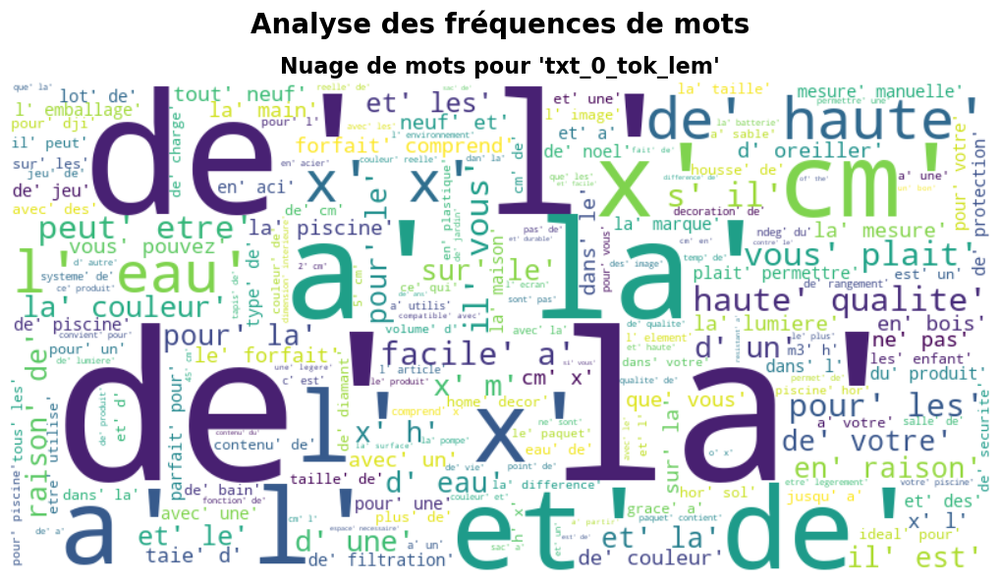

Génération des WordClouds par colonne:  67%|██████▋   | 10/15 [02:14<00:58, 11.75s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_fr_tok_lem.png


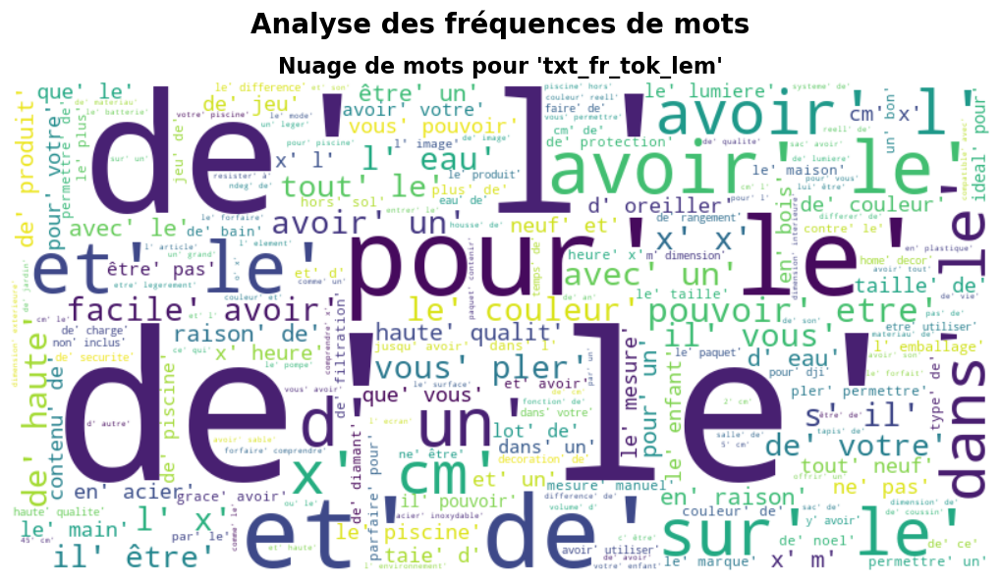

Génération des WordClouds par colonne:  73%|███████▎  | 11/15 [02:30<00:51, 12.78s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_0_0_stp_lem.png


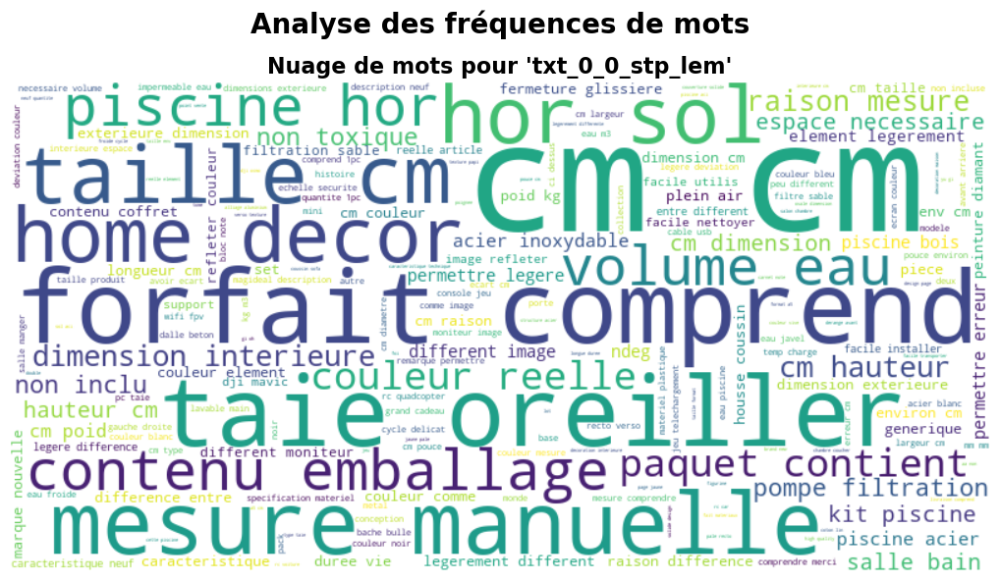

Génération des WordClouds par colonne:  80%|████████  | 12/15 [02:43<00:38, 12.85s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_fr_0_stp_lem.png


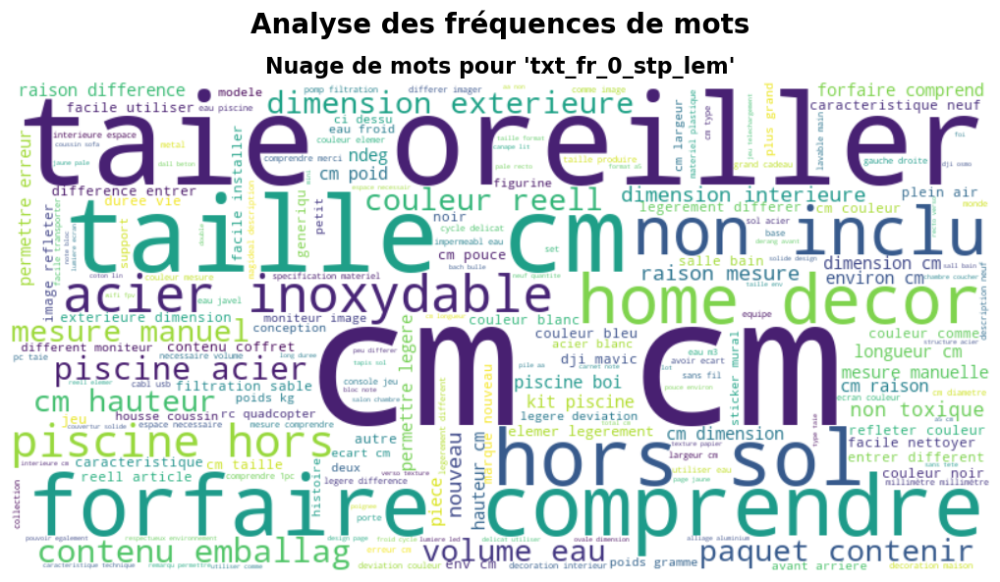

Génération des WordClouds par colonne:  87%|████████▋ | 13/15 [02:55<00:25, 12.76s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_0_lem.png


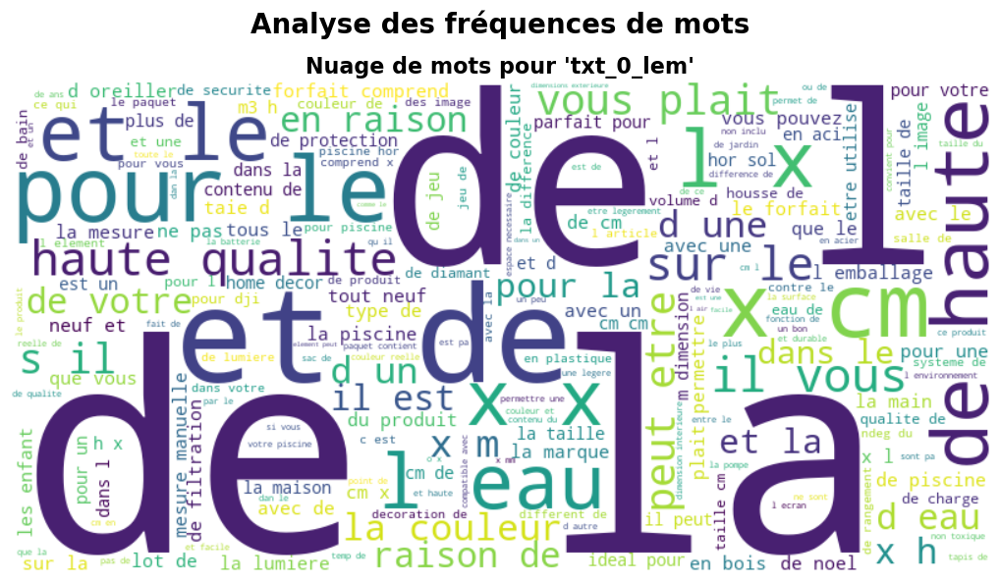

Génération des WordClouds par colonne:  93%|█████████▎| 14/15 [03:11<00:13, 13.56s/it]

 WordCloud enregistré : ./Preprocessing/WordCloud/Globale\wordcloud_txt_fr_lem.png


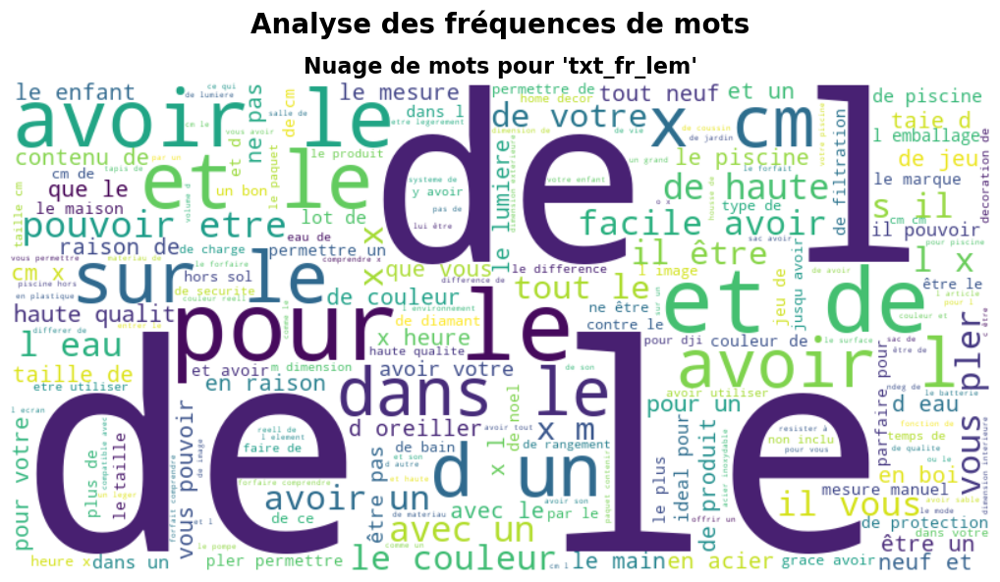

Génération des WordClouds par colonne: 100%|██████████| 15/15 [03:27<00:00, 13.80s/it]


In [14]:


# Dossier de sauvegarde
save_dir = "./Preprocessing/WordCloud/Globale"
os.makedirs(save_dir, exist_ok=True)

# Colonnes à analyser
token_columns = [
    "txt", "txt_0", "txt_fr",
    "txt_0_tok", "txt_fr_tok",
    "txt_fr_0_stp", "txt_0_0_stp",
    "txt_0_tok_stp_lem ", "txt_fr_tok_stp_lem",
    "txt_0_tok_lem", "txt_fr_tok_lem",
    "txt_0_0_stp_lem", "txt_fr_0_stp_lem",
    "txt_0_lem", "txt_fr_lem"
]

# Configuration des WordClouds
wordcloud_config = {
    'width': 800,
    'height': 400,
    'background_color': 'white',
    'colormap': 'viridis',
    'max_words': 200,
    'contour_color': 'black',
    'contour_width': 1,
    'prefer_horizontal': 0.9,
    'random_state': 42
}

# Fonction pour générer et enregistrer un WordCloud
def generate_wordcloud(text_series, title, main_title, filename):
    plt.figure(figsize=(12, 6))
    plt.suptitle(main_title, fontsize=20, fontweight='bold', color='black')
    
    # Unifier les tokens en une seule chaîne
    text = text_series.dropna().apply(lambda x: ' '.join(x) if isinstance(x, list) else str(x))
    text_combined = " ".join(text)
    
    wordcloud = WordCloud(**wordcloud_config).generate(text_combined)
    
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(title, fontsize=16, fontweight='bold', color='black')
    plt.tight_layout()
    
    # Enregistrer l'image
    save_path = os.path.join(save_dir, filename)
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    print(f" WordCloud enregistré : {save_path}")
    
    plt.show()

# Générer les WordClouds pour chaque colonne
for col in tqdm(token_columns, desc="Génération des WordClouds par colonne"):
    if col in X_train.columns:
        generate_wordcloud(
            X_train[col],
            title=f"Nuage de mots pour '{col}'",
            main_title="Analyse des fréquences de mots",
            filename=f"wordcloud_{col}.png"
        )
    else:
        print(f" Colonne introuvable dans X_train : {col}")


## Par categorie

In [21]:
df_preprocessed_with_cat=pd.read_csv("./Preprocessing/dfs/X_train_lemmatized_stopwords.csv")
categorie = {
    10 : "Livre occasion",
    40 : "Jeu vidéo, accessoire tech.",
    50 : "Accessoire Console",
    60 : "Console de jeu",
    1140 : "Figurine",
    1160 : "Carte Collection",
    1180 : "Jeu Plateau",
    1280 : "Jouet enfant, déguisement",
    1281 : "Jeu de société",
    1300 : "Jouet tech",
    1301 : "Paire de chaussettes",
    1302 : "Jeu extérieur, vêtement",
    1320 : "Autour du bébé",
    1560 : "Mobilier intérieur",
    1920 : "Chambre",
    1940 : "Cuisine",
    2060 : "Décoration intérieure",
    2220 : "Animal",
    2280 : "Revues et journaux",
    2403 : "Magazines, livres et BDs",
    2462 : "Jeu occasion",
    2522 : "Bureautique et papeterie",
    2582 : "Mobilier extérieur",
    2583 : "Autour de la piscine",
    2585 : "Bricolage",
    2705 : "Livre neuf",
    2905 : "Jeu PC",
}

df_preprocessed_with_cat["categorie"]=df_preprocessed_with_cat['prdtypecode'].map(categorie)
df_preprocessed_with_cat.to_csv("./Preprocessing/dfs/preprocessed_with_cat.csv", index=False)

In [23]:
display (df_preprocessed_with_cat)

,designation,description,productid,imageid,prdtypecode,txt,txt_0,txt_fr,txt_0_tok,txt_fr_tok,...,txt_0_0_stp,txt_0_tok_stp_lem,txt_fr_tok_stp_lem,txt_0_tok_lem,txt_fr_tok_lem,txt_0_0_stp_lem,txt_fr_0_stp_lem,txt_0_lem,txt_fr_lem,categorie
0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046,10,Olivia: Personalisiertes Notizbuch / 150 Seite...,olivia personalisiertes notizbuch seiten punkt...,carnet personnalise olivia pages a pois format...,"['olivia', 'personalisiertes', 'notizbuch', 's...","['carnet', 'personnalise', 'olivia', 'pages', ...",...,olivia personalisiertes notizbuch seiten punkt...,"['olivia', 'personalisierte', 'notizbuch', 'se...","['carnet', 'personnalis', 'olivia', 'page', 'p...","['olivia', 'personalisierte', 'notizbuch', 'se...","['carnet', 'personnalis', 'olivia', 'page', 'a...",olivia personalisierte notizbuch seiten punktr...,carnet personnalis olivia page pois format a5 ...,olivia personalisierte notizbuch seiten punktr...,carnet personnalis olivia page avoir pois form...,Livre occasion
1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237,2280,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,journal des arts le ndeg du l art et son march...,journal des arts le ndeg du l art et son march...,"['journal', 'des', 'arts', 'le', 'ndeg', 'du',...","['journal', 'des', 'arts', 'le', 'ndeg', 'du',...",...,journal arts ndeg art marche salon art asiatiq...,"['journal', 'arts', 'ndeg', 'art', 'marche', '...","['journal', 'art', 'ndeg', 'art', 'marche', 's...","['journal', 'des', 'arts', 'le', 'ndeg', 'du',...","['journal', 'de', 'art', 'le', 'ndeg', 'de', '...",journal arts ndeg art marche salon art asiatiq...,journal art ndeg art marche salon art asiatiqu...,journal des arts le ndeg du l art et son march...,journal de art le ndeg de l art et son marche ...,Revues et journaux
2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978,50,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,grand stylet ergonomique bleu gamepad nintendo...,grand stylet ergonomique bleu gamepad nintendo...,"['grand', 'stylet', 'ergonomique', 'bleu', 'ga...","['grand', 'stylet', 'ergonomique', 'bleu', 'ga...",...,grand stylet ergonomique bleu gamepad nintendo...,"['grand', 'stylet', 'ergonomique', 'bleu', 'ga...","['grand', 'stylet', 'ergonomique', 'bleu', 'ga...","['grand', 'stylet', 'ergonomique', 'bleu', 'ga...","['grand', 'stylet', 'ergonomique', 'bleu', 'ga...",grand stylet ergonomique bleu gamepad nintendo...,grand stylet ergonomique bleu gamepad nintendo...,grand stylet ergonomique bleu gamepad nintendo...,grand stylet ergonomique bleu gamepad nintendo...,Accessoire Console
3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496,1280,Peluche Donald - Europe - Disneyland 2000 (Mar...,peluche donald europe disneyland marionnette a...,peluche donald europe disneyland marionnette a...,"['peluche', 'donald', 'europe', 'disneyland', ...","['peluche', 'donald', 'europe', 'disneyland', ...",...,peluche donald europe disneyland marionnette d...,"['peluche', 'donald', 'europe', 'disneyland', ...","['peluche', 'donald', 'europe', 'disneyland', ...","['peluche', 'donald', 'europe', 'disneyland', ...","['peluche', 'donald', 'europe', 'disneyland', ...",peluche donald europe disneyland marionnette d...,peluche donald europe disneyland marionnette d...,peluche donald europe disneyland marionnette a...,peluche donald europe disneyland marionnette a...,"Jouet enfant, déguisement"
4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786,2705,La Guerre Des Tuques Luc a des id&eacute;es de...,la guerre des tuques luc a des idees de grande...,la guerre des tuques luc a des idees de grande...,"['la', 'guerre', 'des', 'tuques', 'luc', 'a', ...","['la', 'guerre', 'des', 'tuques', 'luc', 'a', ...",...,guerre tuques luc idees grandeur veut organise...,"['guerre', 'tuque', 'luc', 'idee', 'gran

Génération des WordClouds par catégorie:   0%|          | 0/27 [00:00<?, ?it/s]

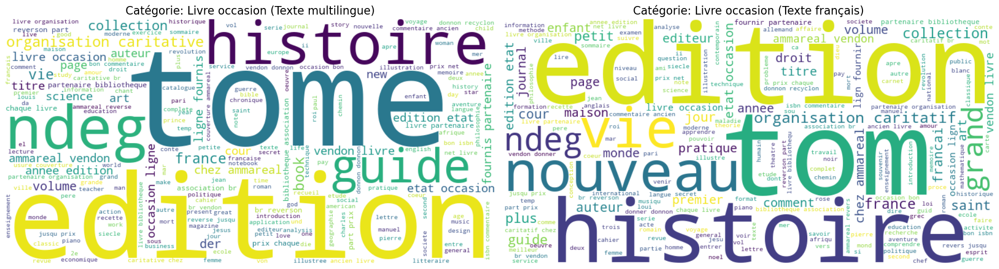

Génération des WordClouds par catégorie:   4%|▎         | 1/27 [00:02<00:52,  2.02s/it]

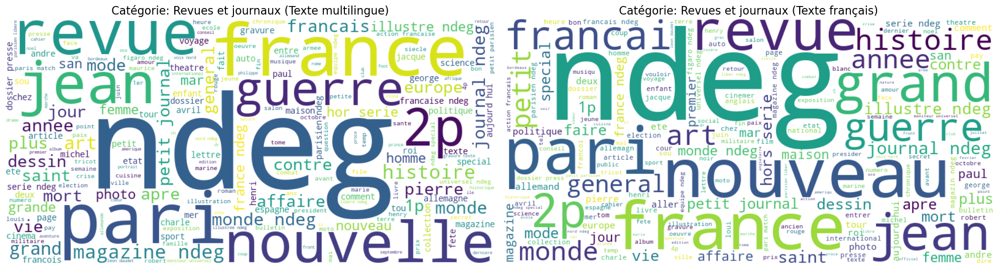

Génération des WordClouds par catégorie:   7%|▋         | 2/27 [00:04<00:50,  2.00s/it]

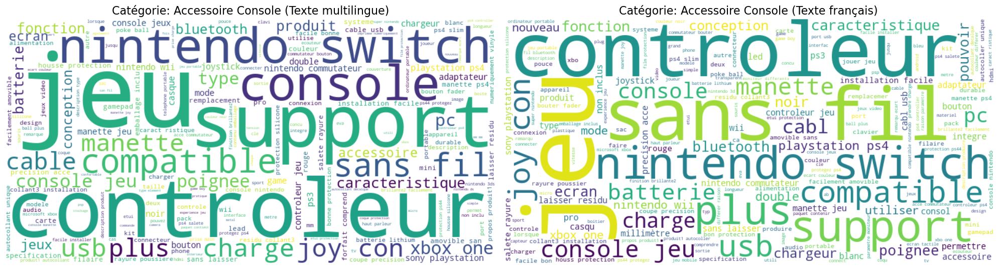

Génération des WordClouds par catégorie:  11%|█         | 3/27 [00:06<00:50,  2.11s/it]

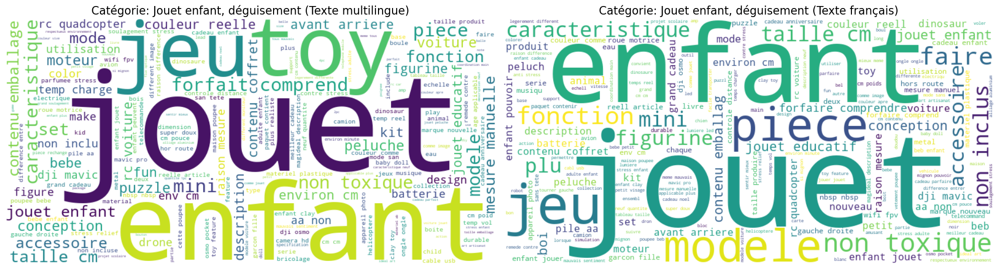

Génération des WordClouds par catégorie:  15%|█▍        | 4/27 [00:09<01:03,  2.75s/it]

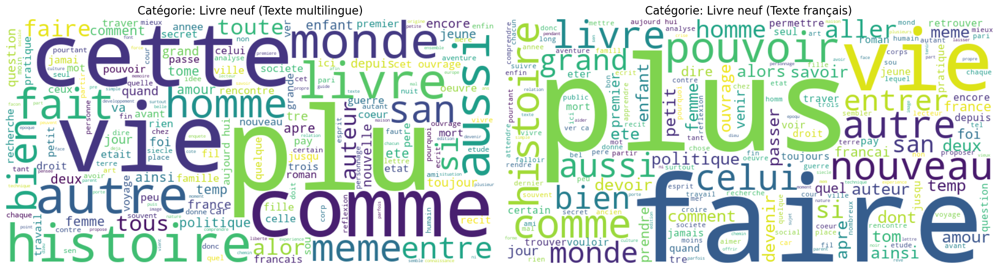

Génération des WordClouds par catégorie:  19%|█▊        | 5/27 [00:13<01:02,  2.85s/it]

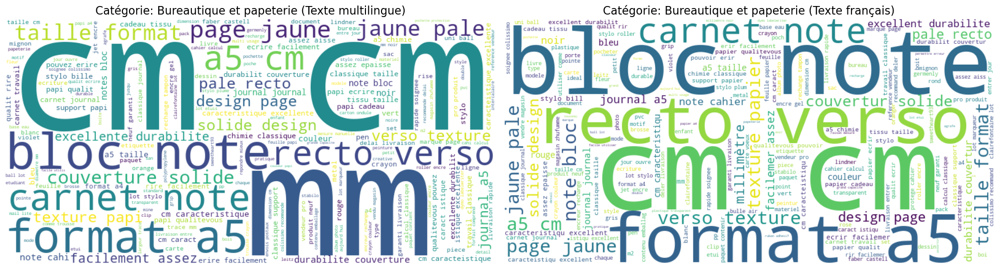

Génération des WordClouds par catégorie:  22%|██▏       | 6/27 [00:15<00:58,  2.79s/it]

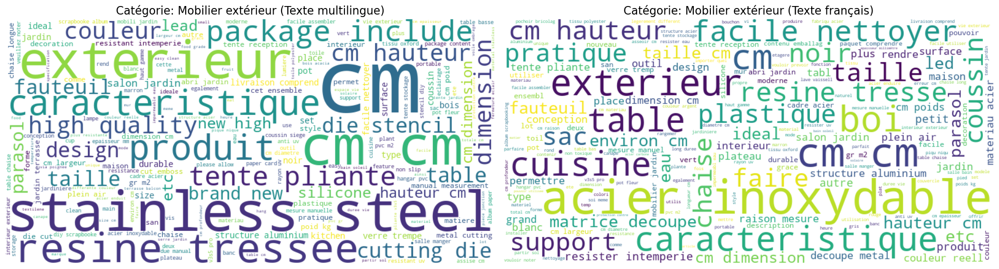

Génération des WordClouds par catégorie:  26%|██▌       | 7/27 [00:18<00:56,  2.80s/it]

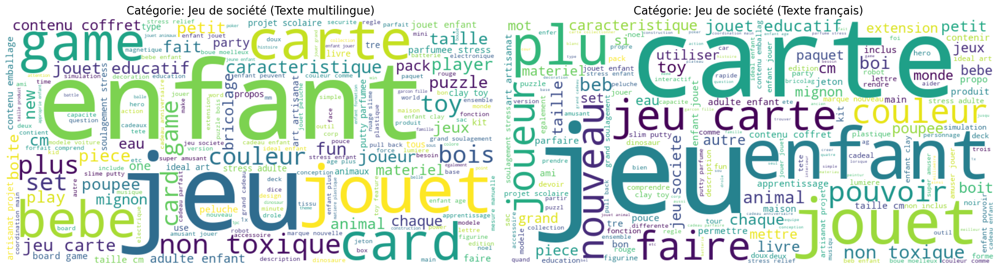

Génération des WordClouds par catégorie:  30%|██▉       | 8/27 [00:21<00:52,  2.76s/it]

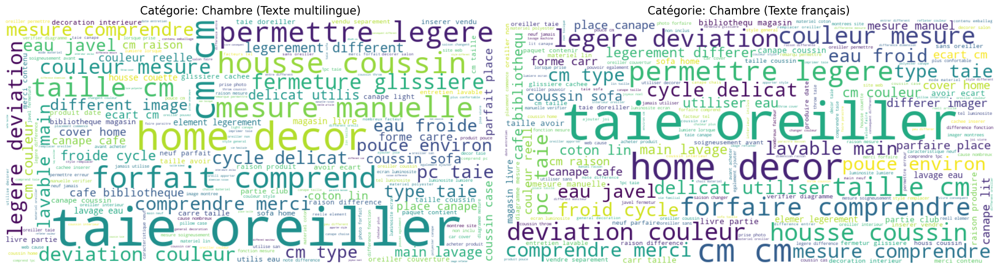

Génération des WordClouds par catégorie:  33%|███▎      | 9/27 [00:24<00:51,  2.85s/it]

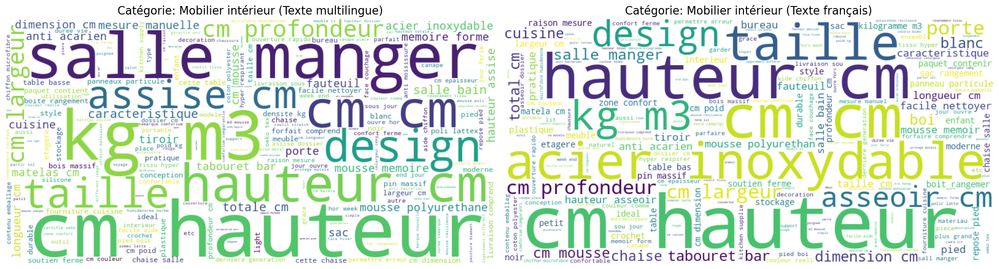

Génération des WordClouds par catégorie:  37%|███▋      | 10/27 [00:28<00:56,  3.33s/it]

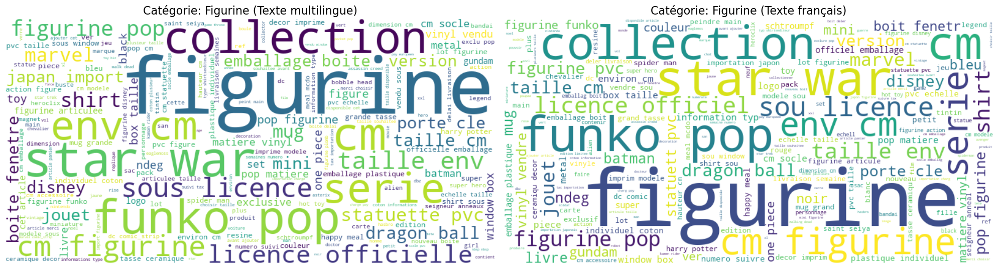

Génération des WordClouds par catégorie:  41%|████      | 11/27 [00:30<00:46,  2.90s/it]

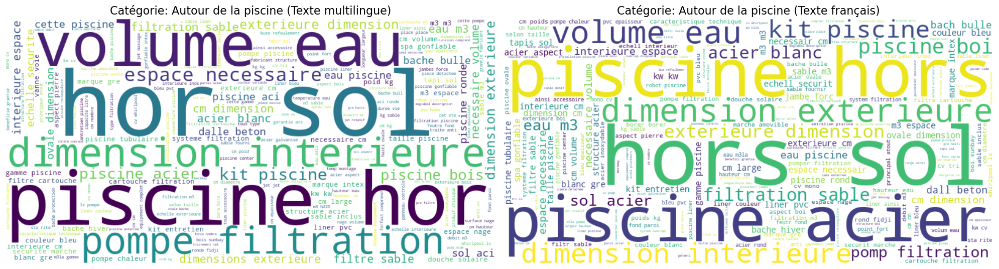

Génération des WordClouds par catégorie:  44%|████▍     | 12/27 [00:34<00:50,  3.37s/it]

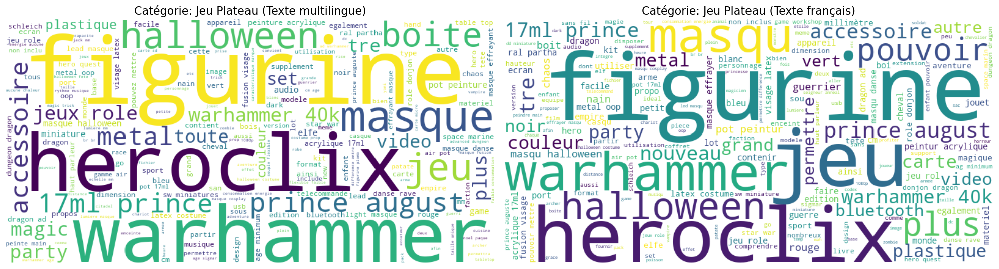

Génération des WordClouds par catégorie:  48%|████▊     | 13/27 [00:36<00:40,  2.91s/it]

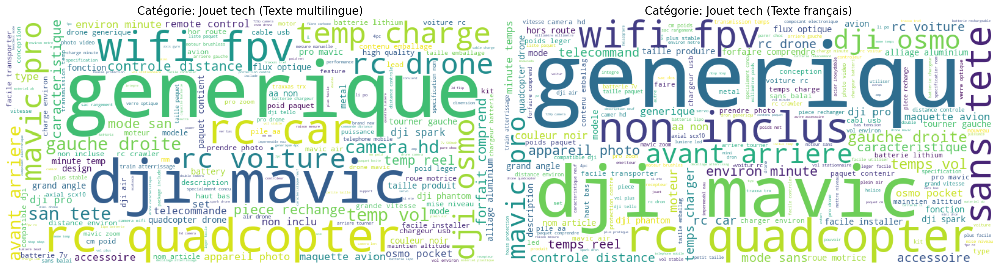

Génération des WordClouds par catégorie:  52%|█████▏    | 14/27 [00:40<00:42,  3.28s/it]

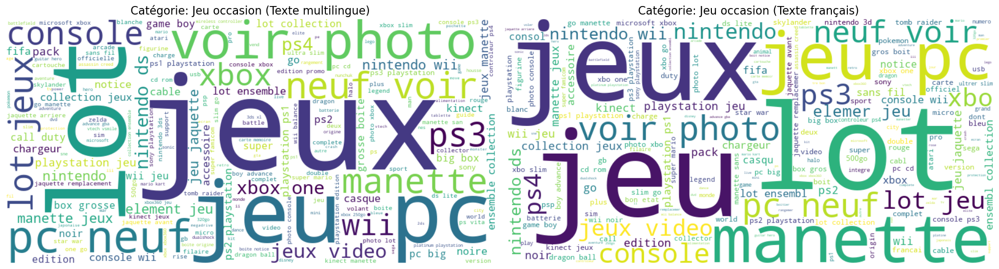

Génération des WordClouds par catégorie:  56%|█████▌    | 15/27 [00:42<00:34,  2.90s/it]

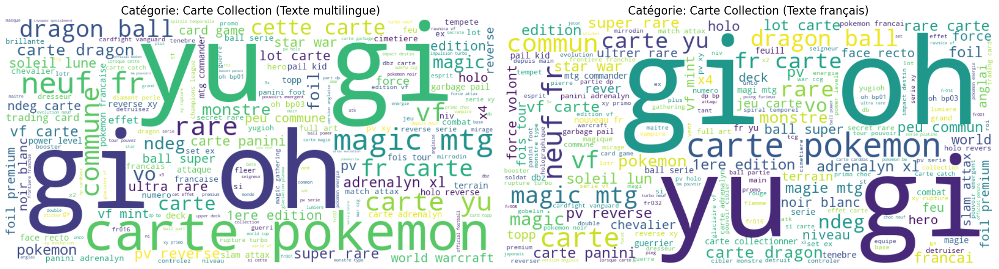

Génération des WordClouds par catégorie:  59%|█████▉    | 16/27 [00:45<00:29,  2.70s/it]

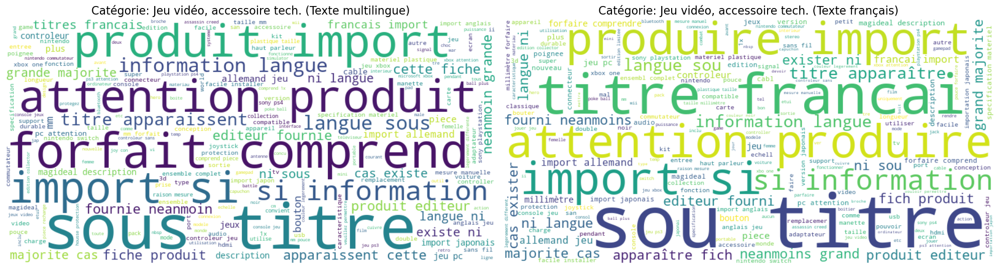

Génération des WordClouds par catégorie:  63%|██████▎   | 17/27 [00:47<00:25,  2.52s/it]

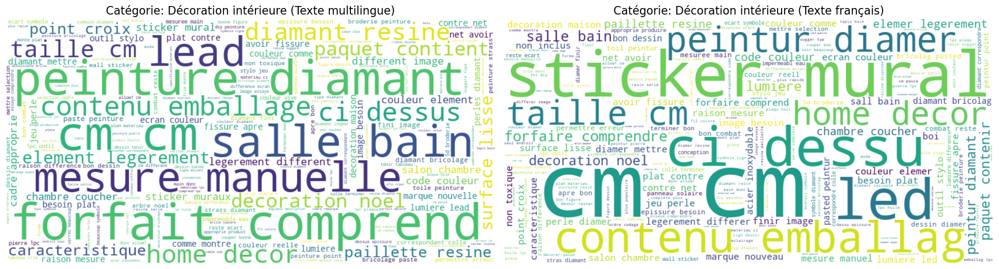

Génération des WordClouds par catégorie:  67%|██████▋   | 18/27 [00:52<00:28,  3.17s/it]

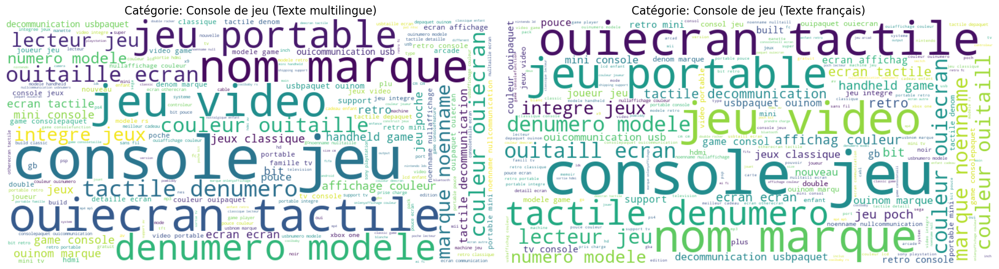

Génération des WordClouds par catégorie:  70%|███████   | 19/27 [00:53<00:22,  2.81s/it]

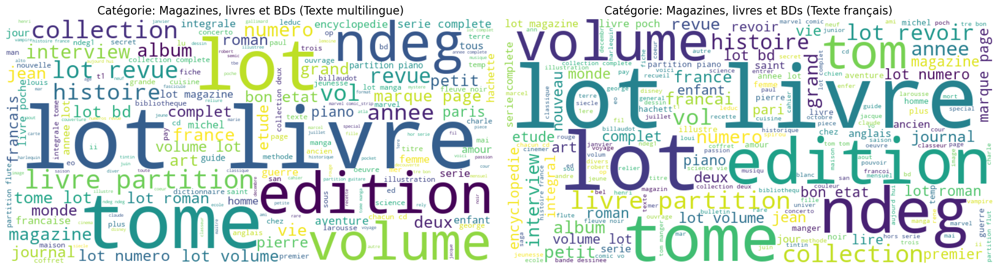

Génération des WordClouds par catégorie:  74%|███████▍  | 20/27 [00:55<00:17,  2.56s/it]

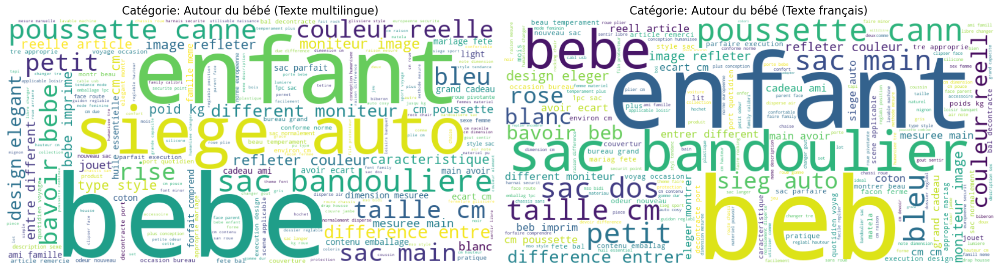

Génération des WordClouds par catégorie:  78%|███████▊  | 21/27 [00:58<00:15,  2.58s/it]

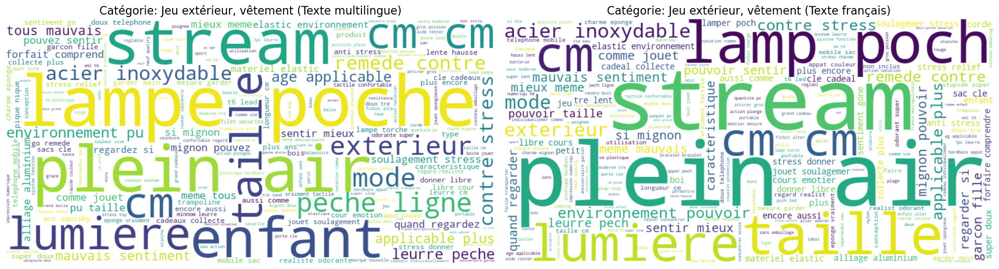

Génération des WordClouds par catégorie:  81%|████████▏ | 22/27 [01:01<00:13,  2.66s/it]

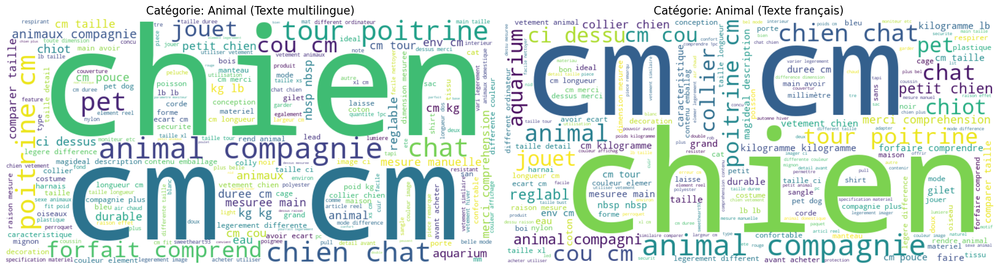

Génération des WordClouds par catégorie:  85%|████████▌ | 23/27 [01:03<00:10,  2.51s/it]

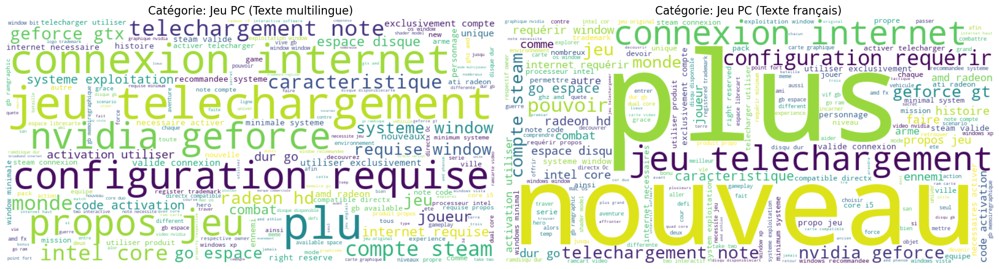

Génération des WordClouds par catégorie:  89%|████████▉ | 24/27 [01:06<00:08,  2.68s/it]

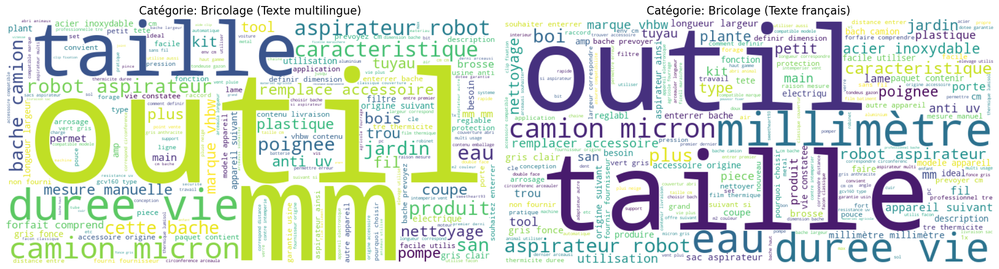

Génération des WordClouds par catégorie:  93%|█████████▎| 25/27 [01:09<00:05,  2.78s/it]

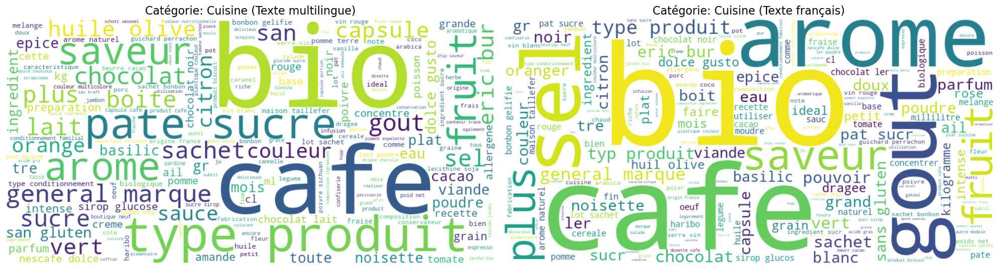

Génération des WordClouds par catégorie:  96%|█████████▋| 26/27 [01:11<00:02,  2.48s/it]

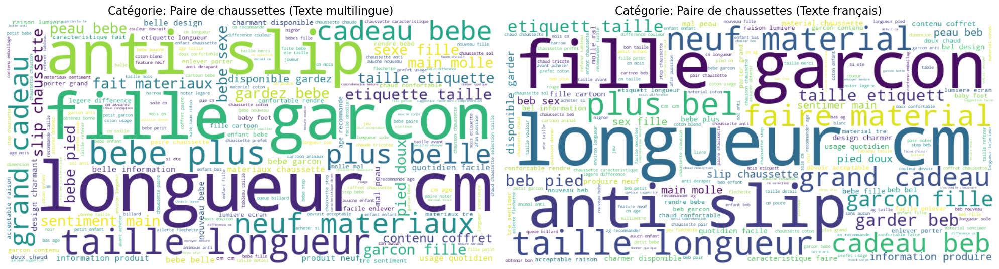

Génération des WordClouds par catégorie: 100%|██████████| 27/27 [01:13<00:00,  2.72s/it]

 Wordclouds enregistrés dans le dossier : ./Preprocessing/WordCloud/Categories


In [25]:
# Dossier de sauvegarde
output_folder = "./Preprocessing/WordCloud/Categories"
os.makedirs(output_folder, exist_ok=True)

# Récupérer les catégories uniques
categories = df_preprocessed_with_cat['categorie'].unique()

# Parcourir chaque catégorie avec une barre de progression
for cat in tqdm(categories, desc="Génération des WordClouds par catégorie"):
    # Filtrer le DataFrame pour la catégorie courante
    cat_df = df_preprocessed_with_cat[df_preprocessed_with_cat['categorie'] == cat]

    # Préparer et nettoyer le texte multilingue
    text_en = " ".join(
        cat_df['txt_0_tok_stp_lem'].dropna()
        .apply(lambda x: " ".join(x) if isinstance(x, list) else str(x))
        .tolist()
    )
    text_en = re.sub(r"[’'`]", "", text_en)  # Suppression des apostrophes

    # Préparer et nettoyer le texte français
    text_fr = " ".join(
        cat_df['txt_fr_tok_stp_lem'].dropna()
        .apply(lambda x: " ".join(x) if isinstance(x, list) else str(x))
        .tolist()
    )
    text_fr = re.sub(r"[’'`]", "", text_fr)  # Suppression des apostrophes

    # Générer le wordcloud pour le texte multilingue
    wc_en = WordCloud(
        background_color="white",
        max_words=200,
        width=800,
        height=400,
        colormap="viridis"
    ).generate(text_en)

    # Générer le wordcloud pour le texte français
    wc_fr = WordCloud(
        background_color="white",
        max_words=200,
        width=800,
        height=400,
        colormap="viridis"
    ).generate(text_fr)

    # Enregistrer les wordclouds en tant qu'images PNG
    wc_en.to_file(os.path.join(output_folder, f"wordcloud_{cat}_multilingue.png"))
    wc_fr.to_file(os.path.join(output_folder, f"wordcloud_{cat}_francais.png"))

    # Affichage des wordclouds
    fig, axs = plt.subplots(1, 2, figsize=(20, 10))
    axs[0].imshow(wc_en, interpolation="bilinear")
    axs[0].axis("off")
    axs[0].set_title(f"Catégorie: {cat} (Texte multilingue)", fontsize=16)

    axs[1].imshow(wc_fr, interpolation="bilinear")
    axs[1].axis("off")
    axs[1].set_title(f"Catégorie: {cat} (Texte français)", fontsize=16)

    plt.tight_layout()
    plt.show()

print(f" Wordclouds enregistrés dans le dossier : {output_folder}")


Bien que la plupart des catégories aient des mots qui reflètent leur thèmes, on constate fréquemment que des mots génériques tel que peut, plus, être, cette apparaissent dans le top 10. Ces mots ont probablement échappé à la liste des stop words censée les filtrer. Il n'apportent pas d'information sur la catégorie.

# Gestion des doublons (DFs utilisés pour machine learning classique)

In [130]:
X_train = pd.read_csv("./Preprocessing/dfs/X_train_lemmatized_stopwords.csv")
X_test = pd.read_csv("./Preprocessing/dfs/X_test_lemmatized_stopwords.csv")
X_val = pd.read_csv("./Preprocessing/dfs/X_val_lemmatized_stopwords.csv")

X_train = X_train[['prdtypecode','txt_0_tok_stp_lem', 'txt_fr_tok_stp_lem']]
X_test = X_test[['prdtypecode','txt_0_tok_stp_lem', 'txt_fr_tok_stp_lem']]
X_val= X_val[['prdtypecode','txt_0_tok_stp_lem', 'txt_fr_tok_stp_lem']]

display(X_train,X_test,X_val)

,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem
0,10,"['olivia', 'personalisierte', 'notizbuch', 'se...","['carnet', 'personnalis', 'olivia', 'page', 'p..."
1,2280,"['journal', 'arts', 'ndeg', 'art', 'marche', '...","['journal', 'art', 'ndeg', 'art', 'marche', 's..."
2,50,"['grand', 'stylet', 'ergonomique', 'bleu', 'ga...","['grand', 'stylet', 'ergonomique', 'bleu', 'ga..."
3,1280,"['peluche', 'donald', 'europe', 'disneyland', ...","['peluche', 'donald', 'europe', 'disneyland', ..."
4,2705,"['guerre', 'tuque', 'luc', 'idee', 'grandeur',...","['guerre', 'tuque', 'luc', 'idee', 'grandeur',..."
...,...,...,...
67927,2220,"['vetement', 'animaux', 'mode', 'style', 'chie...","['vetement', 'animal', 'mod', 'styl', 'chien',..."
67928,40,"['sims', 'import', 'anglais']","['the', 'sims', 'import', 'anglais']"
67929,2583,"['kit', 'piscine', 'aci', 'nevada', 'deco', 'p...","['kit', 'piscine', 'acier', 'nevader', 'deco',..."
67930,1560,"['table', 'basse', 'bois', 'recuperation', 'ma...","['table', 'bas', 'bois', 'recuperation', 'mass..."


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem
0,2280,"['afrique', 'contemporaine', 'ndeg', 'hiver', ...","['afrique', 'contemporain', 'ndeg', 'hiver', '..."
1,2403,"['walter', 'scott', 'oeuvres', 'complete', 'to...","['walter', 'scott', 'oeuvre', 'complete', 'tome']"
2,1140,"['vehicule', 'star', 'war', 'ast5', 'vehicule'...","['vehicule', 'star', 'war', 'ast5', 'vehicule'..."
3,2522,"['lindner', '2115ce', 'coin', 'case', 'nera', ...","['lindner', '2115ce', 'coffret', 'piece', 'mon..."
4,1920,"['rideau', 'oeillet', 'plastique', 'polyester'...","['rideau', 'oeillet', 'plastique', 'polyester'..."
...,...,...,...
8487,1280,"['jxd', '508v', '4ch', 'hd', 'wifi', 'fpv', 'q...","['jxd', '508v', '4ch', 'hd', 'wifi', 'fpv', 'q..."
8488,1302,"['remplacement', 'bracelet', 'cuir', 'veritabl...","['remplacemer', 'bracelet', 'cuir', 'veritabl'..."
8489,1302,"['finger', 'brancard', 'force', 'trainer', 'go...","['finger', 'brancard', 'forc', 'trainer', 'for..."
8490,2060,"['ramadan', 'eid', 'luxe', 'lumiere', 'del', '...","['ramadan', 'eid', 'lux', 'lumiere', 'del', 'i..."


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem
0,1560,"['eames', 'inspire', 'sxw', 'chair', 'pink', '...","['chaise', 'sxw', 'inspiree', 'eame', 'rose', ..."
1,1560,"['fauteuil', 'chesterfield', 'brenton', 'cuir'...","['fauteuil', 'chesterfield', 'brenton', 'cuir'..."
2,2280,"['monde', 'illustre', 'ndeg', 'emprunt', 'vict...","['monde', 'illustre', 'ndeg', 'emprunt', 'vict..."
3,2060,"['lampe', 'lecture', 'rechargeable', 'lead', '...","['lamp', 'lecture', 'rechargeable', 'led', 'la..."
4,1160,"['dragon', 'ball', 'serie', 'francaise']","['dragon', 'ball', 'serie', 'francais']"
...,...,...,...
8487,2582,"['espritzen', 'couette', 'saison', '260x240', ...","['espritzen', 'couette', 'saison', '260x240', ..."
8488,1302,"['nouvelle', 'simulation', 'etoile', 'montante...","['nouveau', 'simulation', 'etoil', 'montant', ..."
8489,2582,"['petit', 'flamant', 'rise', 'decoratif', 'jar...","['petit', 'flamer', 'rose', 'decoratif', 'jard..."
8490,2583,"['espa', 'kit', 'complet', 'nage', 'contre', '...","['espa', 'kit', 'complet', 'nag', 'contre', 'c..."


## Suppression des doublons dans une liste de tokens

### Detection

In [131]:
# Fonction qui détecte les doublons dans une liste de tokens
def find_duplicates(token_list):
    if isinstance(token_list, str):
        try:
            token_list = ast.literal_eval(token_list)
        except Exception:
            return None
    if not isinstance(token_list, list):
        return None
    counts = Counter(token_list)
    return [token for token, count in counts.items() if count > 1] or None

# Liste des DataFrames et leur nom pour affichage
datasets = {
    "X_train": X_train,
    "X_test": X_test,
    "X_val": X_val
}

# Colonnes à traiter
cols = {
    "txt_0_tok_stp_lem": "doublons_en",
    "txt_fr_tok_stp_lem": "doublons_fr"
}

# Application sur chaque DataFrame
for name, df in datasets.items():
    print(f"\n Analyse des doublons dans {name}")
    
    for col, new_col in cols.items():
        if col in df.columns:
            df[new_col] = df[col].apply(find_duplicates)
    
    # Filtrer les lignes avec doublons
    df_doublons = df[df["doublons_en"].notnull() | df["doublons_fr"].notnull()]
    
    # Affichage résumé
    print(f" Lignes contenant des doublons dans {name} : {len(df_doublons)}")
    
    # Aperçu des premières lignes avec doublons
    display(df_doublons[["prdtypecode", "txt_0_tok_stp_lem", "doublons_en", "txt_fr_tok_stp_lem", "doublons_fr"]].head())



 Analyse des doublons dans X_train
 Lignes contenant des doublons dans X_train : 46445


,prdtypecode,txt_0_tok_stp_lem,doublons_en,txt_fr_tok_stp_lem,doublons_fr
1,2280,"['journal', 'arts', 'ndeg', 'art', 'marche', '...",[art],"['journal', 'art', 'ndeg', 'art', 'marche', 's...",[art]
2,50,"['grand', 'stylet', 'ergonomique', 'bleu', 'ga...","[grand, stylet, ergonomique, bleu, gamepad, ni...","['grand', 'stylet', 'ergonomique', 'bleu', 'ga...","[grand, stylet, ergonomique, bleu, gamepad, ni..."
4,2705,"['guerre', 'tuque', 'luc', 'idee', 'grandeur',...",[guerre],"['guerre', 'tuque', 'luc', 'idee', 'grandeur',...",[guerre]
6,2522,"['conquerant', 'sept', 'cahi', 'couverture', '...","[conquerant, cahi, polypro, mm, page, seye]","['conquerer', 'sept', 'cahier', 'couverture', ...","[conquerer, cahier, polypro, mm, page, seye]"
8,2582,"['tente', 'pliante', 'v3s5', 'pro', 'pvc', 'bl...","[tente, pliante, v3s5, pro, pvc, blanc, 4m50, ...","['tente', 'pliante', 'v3s5', 'pro', 'pvc', 'bl...","[tente, pliante, v3s5, pro, pvc, blanc, 4m50, ..."



 Analyse des doublons dans X_test
 Lignes contenant des doublons dans X_test : 5811


,prdtypecode,txt_0_tok_stp_lem,doublons_en,txt_fr_tok_stp_lem,doublons_fr
0,2280,"['afrique', 'contemporaine', 'ndeg', 'hiver', ...",[afrique],"['afrique', 'contemporain', 'ndeg', 'hiver', '...",[afrique]
2,1140,"['vehicule', 'star', 'war', 'ast5', 'vehicule'...","[vehicule, star, war, ast5]","['vehicule', 'star', 'war', 'ast5', 'vehicule'...","[vehicule, star, ast5]"
3,2522,"['lindner', '2115ce', 'coin', 'case', 'nera', ...","[coin, case, nera, tray, black, insert, rectan...","['lindner', '2115ce', 'coffret', 'piece', 'mon...","[coffret, piece, monnayer, nerer, plateal, ins..."
4,1920,"['rideau', 'oeillet', 'plastique', 'polyester'...","[rideau, oeillet, plastique, polyester, cm]","['rideau', 'oeillet', 'plastique', 'polyester'...","[rideau, oeillet, plastique, polyester, cm]"
6,1280,"['7pcs', 'mobili', 'poupee', 'pot', 'fleur', '...","[poupee, pot, fleur, plastique, jardin, access...","['7pcs', 'mobilier', 'poupee', 'pot', 'fleur',...","[poupee, pot, fleur, plastique, jardin, access..."



 Analyse des doublons dans X_val
 Lignes contenant des doublons dans X_val : 5789


,prdtypecode,txt_0_tok_stp_lem,doublons_en,txt_fr_tok_stp_lem,doublons_fr
0,1560,"['eames', 'inspire', 'sxw', 'chair', 'pink', '...","[chair, pink, black, seat, leg, office, kitche...","['chaise', 'sxw', 'inspiree', 'eame', 'rose', ...","[chaise, rose, noir, pied, bureau, cuisine, sa..."
1,1560,"['fauteuil', 'chesterfield', 'brenton', 'cuir'...","[fauteuil, chesterfield, brenton, cuir, buffle...","['fauteuil', 'chesterfield', 'brenton', 'cuir'...","[fauteuil, chesterfield, brenton, cuir, buffle..."
3,2060,"['lampe', 'lecture', 'rechargeable', 'lead', '...","[lampe, rechargeable, lead, table, lampfeature...","['lamp', 'lecture', 'rechargeable', 'led', 'la...","[lamp, rechargeable, led, lamper, table, lampf..."
5,2060,"['happy', 'halloween', 'sorciere', 'accueil', ...","[happy, halloween, sorciere, accueil, sticker,...","['happy', 'halloween', 'sorciere', 'accueil', ...","[happy, halloween, sorciere, accueil, sticker,..."
7,1302,"['squishie', 'adorable', 'pingouin', 'squeeze'...","[squishie, adorable, pingouin, squeeze, creme,...","['squishie', 'adorable', 'pingouin', 'squeeze'...","[squishie, adorable, pingouin, squeeze, creme,..."


### Suppression

In [132]:
# Fonction pour supprimer les doublons dans une liste
def remove_duplicates(tokens):
    if isinstance(tokens, str):
        try:
            tokens = ast.literal_eval(tokens)
        except Exception:
            return tokens
    if isinstance(tokens, list):
        seen = set()
        cleaned = [t for t in tokens if not (t in seen or seen.add(t))]
        return cleaned
    return tokens

# Liste des DataFrames à traiter
dfs = [X_train, X_test, X_val]

# Colonnes à nettoyer
cols_to_clean = ["txt_0_tok_stp_lem", "txt_fr_tok_stp_lem"]

# Appliquer à chaque DataFrame et chaque colonne
for df in dfs:
    for col in cols_to_clean:
        if col in df.columns:
            df[col] = df[col].apply(remove_duplicates)


### Verification

In [133]:
# Application sur chaque DataFrame
for name, df in datasets.items():
    print(f"\n Analyse des doublons dans {name}")
    
    for col, new_col in cols.items():
        if col in df.columns:
            df[new_col] = df[col].apply(find_duplicates)
    
    # Filtrer les lignes avec doublons
    df_doublons = df[df["doublons_en"].notnull() | df["doublons_fr"].notnull()]
    
    # Affichage résumé
    print(f" Lignes contenant des doublons dans {name} : {len(df_doublons)}")
    
    # Aperçu des premières lignes avec doublons
    display(df_doublons[["prdtypecode", "txt_0_tok_stp_lem", "doublons_en", "txt_fr_tok_stp_lem", "doublons_fr"]].head())


 Analyse des doublons dans X_train
 Lignes contenant des doublons dans X_train : 0


,prdtypecode,txt_0_tok_stp_lem,doublons_en,txt_fr_tok_stp_lem,doublons_fr



 Analyse des doublons dans X_test
 Lignes contenant des doublons dans X_test : 0


,prdtypecode,txt_0_tok_stp_lem,doublons_en,txt_fr_tok_stp_lem,doublons_fr



 Analyse des doublons dans X_val
 Lignes contenant des doublons dans X_val : 0


,prdtypecode,txt_0_tok_stp_lem,doublons_en,txt_fr_tok_stp_lem,doublons_fr


## Suppression lignes où les colonnes tokenisées sont vides

In [134]:
def remove_empty_token_rows(df_dict, col1="txt_0_tok_stp_lem", col2="txt_fr_tok_stp_lem"):
    """
      :param df_dict: Dictionnaire contenant les DataFrames à nettoyer {"nom": DataFrame}
    :param col1: Première colonne contenant des listes de tokens
    :param col2: Deuxième colonne contenant des listes de tokens
     """
    cleaned_dfs = {}
    
    for name, df in df_dict.items():
        cleaned_df = df[(df[col1].apply(lambda x: len(x) if isinstance(x, list) else 0) > 0) &
                        (df[col2].apply(lambda x: len(x) if isinstance(x, list) else 0) > 0)]
        
        print(f" {name}  Lignes restantes après suppression : {len(cleaned_df)}")
        cleaned_dfs[name] = cleaned_df
    
    return cleaned_dfs

# Création du dictionnaire des DataFrames à nettoyer
df_dict = {
    "X_train": X_train,
    "X_test": X_test,
    "X_val": X_val
}

# Application du nettoyage sur les trois DataFrames
cleaned_dfs = remove_empty_token_rows(df_dict)


X_train = cleaned_dfs["X_train"]
X_test = cleaned_dfs["X_test"]
X_val = cleaned_dfs["X_val"]

# Vérification
display(X_train, X_test, X_val)


 X_train  Lignes restantes après suppression : 67928
 X_test  Lignes restantes après suppression : 8492
 X_val  Lignes restantes après suppression : 8492


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem,doublons_en,doublons_fr
0,10,"[olivia, personalisierte, notizbuch, seiten, p...","[carnet, personnalis, olivia, page, pois, form...",None,None
1,2280,"[journal, arts, ndeg, art, marche, salon, asia...","[journal, art, ndeg, marche, salon, asiatique,...",None,None
2,50,"[grand, stylet, ergonomique, bleu, gamepad, ni...","[grand, stylet, ergonomique, bleu, gamepad, ni...",None,None
3,1280,"[peluche, donald, europe, disneyland, marionne...","[peluche, donald, europe, disneyland, marionne...",None,None
4,2705,"[guerre, tuque, luc, idee, grandeur, veut, org...","[guerre, tuque, luc, idee, grandeur, vouloir, ...",None,None
...,...,...,...,...,...
67927,2220,"[vetement, animaux, mode, style, chien, raye, ...","[vetement, animal, mod, styl, chien, ray, shir...",None,None
67928,40,"[sims, import, anglais]","[the, sims, import, anglais]",None,None
67929,2583,"[kit, piscine, aci, nevada, deco, pierre, 50, ...","[kit, piscine, acier, nevader, deco, pierre, 5...",None,None
67930,1560,"[table, basse, bois, recuperation, massif, bas...","[table, bas, bois, recuperation, massif, base,...",None,None


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem,doublons_en,doublons_fr
0,2280,"[afrique, contemporaine, ndeg, hiver, dossier,...","[afrique, contemporain, ndeg, hiver, dossier, ...",None,None
1,2403,"[walter, scott, oeuvres, complete, tome]","[walter, scott, oeuvre, complete, tome]",None,None
2,1140,"[vehicule, star, war, ast5, vintage, saga]","[vehicule, star, war, ast5, vintage, saga, wars]",None,None
3,2522,"[lindner, 2115ce, coin, case, nera, xl, tray, ...","[lindner, 2115ce, coffret, piece, monnayer, ne...",None,None
4,1920,"[rideau, oeillet, plastique, polyester, uni, e...","[rideau, oeillet, plastique, polyester, uni, e...",None,None
...,...,...,...,...,...
8487,1280,"[jxd, 508v, 4ch, hd, wifi, fpv, quadcopter, dr...","[jxd, 508v, 4ch, hd, wifi, fpv, quadcopter, dr...",None,None
8488,1302,"[remplacement, bracelet, cuir, veritable, fitb...","[remplacemer, bracelet, cuir, veritabl, fitbit...",None,None
8489,1302,"[finger, brancard, force, trainer, golf, grip,...","[finger, brancard, forc, trainer, for, golf, g...",None,None
8490,2060,"[ramadan, eid, luxe, lumiere, del, interieur, ...","[ramadan, eid, lux, lumiere, del, interieur, l...",None,None


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem,doublons_en,doublons_fr
0,1560,"[eames, inspire, sxw, chair, pink, black, time...","[chaise, sxw, inspiree, eame, rose, noir, sieg...",None,None
1,1560,"[fauteuil, chesterfield, brenton, cuir, buffle...","[fauteuil, chesterfield, brenton, cuir, buffle...",None,None
2,2280,"[monde, illustre, ndeg, emprunt, victoire, ang...","[monde, illustre, ndeg, emprunt, victoir, angl...",None,None
3,2060,"[lampe, lecture, rechargeable, lead, beaute, p...","[lamp, lecture, rechargeable, led, lamper, bea...",None,None
4,1160,"[dragon, ball, serie, francaise]","[dragon, ball, serie, francais]",None,None
...,...,...,...,...,...
8487,2582,"[espritzen, couette, saison, 260x240, cm, orei...","[espritzen, couette, saison, 260x240, cm, orei...",None,None
8488,1302,"[nouvelle, simulation, etoile, montante, colle...","[nouveau, simulation, etoil, montant, collecti...",None,None
8489,2582,"[petit, flamant, rise, decoratif, jardin, cou,...","[petit, flamer, rose, decoratif, jardin, cou, ...",None,None
8490,2583,"[espa, kit, complet, nage, contre, courant, 39...","[espa, kit, complet, nag, contre, courant, 39m...",None,None


## Suppression des doublons interproduits

In [135]:
# Colonnes à exclure du traitement
cols_to_exclude = ["doublons_en", "doublons_fr"]

# Prétraitement, suppression des doublons et export
for var_name, df in zip(["X_train", "X_test", "X_val"], [X_train, X_test, X_val]):
    # Supprimer les colonnes inutiles dès le départ
    df = df.drop(columns=cols_to_exclude, errors="ignore")

    # Convertir les listes en chaînes de caractères
    df[:] = df.applymap(lambda x: str(x) if isinstance(x, list) else x)

    # Détection et affichage des doublons
    print(f"Doublons dans {var_name} :", df.duplicated().sum())
    print(f"Lignes en double dans {var_name} :")
    display(df[df.duplicated()])

    # Suppression des doublons
    df.drop_duplicates(inplace=True)
    print(f"Après suppression - Doublons dans {var_name} :", df.duplicated().sum())

    # Sauvegarde
    output_path = f"./Preprocessing/dfs/{var_name}_fullpreprocessed.csv"
    df.to_csv(output_path, index=False)
    print(f"{var_name}_fullpreprocessed enregistré dans {output_path}")


C:\Users\rudy_\AppData\Local\Temp\ipykernel_28340\1384495418.py:10: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[:] = df.applymap(lambda x: str(x) if isinstance(x, list) else x)


Doublons dans X_train : 2340
Lignes en double dans X_train :


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem
481,2583,"['cellule', 'compatible', 'paramount', 'culot'...","['cellule', 'compatible', 'paramount', 'culot'..."
750,2583,"['pompe', 'filtration', 'speck', 'badu']","['pompe', 'filtration', 'speck', 'badu']"
1446,1320,"['noeud', 'colore', 'doux', 'bebe', 'coussin',...","['noeud', 'colorer', 'doux', 'bebe', 'coussin'..."
1605,2583,"['pompe', 'filtration', 'speck', 'badu']","['pompe', 'filtration', 'speck', 'badu']"
2133,2060,"['20x500', 'cm', 'adhesif', 'tile', 'art', 'me...","['20x500', 'cm', 'adhesif', 'tile', 'art', 'me..."
...,...,...,...
67809,2583,"['tapi', 'sol', 'piscine', 'ovale', 'huit', 'g...","['tapis', 'sol', 'piscine', 'ovale', 'huit', '..."
67830,1920,"['canape', 'lit', 'decoration', 'coussin', 'fe...","['canape', 'lit', 'decoration', 'coussin', 'fe..."
67835,1302,"['resistance', 'yoga', 'sportif', 'courir', 's...","['resistance', 'yoga', 'sportif', 'courir', 's..."
67847,2583,"['piscine', 'acier', 'aspect', 'bois', 'maurit...","['piscine', 'acier', 'aspect', 'bois', 'maurit..."


Après suppression - Doublons dans X_train : 0
X_train_fullpreprocessed enregistré dans ./Preprocessing/dfs/X_train_fullpreprocessed.csv
Doublons dans X_test : 69
Lignes en double dans X_test :


C:\Users\rudy_\AppData\Local\Temp\ipykernel_28340\1384495418.py:10: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[:] = df.applymap(lambda x: str(x) if isinstance(x, list) else x)


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem
380,2462,"['lot', 'jeux', 'xbox']","['lot', 'jeu', 'xbox']"
1040,1920,"['decoration', 'foyer', 'coussin', 'heureux', ...","['decoration', 'foyer', 'coussin', 'heureux', ..."
1107,2583,"['lot', 'chauffage', 'solaire', 'piscine', 'do...","['lot', 'chauffage', 'solaire', 'piscine', 'do..."
1785,1280,"['3pc', 'set', 'fille', 'lead', 'clignotant', ...","['3pcs', 'set', 'fille', 'led', 'clignoter', '..."
1849,2582,"['haie', 'vegetale', 'artificielle', 'ultra', ...","['haie', 'vegetal', 'artificiel', 'ultra', 'br..."
...,...,...,...
8129,2522,"['cassette', 'encre', 'recharge', 'tampon', 't...","['cassette', 'encr', 'recharge', 'tampon', 'tr..."
8138,2583,"['lame', 'eau', 'mm', '150', 'cascade', 'pisci...","['lame', 'eau', 'millimètre', '150', 'cascade'..."
8277,2583,"['bache', 'piscine', 'bleue', 'ronde', 'pe', '...","['bache', 'piscine', 'bleu', 'rond', 'pe', 'cm..."
8306,1920,"['simple', 'linen', 'creative', 'belle', 'orei...","['simple', 'linen', 'creativ', 'bel', 'oreille..."


Après suppression - Doublons dans X_test : 0
X_test_fullpreprocessed enregistré dans ./Preprocessing/dfs/X_test_fullpreprocessed.csv


C:\Users\rudy_\AppData\Local\Temp\ipykernel_28340\1384495418.py:10: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[:] = df.applymap(lambda x: str(x) if isinstance(x, list) else x)


Doublons dans X_val : 60
Lignes en double dans X_val :


,prdtypecode,txt_0_tok_stp_lem,txt_fr_tok_stp_lem
2376,2582,"['tente', 'pliante', 'v3s5', 'pro', 'pvc', 'bl...","['tente', 'pliante', 'v3s5', 'pro', 'pvc', 'bl..."
2503,2583,"['pompe', 'filtration', 'vipool', 'mjb', 'mono...","['pompe', 'filtration', 'vipool', 'mjb', 'mono..."
2811,2583,"['kit', 'piscine', 'acier', 'blanc', 'gre', 'f...","['kit', 'piscine', 'acier', 'blanc', 'gre', 'f..."
2968,2585,"['bache', 'camion', 'micron', 'gris', 'anthrac...","['bache', 'camion', 'micron', 'gris', 'anthrac..."
3884,2060,"['decoration', 'noel', 'woman', 'quartz', 'ana...","['decoration', 'noel', 'women', 'quartz', 'ana..."
3929,2582,"['haie', 'vegetale', 'artificielle', 'lux', '2...","['haie', 'vegetal', 'artificiel', 'lux', '2r',..."
4216,1920,"['imprimer', 'taie', 'polyester', 'canape', 'c...","['imprimer', 'taie', 'polyester', 'canape', 'c..."
4284,2583,"['kit', 'piscine', 'enterree', 'psc', 'rectang...","['kit', 'piscine', 'enterree', 'psc', 'rectang..."
4387,2583,"['couverture', 'piscine', 'ronde', 'cm', 'cett...","['couvertur', 'piscine', 'rond', 'cm', 'marque..."
4452,2583,"['kit', 'hivernage', 'piscine', 'metre', 'refo...","['kit', 'hivernag', 'piscine', 'metre', 'refou..."


Après suppression - Doublons dans X_val : 0
X_val_fullpreprocessed enregistré dans ./Preprocessing/dfs/X_val_fullpreprocessed.csv


# Gestion des doublons (DFs utilisés pour modelisation camemBERT)

CamemBERT gèrent déjà les fréquences des mots de manière intelligente les doublons de mots dans une colonne peuvent donc etre garder.

In [172]:
X_train_BERT = pd.read_csv("./Preprocessing/dfs/X_train_translated_BERT.csv", usecols=["txt_fr", "prdtypecode","productid"])
X_val_BERT = pd.read_csv("./Preprocessing/dfs/X_val_translated_BERT.csv", usecols=["txt_fr", "prdtypecode","productid"])
X_test_BERT = pd.read_csv("./Preprocessing/dfs/X_test_translated_BERT.csv", usecols=["txt_fr", "prdtypecode","productid"])

In [173]:
# Vérification des doublons inter-lignes sur 'txt_fr'
print(f"Pourcentage de doublons inter-lignes dans X_train : {X_train_BERT.duplicated(subset=['txt_fr']).sum() / len(X_train) * 100:.2f}%")
print(f"Pourcentage de doublons inter-lignes dans X_test : {X_test_BERT.duplicated(subset=['txt_fr']).sum() / len(X_test) * 100:.2f}%")
print(f"Pourcentage de doublons inter-lignes dans X_val : {X_val_BERT.duplicated(subset=['txt_fr']).sum() / len(X_val) * 100:.2f}%")

# Suppression des doublons intra-dataset (même txt_fr + prdtypecode)
X_train_BERT = X_train_BERT.drop_duplicates(subset=["txt_fr", "prdtypecode"], keep="first")
X_val_BERT = X_val_BERT.drop_duplicates(subset=["txt_fr", "prdtypecode"], keep="first")
X_test_BERT = X_test_BERT.drop_duplicates(subset=["txt_fr", "prdtypecode"], keep="first")

# Affichage du nombre de lignes restantes
print(f"X_train après suppression : {len(X_train_BERT)} lignes restantes")
print(f"X_val après suppression : {len(X_val_BERT)} lignes restantes")
print(f"X_test après suppression : {len(X_test_BERT)} lignes restantes")


Pourcentage de doublons inter-lignes dans X_train : 1.47%
Pourcentage de doublons inter-lignes dans X_test : 0.42%
Pourcentage de doublons inter-lignes dans X_val : 0.29%
X_train après suppression : 66958 lignes restantes
X_val après suppression : 8468 lignes restantes
X_test après suppression : 8458 lignes restantes


In [174]:
# Identification des doublons de textes avec plusieurs catégories différentes
doublons_train = X_train_BERT.groupby("txt_fr")["prdtypecode"].nunique()
doublons_train = doublons_train[doublons_train > 1]
doublons_val = X_val_BERT.groupby("txt_fr")["prdtypecode"].nunique()
doublons_val = doublons_val[doublons_val > 1]
doublons_test = X_test_BERT.groupby("txt_fr")["prdtypecode"].nunique()
doublons_test = doublons_test[doublons_test > 1]

# Filtration  de ces textes dans les datasets
df_train_doublons_diff_cat = X_train_BERT[X_train_BERT["txt_fr"].isin(doublons_train.index)].sort_values("txt_fr")
df_val_doublons_diff_cat = X_val_BERT[X_val_BERT["txt_fr"].isin(doublons_val.index)].sort_values("txt_fr")
df_test_doublons_diff_cat = X_test_BERT[X_test_BERT["txt_fr"].isin(doublons_test.index)].sort_values("txt_fr")

# Affichage du nombre de cas problématiques
print(f"Nombre de textes ayant plusieurs catégories différentes dans X_train_BERT : {len(doublons_train)}")
print(f"Nombre de textes ayant plusieurs catégories différentes dans X_val_BERT : {len(doublons_val)}")
print(f"Nombre de textes ayant plusieurs catégories différentes dans X_test_BERT : {len(doublons_test)}")

# Ajout d'une colonne "count" : fréquence de chaque prdtypecode pour un même txt_fr
X_train_BERT["count"] = X_train_BERT.groupby("txt_fr")["prdtypecode"].transform(lambda x: x.map(x.value_counts()))
X_val_BERT["count"] = X_val_BERT.groupby("txt_fr")["prdtypecode"].transform(lambda x: x.map(x.value_counts()))
X_test_BERT["count"] = X_test_BERT.groupby("txt_fr")["prdtypecode"].transform(lambda x: x.map(x.value_counts()))

# Tri par fréquence décroissante => la catégorie la plus fréquente sera en haut
X_train_BERT = X_train_BERT.sort_values(["txt_fr", "count"], ascending=[True, False])
X_val_BERT = X_val_BERT.sort_values(["txt_fr", "count"], ascending=[True, False])
X_test_BERT = X_test_BERT.sort_values(["txt_fr", "count"], ascending=[True, False])

# Garde la première ligne pour chaque txt_fr => celle avec la catégorie la plus fréquente
X_train_BERT = X_train_BERT.drop_duplicates("txt_fr", keep="first").drop(columns="count")
X_val_BERT = X_val_BERT.drop_duplicates("txt_fr", keep="first").drop(columns="count")
X_test_BERT = X_test_BERT.drop_duplicates("txt_fr", keep="first").drop(columns="count")

# Vérification des doublons restants
print("\n--- Après traitement ---\n")
print(f"Pourcentage de doublons inter-lignes dans X_train_BERT : {X_train_BERT.duplicated(subset=['txt_fr']).sum()/len(X_train_BERT)*100:.2f}%")
print(f"Pourcentage de doublons inter-lignes dans X_val_BERT : {X_val_BERT.duplicated(subset=['txt_fr']).sum()/len(X_val_BERT)*100:.2f}%")
print(f"Pourcentage de doublons inter-lignes dans X_test_BERT : {X_test_BERT.duplicated(subset=['txt_fr']).sum()/len(X_test_BERT)*100:.2f}%")

# Sauvegarde
X_train_BERT.to_csv("./Preprocessing/dfs/X_train_BERT.csv", index=False)
X_val_BERT.to_csv("./Preprocessing/dfs/X_val_BERT.csv", index=False)
X_test_BERT.to_csv("./Preprocessing/dfs/X_test_BERT.csv", index=False)


Nombre de textes ayant plusieurs catégories différentes dans X_train_BERT : 25
Nombre de textes ayant plusieurs catégories différentes dans X_val_BERT : 1
Nombre de textes ayant plusieurs catégories différentes dans X_test_BERT : 2

--- Après traitement ---

Pourcentage de doublons inter-lignes dans X_train_BERT : 0.00%
Pourcentage de doublons inter-lignes dans X_val_BERT : 0.00%
Pourcentage de doublons inter-lignes dans X_test_BERT : 0.00%


# Verification des longueurs des tokens avant vectorisation

C:\Users\rudy_\AppData\Local\Temp\ipykernel_28340\2425572285.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train['nb_mots_txt_0'] = X_train['txt_0_tok_stp_lem'].apply(lambda x: len(str(x).split()))
C:\Users\rudy_\AppData\Local\Temp\ipykernel_28340\2425572285.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train['nb_mots_txt_fr'] = X_train['txt_fr_tok_stp_lem'].apply(lambda x: len(str(x).split()))


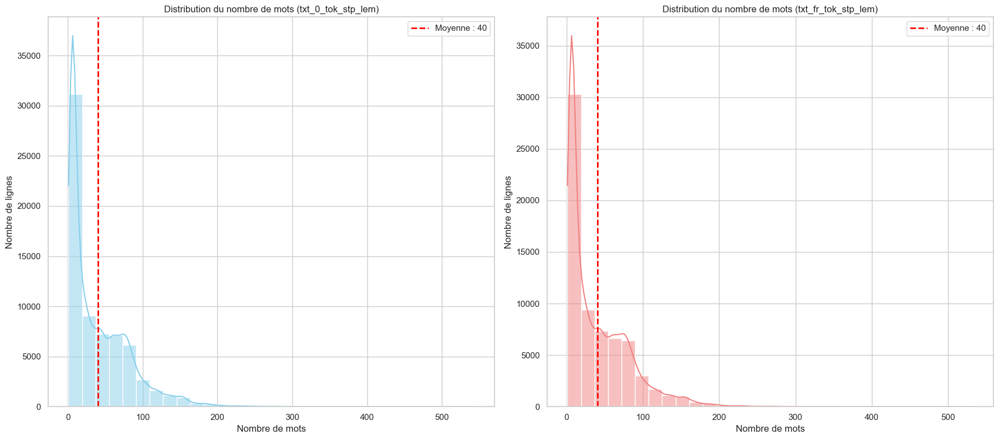

In [138]:
# Création des colonnes de nombre de mots
X_train['nb_mots_txt_0'] = X_train['txt_0_tok_stp_lem'].apply(lambda x: len(str(x).split()))
X_train['nb_mots_txt_fr'] = X_train['txt_fr_tok_stp_lem'].apply(lambda x: len(str(x).split()))

# Affichage des distributions
sns.set(style="whitegrid")
plt.figure(figsize=(18, 8))

# Histogramme pour 'nb_mots_txt_0'
plt.subplot(1, 2, 1)
sns.histplot(X_train['nb_mots_txt_0'], bins=30, kde=True, color='skyblue')
plt.axvline(X_train['nb_mots_txt_0'].mean(), color='red', linestyle='dashed', linewidth=2,
            label=f"Moyenne : {X_train['nb_mots_txt_0'].mean():.0f}")
plt.title("Distribution du nombre de mots (txt_0_tok_stp_lem)")
plt.xlabel("Nombre de mots")
plt.ylabel("Nombre de lignes")
plt.legend()

# Histogramme pour 'nb_mots_txt_fr'
plt.subplot(1, 2, 2)
sns.histplot(X_train['nb_mots_txt_fr'], bins=30, kde=True, color='lightcoral')
plt.axvline(X_train['nb_mots_txt_fr'].mean(), color='red', linestyle='dashed', linewidth=2,
            label=f"Moyenne : {X_train['nb_mots_txt_fr'].mean():.0f}")
plt.title("Distribution du nombre de mots (txt_fr_tok_stp_lem)")
plt.xlabel("Nombre de mots")
plt.ylabel("Nombre de lignes")
plt.legend()

plt.tight_layout()
plt.show()


Distribution asymétrique à droite
La majorité des textes sont courts (< 100 mots).
Une petite portion de textes longs (jusqu'à ~1000 mots) est présente.
La moyenne est de 55 mots

Cela signifie qu’en général, un texte comporte environ 55 mots.
Mais une partie significative des textes est bien plus courte.


Les distributions des deux graphiques sont presque identiques. La traduction ne semble pas modifier significativement la longueur des textes.
Pas d’expansion significative du français (parfois, la traduction française est plus longue que l’anglais, mais ici ce n'est pas le cas).



C:\Users\rudy_\AppData\Local\Temp\ipykernel_28340\3646856121.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train['nb_mots_txt_0'] = X_train['txt_0_tok_stp_lem'].apply(lambda x: len(str(x).split()))
C:\Users\rudy_\AppData\Local\Temp\ipykernel_28340\3646856121.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train['nb_mots_txt_fr'] = X_train['txt_fr_tok_stp_lem'].apply(lambda x: len(str(x).split()))


Analyse de la colonne : nb_mots_txt_0
- Moyenne : 40.06
- Médiane : 24.00
- Écart type : 41.59
- Premier quartile (Q1) : 7.00
- Troisième quartile (Q3) : 64.00
- Écart interquartile (IQR) : 57.00
- Valeurs aberrantes (hors IQR) : 1586 lignes

Analyse de la colonne : nb_mots_txt_fr
- Moyenne : 40.28
- Médiane : 24.00
- Écart type : 41.89
- Premier quartile (Q1) : 7.00
- Troisième quartile (Q3) : 64.00
- Écart interquartile (IQR) : 57.00
- Valeurs aberrantes (hors IQR) : 1700 lignes



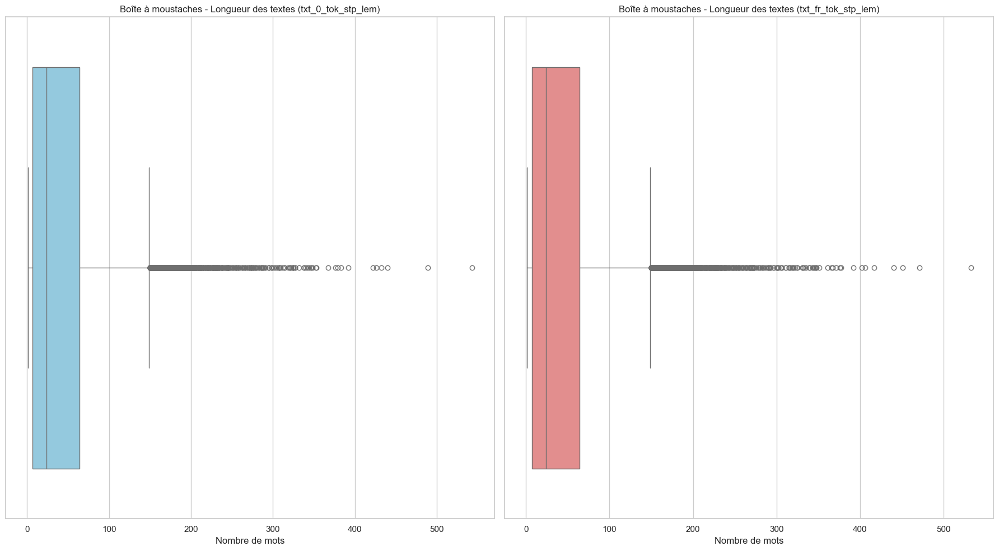

Valeurs aberrantes pour 'nb_mots_txt_0' :
                                     txt_0_tok_stp_lem  nb_mots_txt_0
8    [tente, pliante, v3s5, pro, pvc, blanc, 4m50, ...            150
28   [spot, encastrable, orientable, blanc, gu10, l...            201
49   [largo, poussette, combinee, parasol, siege, a...            160
149  [5d, broderie, peinture, strass, diamant, bric...            155
168  [diy, maison, noel, miniature, assemblez, lead...            155

Valeurs aberrantes pour 'nb_mots_txt_fr' :
                                    txt_fr_tok_stp_lem  nb_mots_txt_fr
28   [spot, encastrable, orientable, blanc, gu10, l...             202
49   [largo, poussett, combine, parasol, sieg, auto...             169
149  [5d, broderie, peinture, stras, diamant, brico...             156
168  [diy, maison, noel, miniature, assembler, led,...             150
180  [lit, enfant, 120x200, cm, tiroir, coloris, bl...             150


In [141]:
# Configuration de l'affichage
sns.set(style="whitegrid")

# Création des colonnes de nombre de mots
X_train['nb_mots_txt_0'] = X_train['txt_0_tok_stp_lem'].apply(lambda x: len(str(x).split()))
X_train['nb_mots_txt_fr'] = X_train['txt_fr_tok_stp_lem'].apply(lambda x: len(str(x).split()))

# Statistiques descriptives pour 'nb_mots_txt_0'
print("Analyse de la colonne : nb_mots_txt_0")
print(f"- Moyenne : {X_train['nb_mots_txt_0'].mean():.2f}")
print(f"- Médiane : {X_train['nb_mots_txt_0'].median():.2f}")
print(f"- Écart type : {X_train['nb_mots_txt_0'].std():.2f}")
print(f"- Premier quartile (Q1) : {X_train['nb_mots_txt_0'].quantile(0.25):.2f}")
print(f"- Troisième quartile (Q3) : {X_train['nb_mots_txt_0'].quantile(0.75):.2f}")
print(f"- Écart interquartile (IQR) : {(X_train['nb_mots_txt_0'].quantile(0.75) - X_train['nb_mots_txt_0'].quantile(0.25)):.2f}")
print(f"- Valeurs aberrantes (hors IQR) : {((X_train['nb_mots_txt_0'] < (X_train['nb_mots_txt_0'].quantile(0.25) - 1.5 * (X_train['nb_mots_txt_0'].quantile(0.75) - X_train['nb_mots_txt_0'].quantile(0.25)))) | (X_train['nb_mots_txt_0'] > (X_train['nb_mots_txt_0'].quantile(0.75) + 1.5 * (X_train['nb_mots_txt_0'].quantile(0.75) - X_train['nb_mots_txt_0'].quantile(0.25))))).sum()} lignes\n")

# Statistiques descriptives pour 'nb_mots_txt_fr'
print("Analyse de la colonne : nb_mots_txt_fr")
print(f"- Moyenne : {X_train['nb_mots_txt_fr'].mean():.2f}")
print(f"- Médiane : {X_train['nb_mots_txt_fr'].median():.2f}")
print(f"- Écart type : {X_train['nb_mots_txt_fr'].std():.2f}")
print(f"- Premier quartile (Q1) : {X_train['nb_mots_txt_fr'].quantile(0.25):.2f}")
print(f"- Troisième quartile (Q3) : {X_train['nb_mots_txt_fr'].quantile(0.75):.2f}")
print(f"- Écart interquartile (IQR) : {(X_train['nb_mots_txt_fr'].quantile(0.75) - X_train['nb_mots_txt_fr'].quantile(0.25)):.2f}")
print(f"- Valeurs aberrantes (hors IQR) : {((X_train['nb_mots_txt_fr'] < (X_train['nb_mots_txt_fr'].quantile(0.25) - 1.5 * (X_train['nb_mots_txt_fr'].quantile(0.75) - X_train['nb_mots_txt_fr'].quantile(0.25)))) | (X_train['nb_mots_txt_fr'] > (X_train['nb_mots_txt_fr'].quantile(0.75) + 1.5 * (X_train['nb_mots_txt_fr'].quantile(0.75) - X_train['nb_mots_txt_fr'].quantile(0.25))))).sum()} lignes\n")

# Visualisation par boîte à moustaches et histogrammes
plt.figure(figsize=(18, 10))

# Boxplot pour 'nb_mots_txt_0'
plt.subplot(1, 2, 1)
sns.boxplot(x=X_train['nb_mots_txt_0'], color='skyblue')
plt.title("Boîte à moustaches - Longueur des textes (txt_0_tok_stp_lem)")
plt.xlabel("Nombre de mots")

# Boxplot pour 'nb_mots_txt_fr'
plt.subplot(1, 2, 2)
sns.boxplot(x=X_train['nb_mots_txt_fr'], color='lightcoral')
plt.title("Boîte à moustaches - Longueur des textes (txt_fr_tok_stp_lem)")
plt.xlabel("Nombre de mots")

plt.tight_layout()
plt.show()

# Identification de quelques valeurs aberrantes
Q1_0 = X_train['nb_mots_txt_0'].quantile(0.25)
Q3_0 = X_train['nb_mots_txt_0'].quantile(0.75)
IQR_0 = Q3_0 - Q1_0
outliers_0 = X_train[(X_train['nb_mots_txt_0'] < Q1_0 - 1.5 * IQR_0) | (X_train['nb_mots_txt_0'] > Q3_0 + 1.5 * IQR_0)]
print("Valeurs aberrantes pour 'nb_mots_txt_0' :")
print(outliers_0[['txt_0_tok_stp_lem', 'nb_mots_txt_0']].head())

Q1_fr = X_train['nb_mots_txt_fr'].quantile(0.25)
Q3_fr = X_train['nb_mots_txt_fr'].quantile(0.75)
IQR_fr = Q3_fr - Q1_fr
outliers_fr = X_train[(X_train['nb_mots_txt_fr'] < Q1_fr - 1.5 * IQR_fr) | (X_train['nb_mots_txt_fr'] > Q3_fr + 1.5 * IQR_fr)]
print("\nValeurs aberrantes pour 'nb_mots_txt_fr' :")
print(outliers_fr[['txt_fr_tok_stp_lem', 'nb_mots_txt_fr']].head())


Graphiques en haut : Boîtes à moustaches (Boxplots) Médiane faible : La majorité des textes contiennent peu de mots (probablement entre 10 et 50 mots). Présence d’outliers : Il y a des textes exceptionnellement longs qui atteignent plus de 200 voire 800 mots. Distribution similaire entre l’anglais et le français, indiquant que la traduction n’a pas fortement modifié la longueur des textes.

Graphiques en bas : Histogrammes des longueurs des textes (en nombre de mots) Forte asymétrie à droite → La plupart des textes ont peu de mots (moins de 50 mots). Quelques textes très longs (jusqu'à 800 mots), ce qui confirme la présence d’outliers. Peu de différences entre l’anglais et le français, donc la traduction n’a pas significativement modifié la longueur des textes.

A faire : Vectorisation : Fixez un max_features autour de 5000 et une longueur maximale de tokens en conséquence.